# Accidental Emphasis on Stopwords or Irrelevant Terms

In [18]:
import matplotlib.pyplot as plt
import numpy as np
import nilearn as nl
from nilearn.plotting import plot_stat_map, plot_glass_brain
import nibabel as nib
import neuroquery as nq
from nilearn import datasets, image, input_data
from scipy.stats import pearsonr
import pandas as pd
import warnings

from lxml import etree
from dataclasses import dataclass
from pathlib import Path
import maml._constants as constants
from IPython.display import display, HTML
from typing import List, Optional, Tuple, Union

warnings.filterwarnings("ignore")

## Load the Neuroquery Model

In [19]:
model = nq.NeuroQueryModel.from_data_dir(constants.NEUROQUERY_MODEL_DIR)
model

## Stopwords: "Not with" vs "Without"

Neuroquery uses NLTK, a popular and opensource community package for working with language. NLTK provides a list of "Stop Words" which are words that typically do not provide important information in a sentence such as "The", "As", or "At"

Using NLTK's stopwords, terms like "not" and "with" are removed, but "without" is kept. 

In [20]:
stop_words = nq.tokenization.nltk_stop_words()

In [21]:
for w in ['with', 'not', 'without']:
    print(w, 'in stop_words:', w in stop_words)

with in stop_words: True
not in stop_words: True
without in stop_words: False


#### Why is this a problem?
Without is a pretty ambiguous term, if we asked a neuroscientist what part of the brain would relate to the term "without" we wouldn't expect a very precise answer because it's ambiguous on its own.

However neuroquery does not find it ambiguous


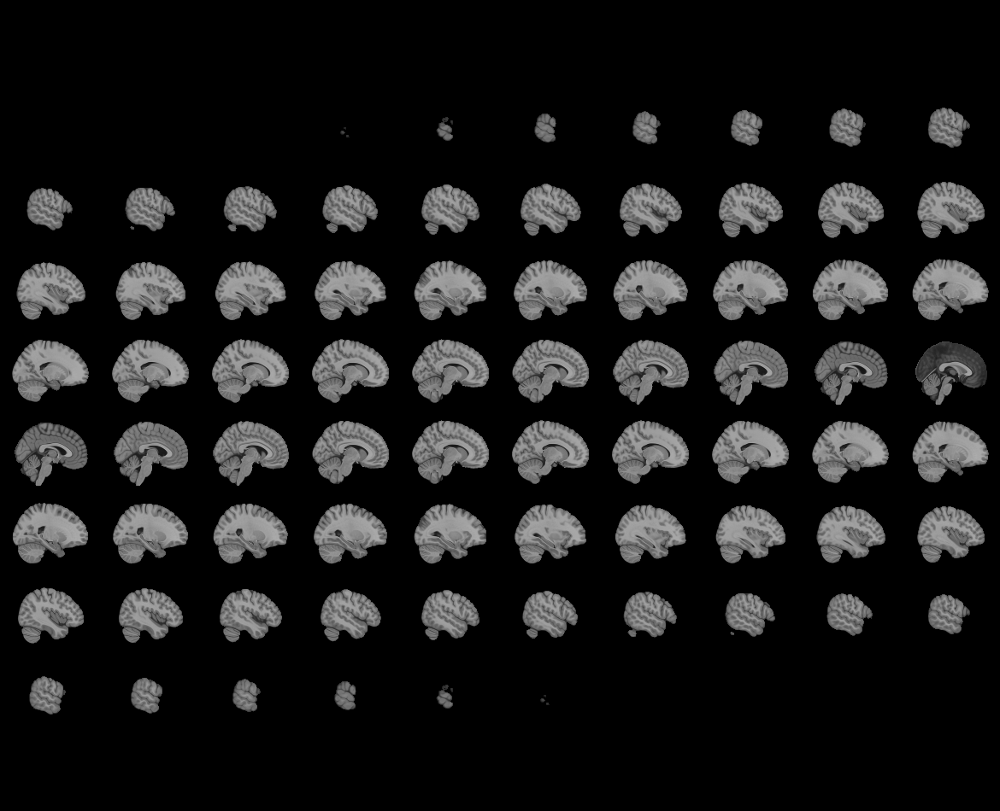
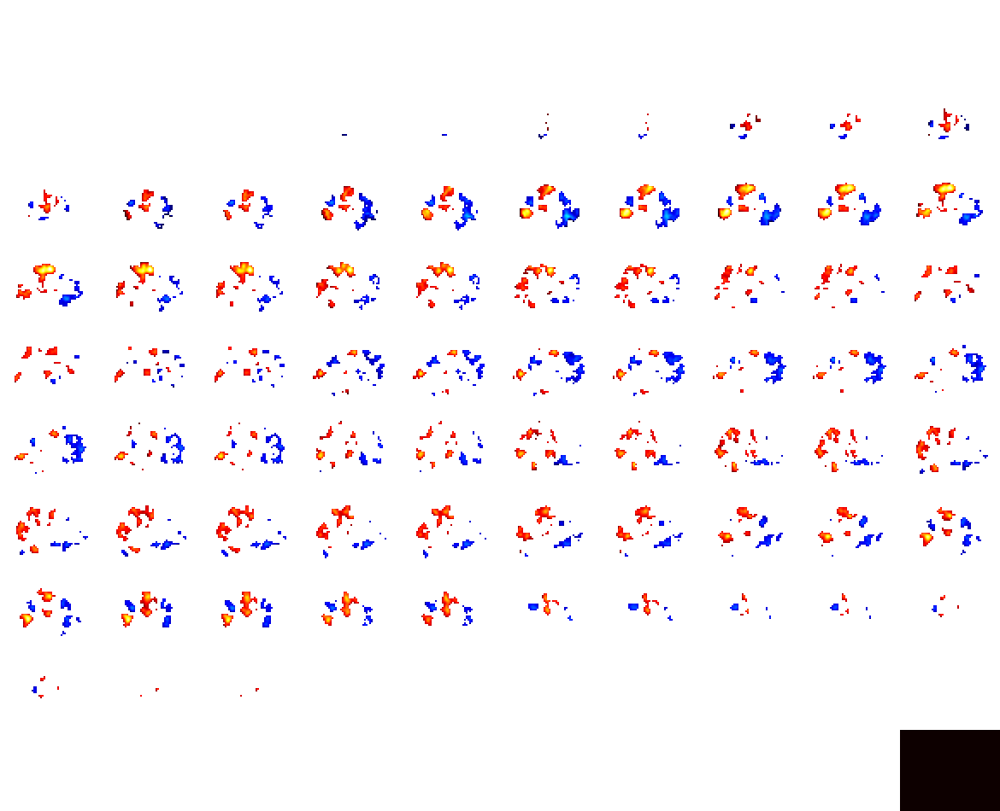

In [22]:
result = model("without")
nl.plotting.view_img(result['brain_map'], threshold=3)

Why?
It seems like even thought neuroquery knows different terms such as "visual" are not closely related to the term "without", their activation maps are so strong that they play a major role in the resulting query. 
- this is mentioned as a potential risk in the neuroquery paper

We can see the related documents covery a wide breadth of topics, all containing the term "without"

In [23]:
result['similar_words']

,similarity,weight_in_brain_map,weight_in_query,n_documents
visual,0.012537,6.205956,0.0,10448
auditory,0.005372,3.226963,0.0,4009
motor,0.006088,3.050214,0.0,7928
parietal,0.003717,2.478164,0.0,10159
somatosensory,0.005777,2.049376,0.0,2370
...,...,...,...,...
focal,0.000813,0.000000,0.0,1406
fluid intelligence,0.000129,0.000000,0.0,120
fluid,0.000358,0.000000,0.0,2359
fluent,0.000164,0.000000,0.0,524


In [24]:
for title in result['similar_documents'].head(10)['title']:
    print(' -', title)

 - A Whole-Brain Voxel Based Measure of Intrinsic Connectivity Contrast Reveals Local Changes in Tissue Connectivity with Anesthetic without A Priori Assumptions on Thresholds or Regions of Interest
 - Assessment of gray and white matter structural alterations in migraineurs without aura
 - Neural bases of behavior selection without an objective correct answer
 - Acute Effects of Different Multivitamin Mineral Preparations with and without Guaraná on Mood, Cognitive Performance and Functional Brain Activation
 - Spatial registration of multichannel multi-subject fNIRS data to MNI space without MRI
 - Neural Evidence of Statistical Learning: Efficient Detection of Visual Regularities Without Awareness
 - Equivalent neural responses in children and adolescents with and without Autism during judgments of affect
 - The Cerebral Response During Subjective Choice With and Without Self-Reference
 - Distinct inter-hemispheric dysconnectivity in schizophrenia patients with and without auditory 

## Queries & Cuts

In [25]:
@dataclass
class Query:
    text: str
    default_cut: Tuple[int,int,int] = None

queries = [
    Query("Consciousness", (-4, -58, 24)),
    Query("Concentration", (-22, -22, -14)),
    Query("Language Comprehension", (-50, 20, 10)),
    Query("Self-recognition", (-38, -62, -16)),
    Query("Writing-comprehension", (-58, -38, -2)),
    Query("Emotion", (22, -4, -18)),
    Query("Self-awareness", (36, 2, 2)),
    Query("Verbal comprehension", (-58, -32, -2)),
    Query("Facial recognition", (36, -60, -20)),
    Query("Visual perception", (-2, -82, 0)),
    Query("Semantic processing", (-48, 10, 12)),
    Query("Memory acquisition", (0, -22, 0)),
    Query("Complex thought", (-56, -26, 4)),
    Query("Procedural memory", (10, 56, -34)),
    Query("Sensory memory", (-2, -82, 0)),
    Query("Short-term memory", (32, -56, 42)),
    Query("Theory of mind", (-4, -62, 44))
]


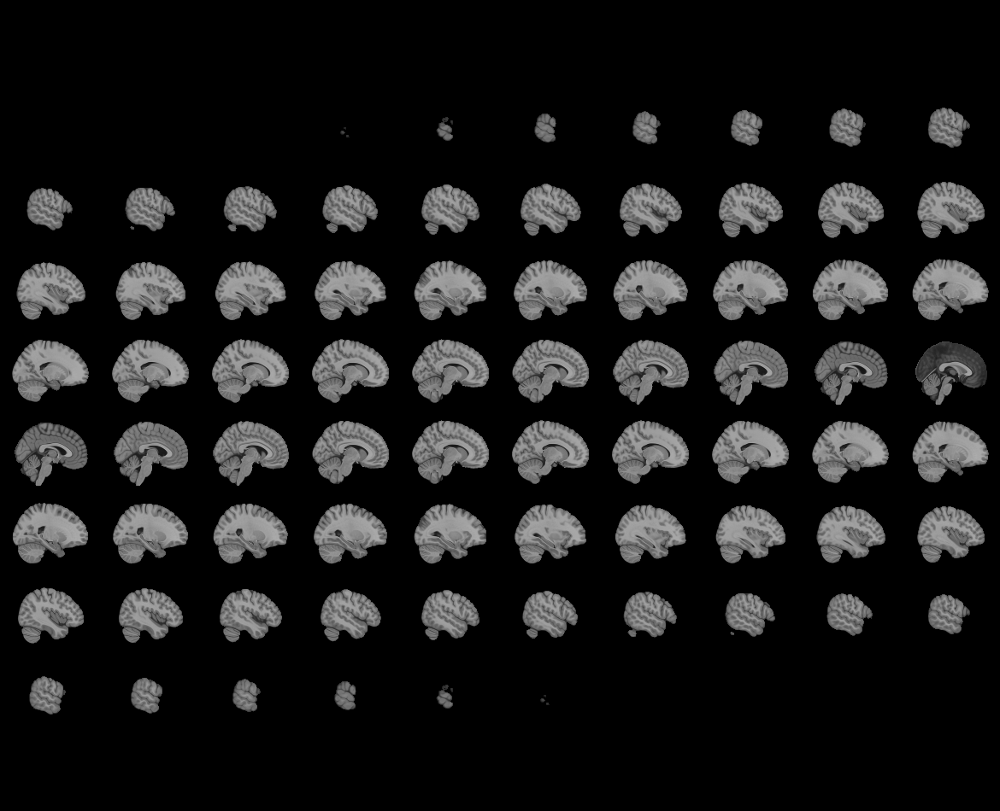
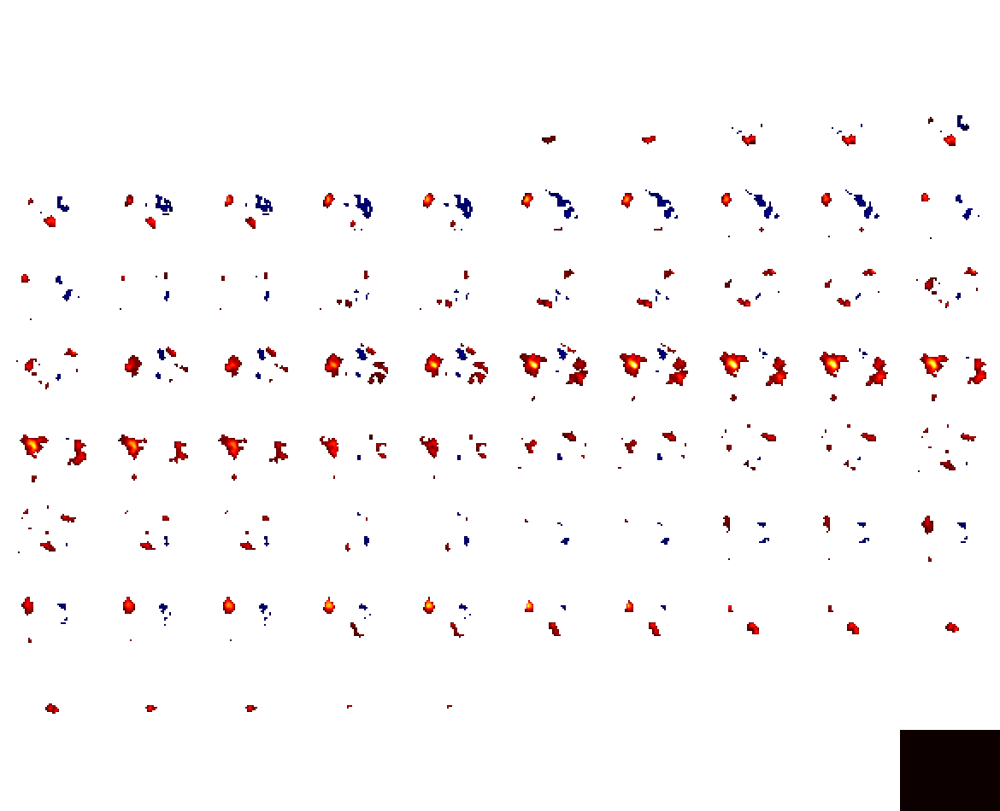

Neuroquery extracted terms
 - conscious
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.819496,0.000000,0.816888,443
conscious,0.563671,0.000000,0.576796,1940
asd,0.073691,0.000000,0.000000,317
perception,0.047277,0.000000,0.000000,5464
autism,0.027375,0.000000,0.000000,991
spectrum,0.019931,0.000000,0.000000,1806
neural,0.018318,0.000000,0.000000,11610
disorder,0.011989,0.000000,0.000000,8378
dmn,0.011188,3.556166,0.000000,1351
activity,0.010542,0.000000,0.000000,11733


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.502843
1,28753443,Activity in part of the neural correlates of c...,https://www.ncbi.nlm.nih.gov/pubmed/28753443,0.445185
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.429291
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.427867
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.402811
5,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.396060
6,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.394888
7,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.394803
8,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.391833
9,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.382656



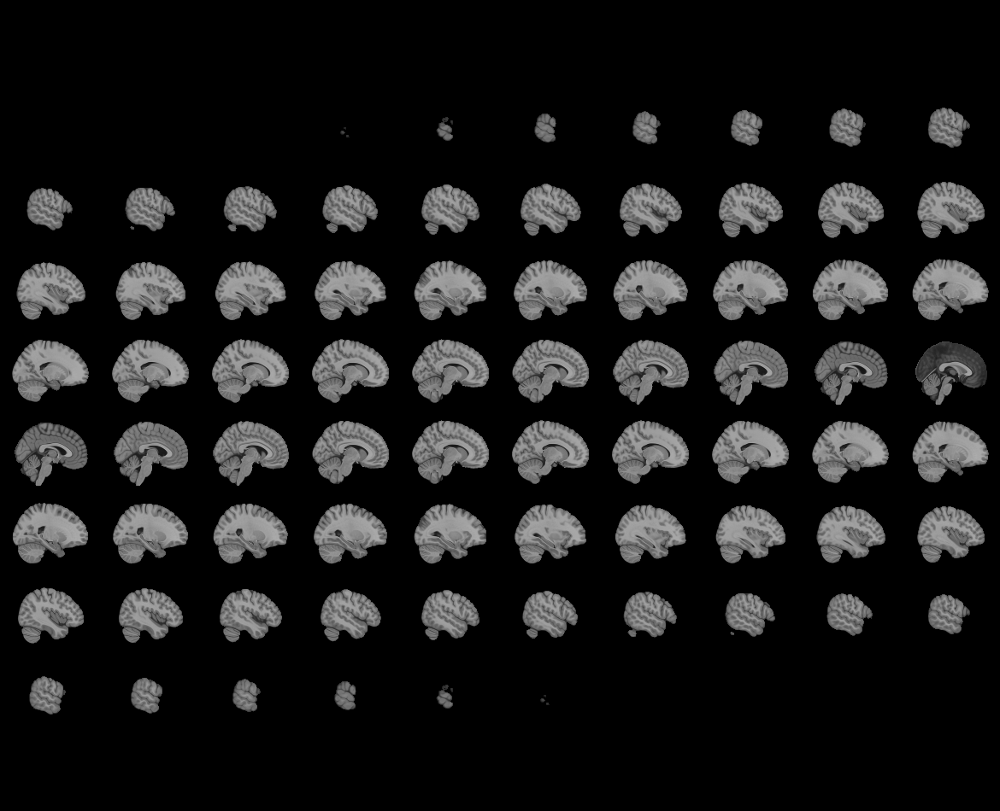
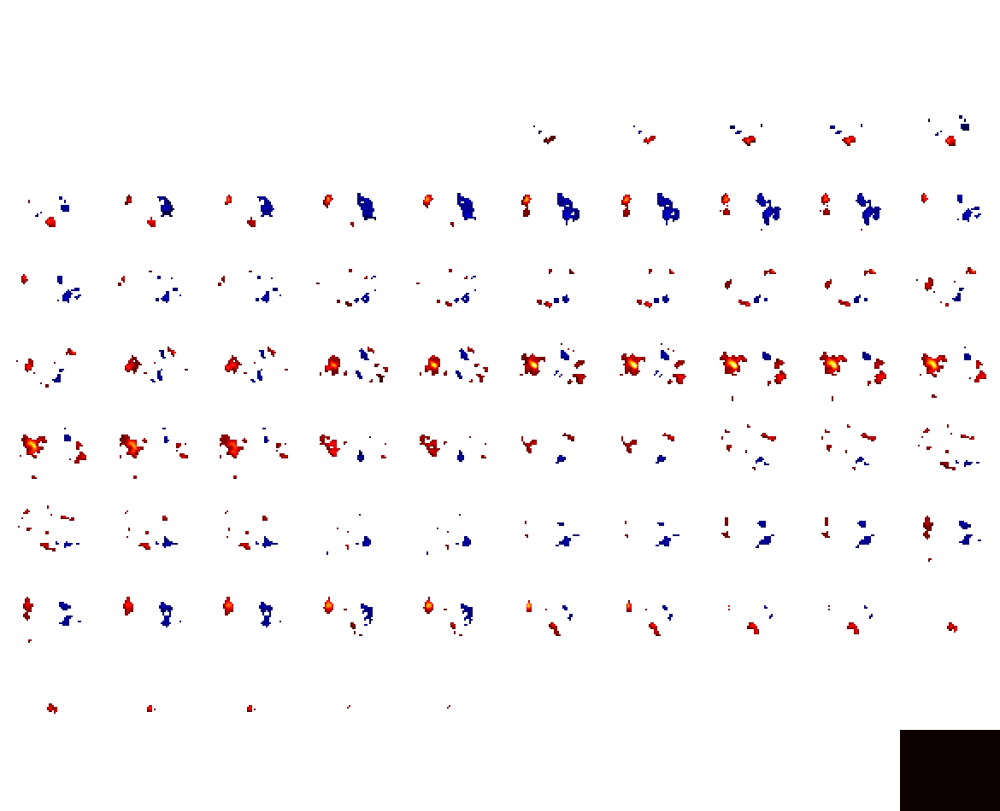

Neuroquery extracted terms
 - conscious
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.796683,0.0,0.793431,443
conscious,0.547573,0.0,0.560234,1940
without,0.231282,0.0,0.237919,9055
asd,0.073670,0.0,0.000000,317
perception,0.046103,0.0,0.000000,5464
autism,0.027261,0.0,0.000000,991
spectrum,0.020017,0.0,0.000000,1806
neural,0.019603,0.0,0.000000,11610
disorder,0.014602,0.0,0.000000,8378
activity,0.010965,0.0,0.000000,11733


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.493484
1,28753443,Activity in part of the neural correlates of c...,https://www.ncbi.nlm.nih.gov/pubmed/28753443,0.435646
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.422007
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.419821
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.397379
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.392085
6,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.391836
7,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.390694
8,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.386976
9,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.377487



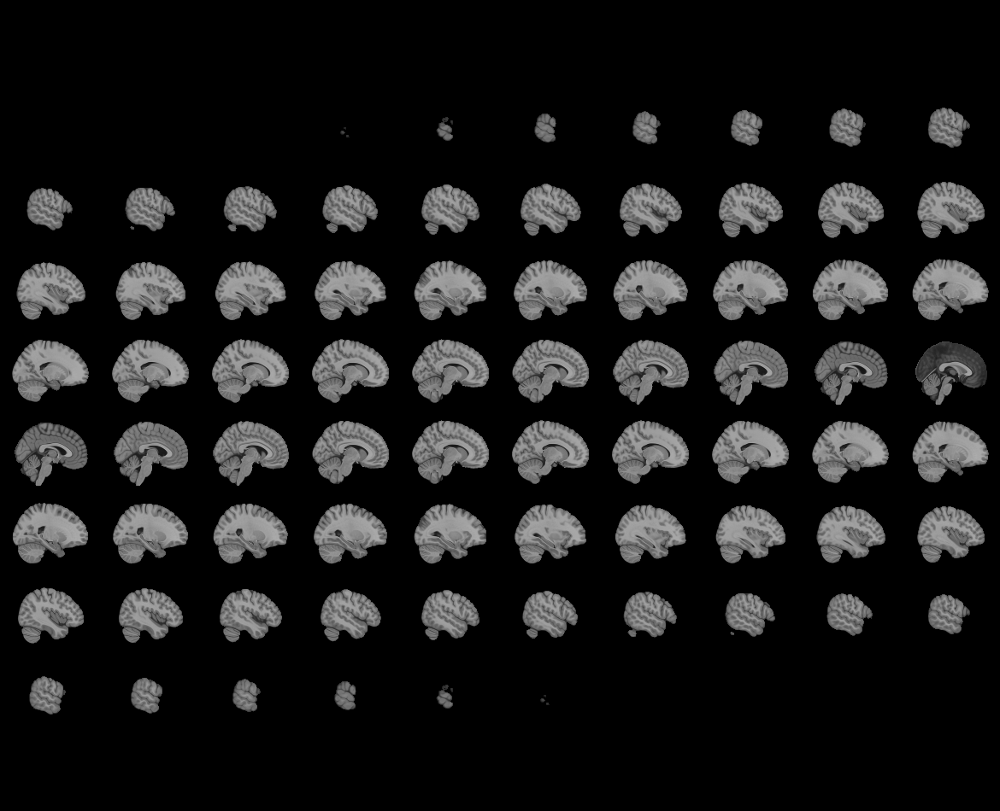
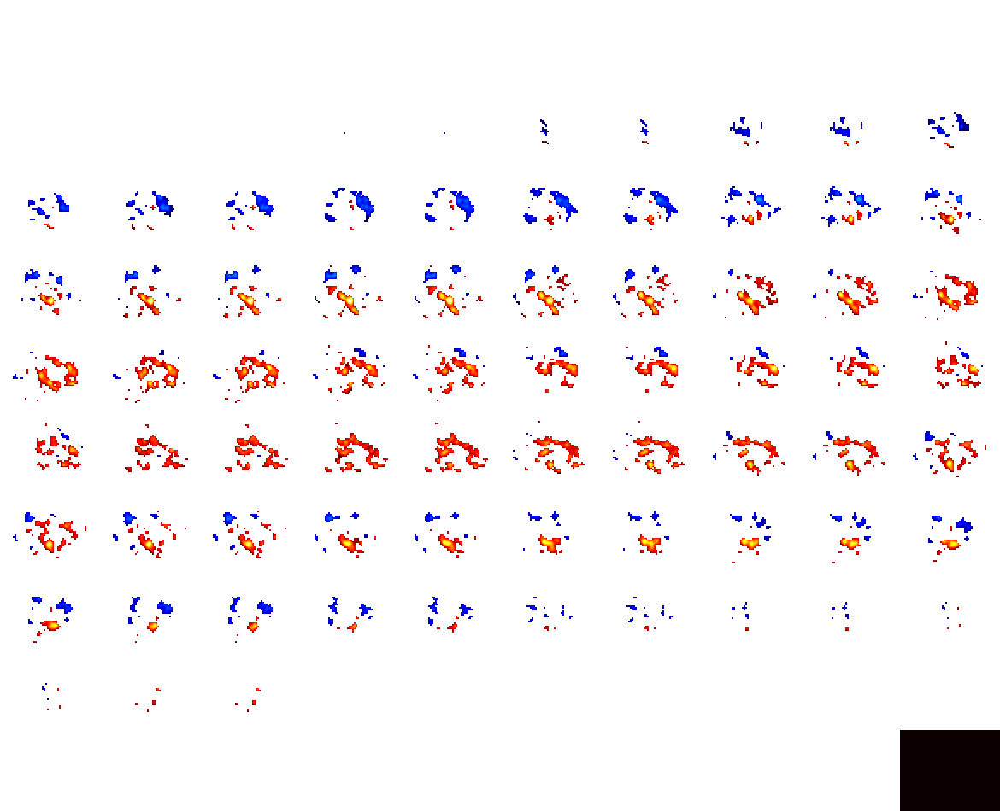

Neuroquery extracted terms
 - concentration
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.932510,0.000000,0.933368,443
concentration,0.346460,0.000000,0.358922,1505
asd,0.083850,0.000000,0.000000,317
autism,0.031145,0.000000,0.000000,991
spectrum,0.022648,0.000000,0.000000,1806
brain,0.017583,0.000000,0.000000,13395
disorder,0.014061,0.000000,0.000000,8378
matter,0.011158,2.551184,0.000000,6324
gray matter,0.010708,0.121327,0.000000,3200
gray,0.009669,0.000000,0.000000,4508


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.573982
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.487215
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.486227
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.463508
4,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.451844
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.451601
6,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.449061
7,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.445520
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.441510
9,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.438687



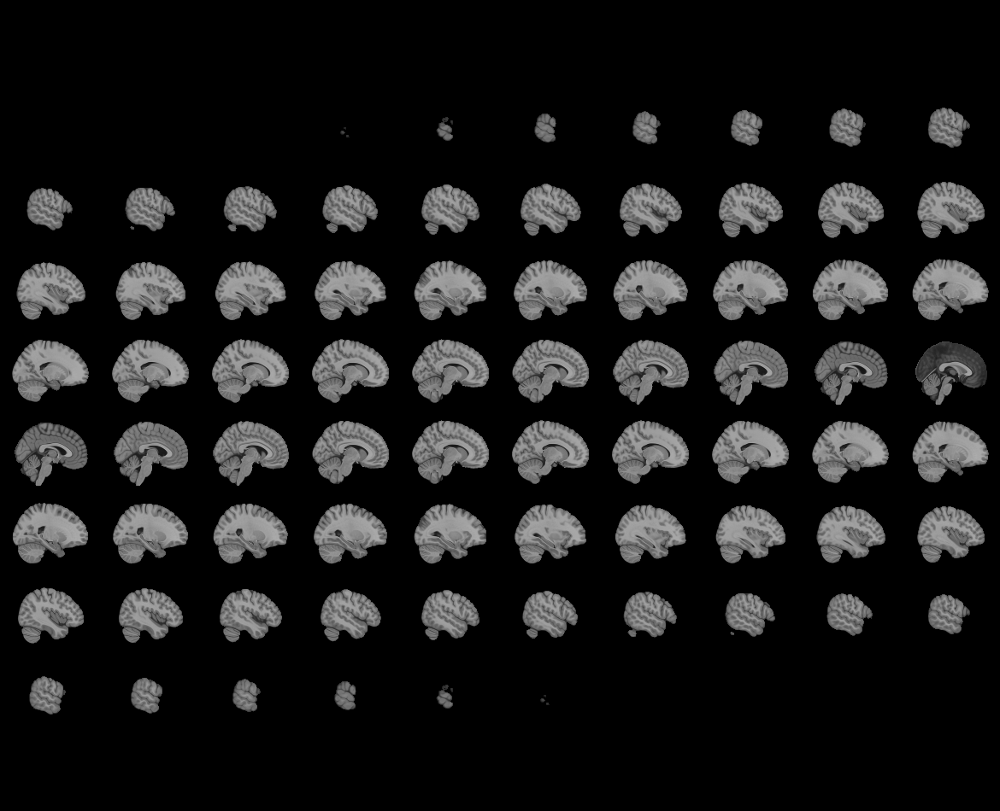
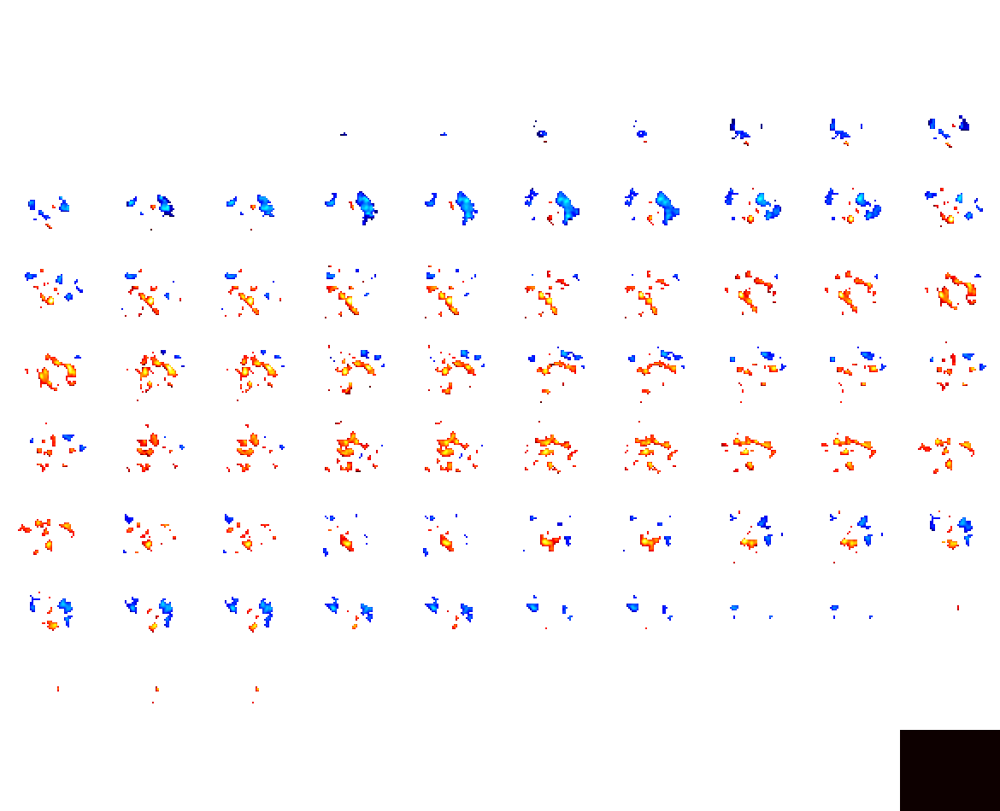

Neuroquery extracted terms
 - concentration
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.899093,0.000000,0.898827,443
concentration,0.333835,0.000000,0.345639,1505
without,0.261038,0.000000,0.269523,9055
asd,0.083137,0.000000,0.000000,317
autism,0.030760,0.000000,0.000000,991
brain,0.024504,0.000000,0.000000,13395
spectrum,0.022560,0.000000,0.000000,1806
disorder,0.016882,0.000000,0.000000,8378
matter,0.012630,2.887892,0.000000,6324
gray matter,0.011600,0.131430,0.000000,3200


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.558647
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.475024
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.473165
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.453417
4,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.444751
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.444611
6,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.439795
7,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.435948
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.431870
9,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.430795



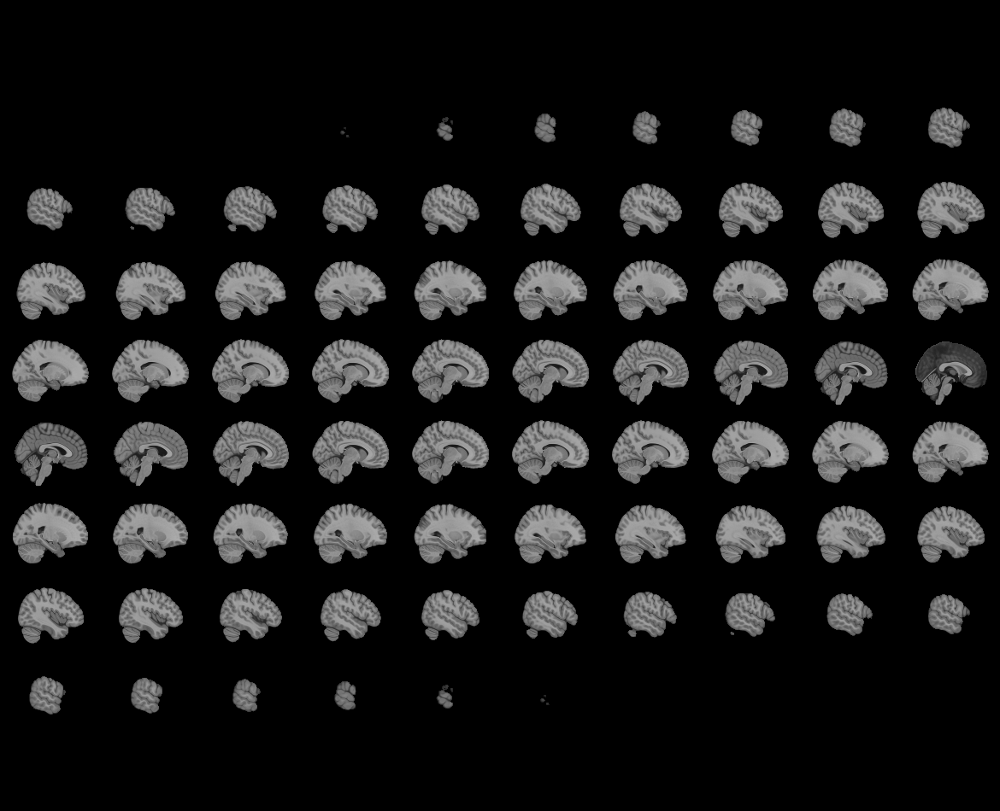
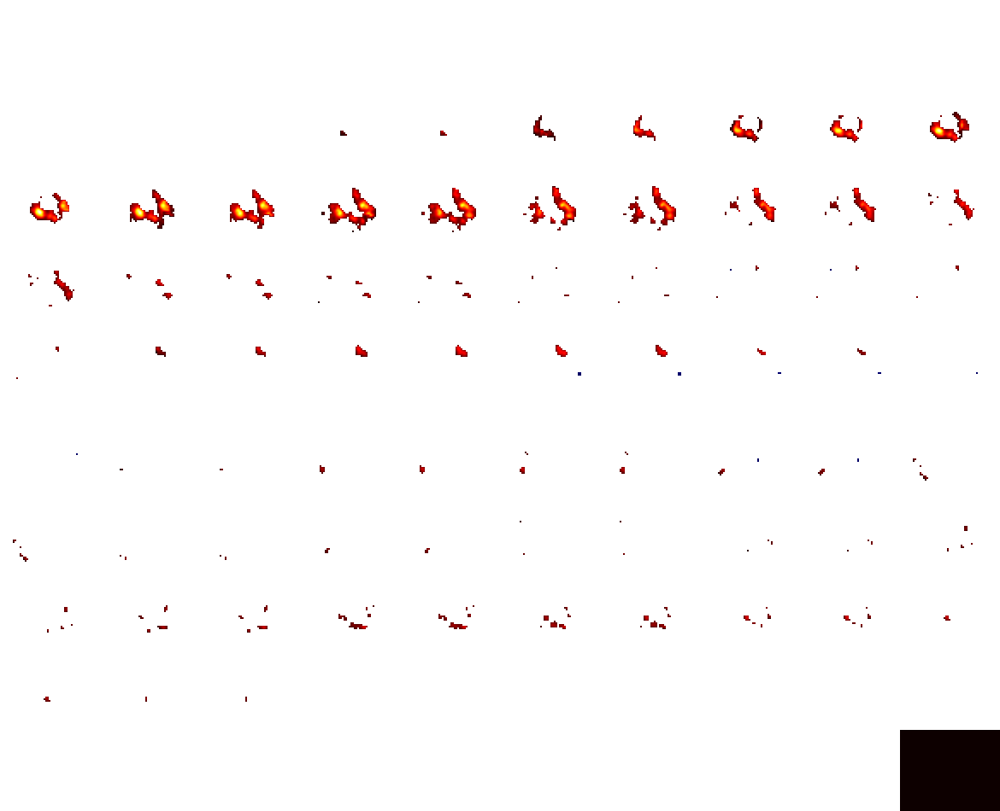

Neuroquery extracted terms
 - language comprehension
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
language comprehension,0.739426,0.000000,0.753711,500
autism spectrum disorder,0.664594,0.000000,0.657206,443
asd,0.062670,0.000000,0.000000,317
language,0.051719,3.764564,0.000000,4019
sentence,0.048616,4.103425,0.000000,1605
comprehension,0.032092,0.000000,0.000000,1648
autism,0.023340,0.000000,0.000000,991
spectrum,0.016889,0.000000,0.000000,1806
disorder,0.009996,0.000000,0.000000,8378
sentence comprehension,0.009492,0.000000,0.000000,339


,pmid,title,pubmed_url,similarity
0,21241718,Neural correlates of language comprehension in...,https://www.ncbi.nlm.nih.gov/pubmed/21241718,0.489793
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.408935
2,24917803,Hand specific representations in language comp...,https://www.ncbi.nlm.nih.gov/pubmed/24917803,0.399551
3,21232614,Interpretation-mediated changes in neural acti...,https://www.ncbi.nlm.nih.gov/pubmed/21232614,0.388164
4,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.349166
5,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.347785
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.328544
7,15862222,Who did what to whom? The neural basis of argu...,https://www.ncbi.nlm.nih.gov/pubmed/15862222,0.326605
8,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.323126
9,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.322274



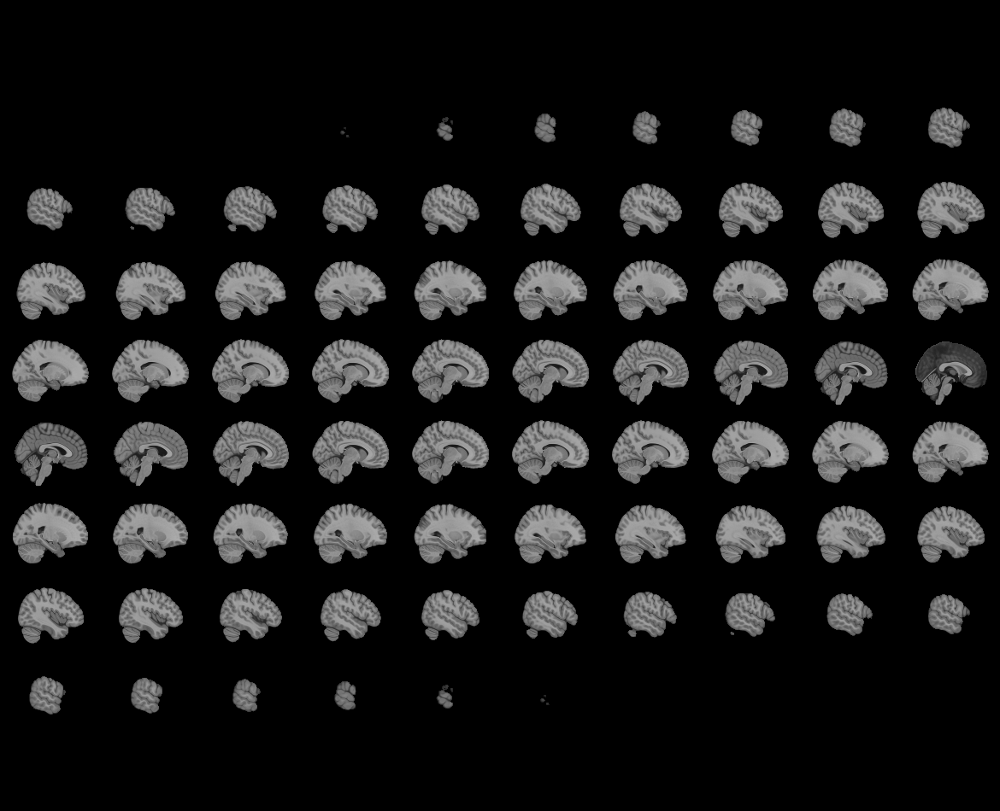
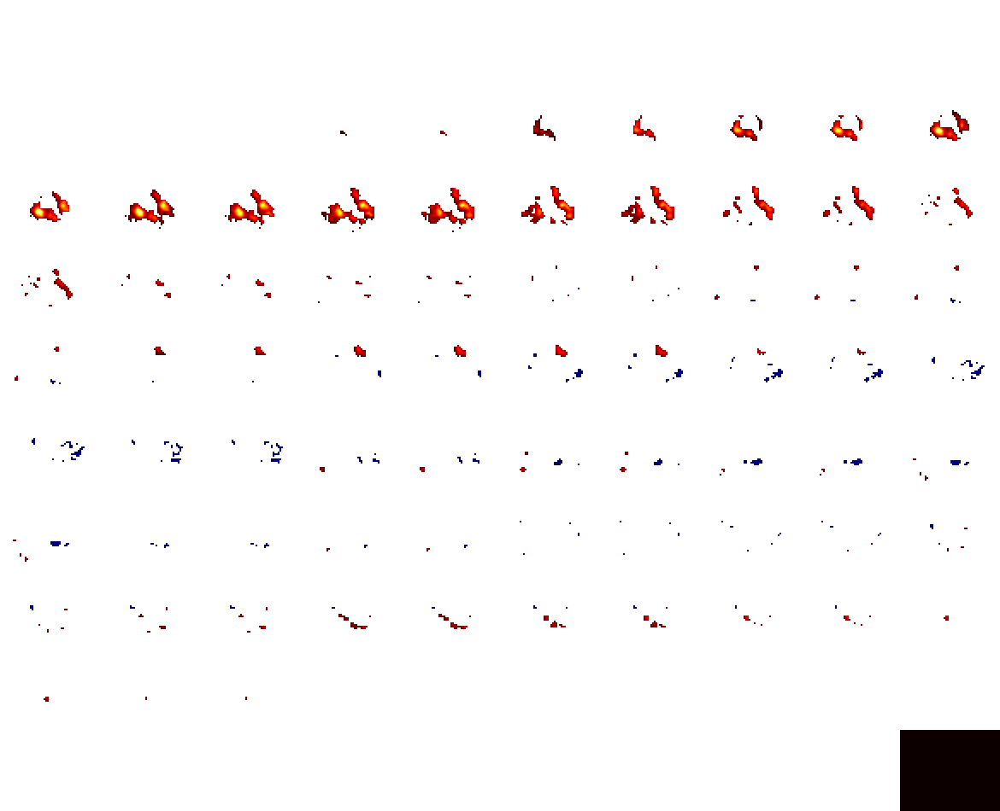

Neuroquery extracted terms
 - language comprehension
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
language comprehension,0.725375,0.000000,0.739488,500
autism spectrum disorder,0.652640,0.000000,0.644804,443
without,0.188978,0.000000,0.193352,9055
asd,0.063199,0.000000,0.000000,317
language,0.050826,3.699544,0.000000,4019
sentence,0.048011,4.052366,0.000000,1605
comprehension,0.031665,0.000000,0.000000,1648
autism,0.023449,0.000000,0.000000,991
spectrum,0.017108,0.000000,0.000000,1806
disorder,0.012225,0.000000,0.000000,8378


,pmid,title,pubmed_url,similarity
0,21241718,Neural correlates of language comprehension in...,https://www.ncbi.nlm.nih.gov/pubmed/21241718,0.483034
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.405372
2,24917803,Hand specific representations in language comp...,https://www.ncbi.nlm.nih.gov/pubmed/24917803,0.394303
3,21232614,Interpretation-mediated changes in neural acti...,https://www.ncbi.nlm.nih.gov/pubmed/21232614,0.384745
4,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.346700
5,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.344689
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.327360
7,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.323804
8,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.323239
9,15862222,Who did what to whom? The neural basis of argu...,https://www.ncbi.nlm.nih.gov/pubmed/15862222,0.322485



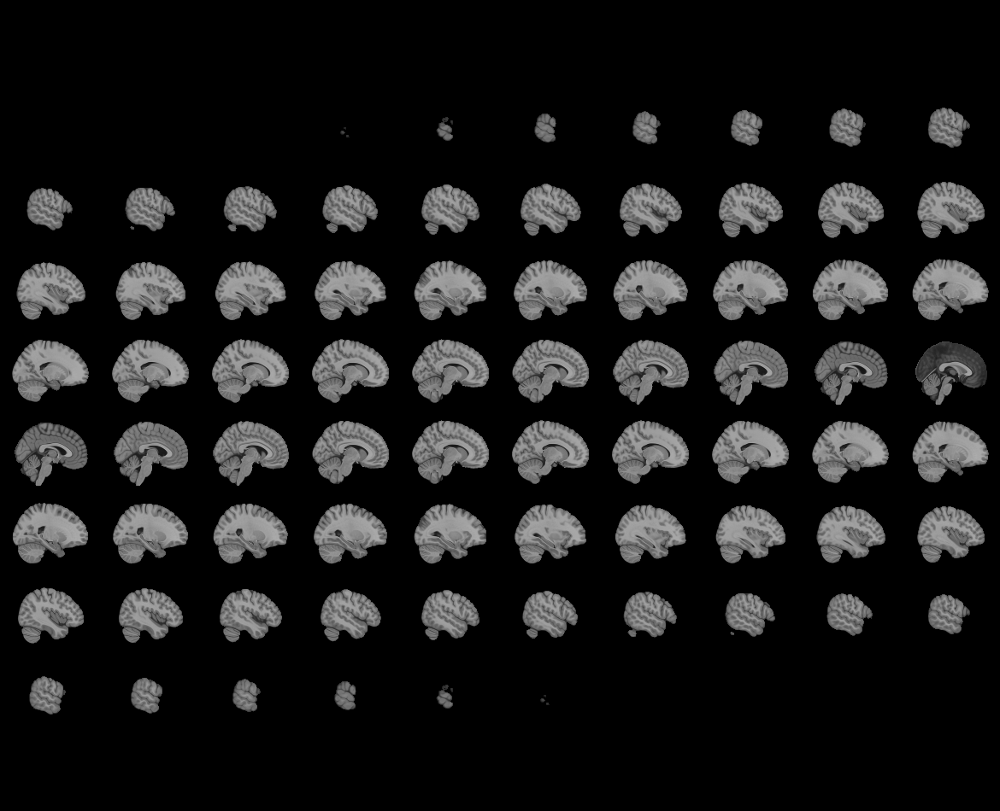
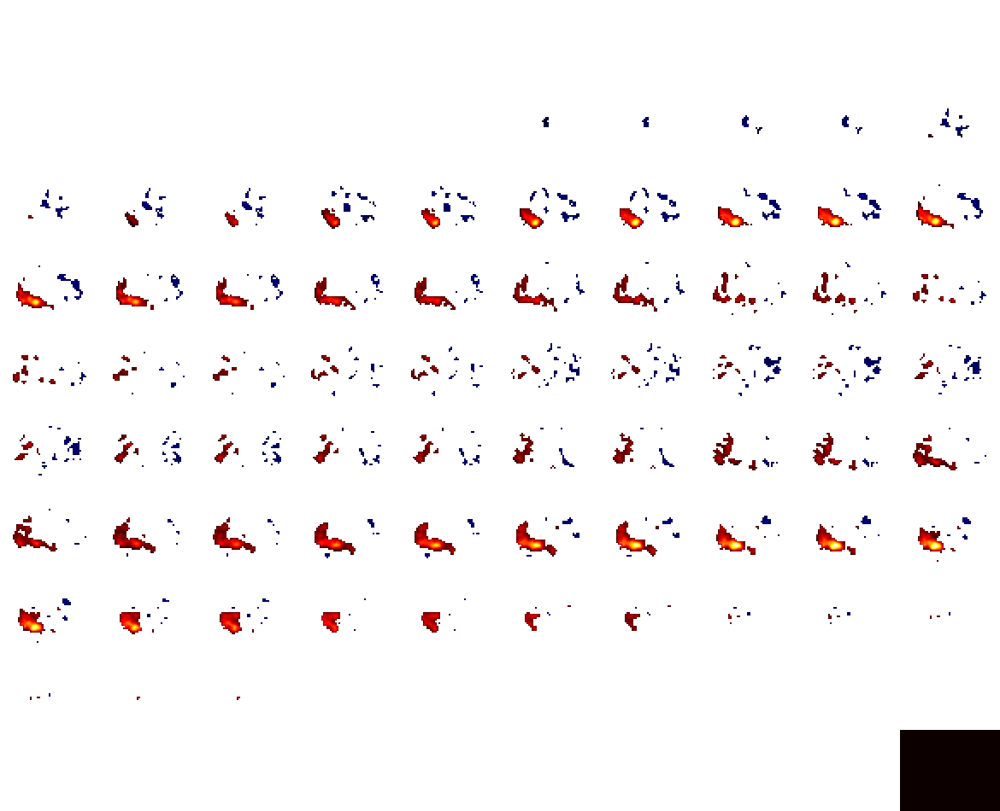

Neuroquery extracted terms
 - self
 - recognition
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.772183,0.0,0.793798,443
recognition,0.481598,0.0,0.465179,4205
self,0.406526,0.0,0.391783,6383
asd,0.069458,0.0,0.000000,317
autism,0.025794,0.0,0.000000,991
spectrum,0.018712,0.0,0.000000,1806
disorder,0.011182,0.0,0.000000,8378
recognition memory,0.010718,0.0,0.000000,608
referential,0.007380,0.0,0.000000,1224
self referential,0.007089,0.0,0.000000,1139


,pmid,title,pubmed_url,similarity
0,15588605,Cortical mechanisms of visual self-recognition,https://www.ncbi.nlm.nih.gov/pubmed/15588605,0.485695
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.472099
2,17306235,Here I am: The cortical correlates of visual s...,https://www.ncbi.nlm.nih.gov/pubmed/17306235,0.440142
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.401654
4,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.401618
5,18501639,Face-specific and domain-general characteristi...,https://www.ncbi.nlm.nih.gov/pubmed/18501639,0.385563
6,19015113,The self across the senses: an fMRI study of s...,https://www.ncbi.nlm.nih.gov/pubmed/19015113,0.382996
7,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.378294
8,22940117,The different faces of one’s self: an fMRI stu...,https://www.ncbi.nlm.nih.gov/pubmed/22940117,0.371838
9,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.371530



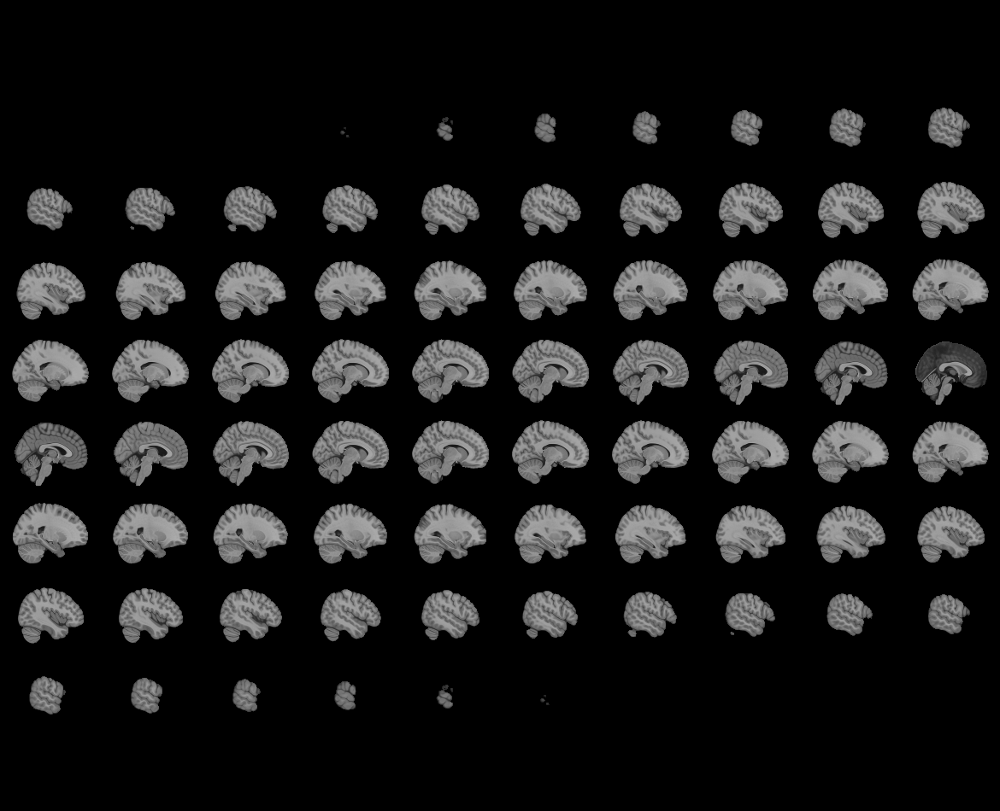
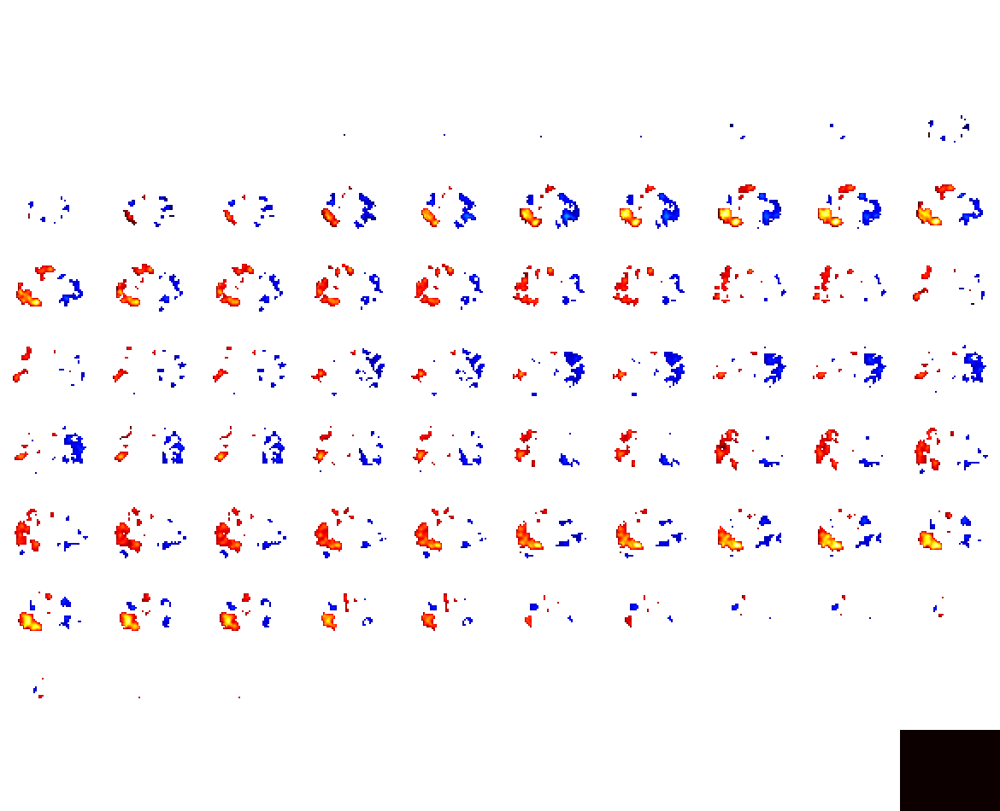

Neuroquery extracted terms
 - self
 - recognition
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.753009,0.0,0.772223,443
recognition,0.469220,0.0,0.452536,4205
self,0.397049,0.0,0.381134,6383
without,0.218443,0.0,0.231559,9055
asd,0.069652,0.0,0.000000,317
autism,0.025766,0.0,0.000000,991
spectrum,0.018853,0.0,0.000000,1806
disorder,0.013690,0.0,0.000000,8378
recognition memory,0.010451,0.0,0.000000,608
patient,0.009480,0.0,0.000000,7859


,pmid,title,pubmed_url,similarity
0,15588605,Cortical mechanisms of visual self-recognition,https://www.ncbi.nlm.nih.gov/pubmed/15588605,0.477608
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.464763
2,17306235,Here I am: The cortical correlates of visual s...,https://www.ncbi.nlm.nih.gov/pubmed/17306235,0.432166
3,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.396060
4,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.395335
5,18501639,Face-specific and domain-general characteristi...,https://www.ncbi.nlm.nih.gov/pubmed/18501639,0.379402
6,19015113,The self across the senses: an fMRI study of s...,https://www.ncbi.nlm.nih.gov/pubmed/19015113,0.376094
7,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.374367
8,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.370124
9,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.369594



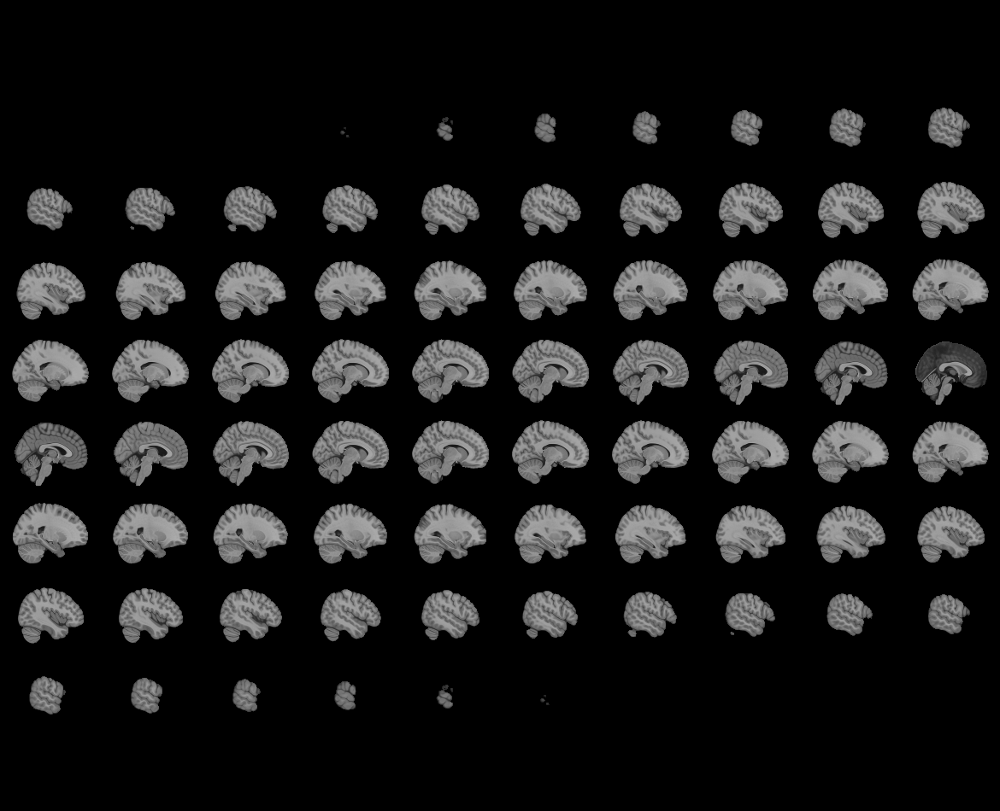
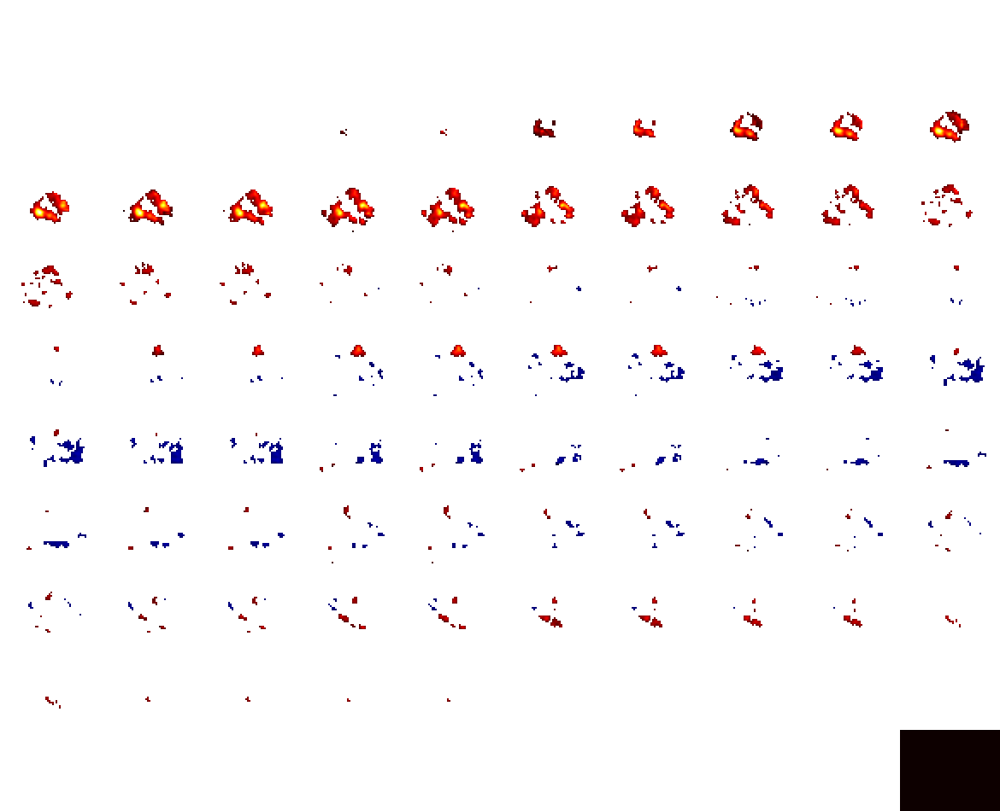

Neuroquery extracted terms
 - writing
 - comprehension
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.634569,0.000000,0.637697,443
comprehension,0.555576,0.000000,0.548036,1648
writing,0.527627,0.000000,0.541294,955
asd,0.057869,0.000000,0.000000,317
sentence,0.045906,3.874693,0.000000,1605
chinese,0.035121,0.000000,0.000000,975
letter,0.031429,0.000000,0.000000,2538
autism,0.021632,0.000000,0.000000,991
orthographic,0.017242,0.000000,0.000000,603
spectrum,0.015624,0.000000,0.000000,1806


,pmid,title,pubmed_url,similarity
0,23844132,Functional Anatomy of Writing with the Dominan...,https://www.ncbi.nlm.nih.gov/pubmed/23844132,0.428260
1,21930136,SOME IS NOT ENOUGH: QUANTIFIER COMPREHENSION I...,https://www.ncbi.nlm.nih.gov/pubmed/21930136,0.403436
2,26474740,The neural basis of humour comprehension and h...,https://www.ncbi.nlm.nih.gov/pubmed/26474740,0.398506
3,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.390316
4,16872841,Interindividual uniformity and variety of the ...,https://www.ncbi.nlm.nih.gov/pubmed/16872841,0.390062
5,17141528,Evidence for bilateral involvement in idiom co...,https://www.ncbi.nlm.nih.gov/pubmed/17141528,0.381765
6,25955655,Cerebral Activations Related to Writing and Dr...,https://www.ncbi.nlm.nih.gov/pubmed/25955655,0.374685
7,28242518,“Decoding versus comprehension”: Brain respons...,https://www.ncbi.nlm.nih.gov/pubmed/28242518,0.362219
8,27992505,Neural Signatures of the Reading-Writing Conne...,https://www.ncbi.nlm.nih.gov/pubmed/27992505,0.354871
9,22836181,Design choices in imaging speech comprehension...,https://www.ncbi.nlm.nih.gov/pubmed/22836181,0.354641



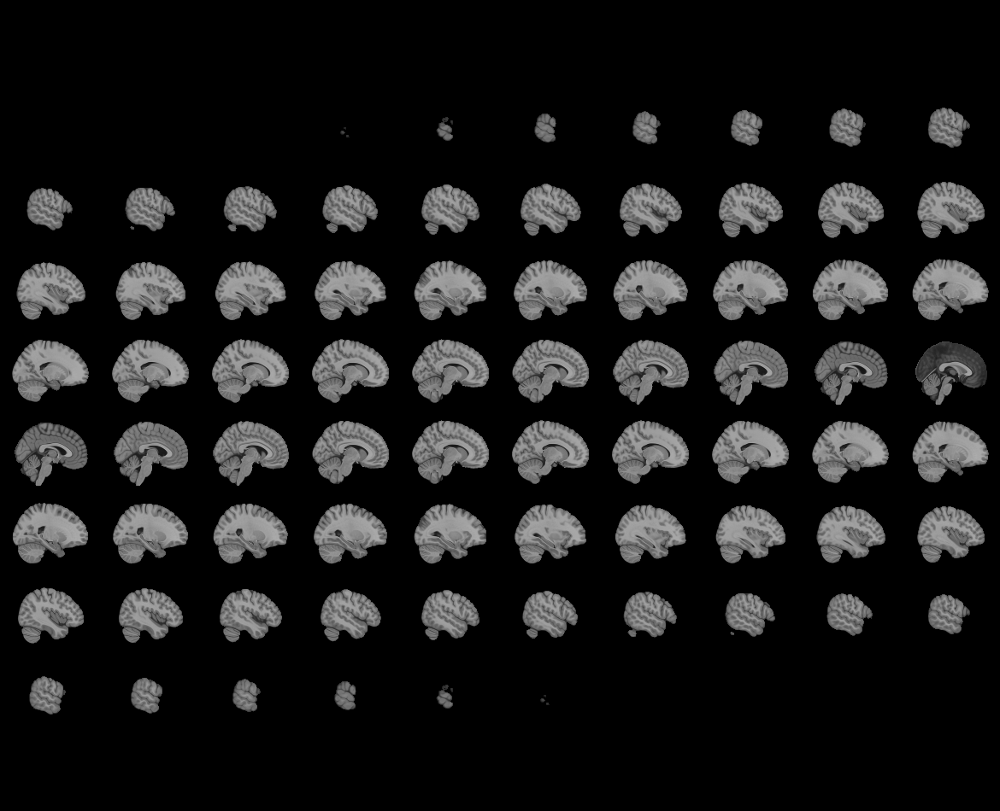
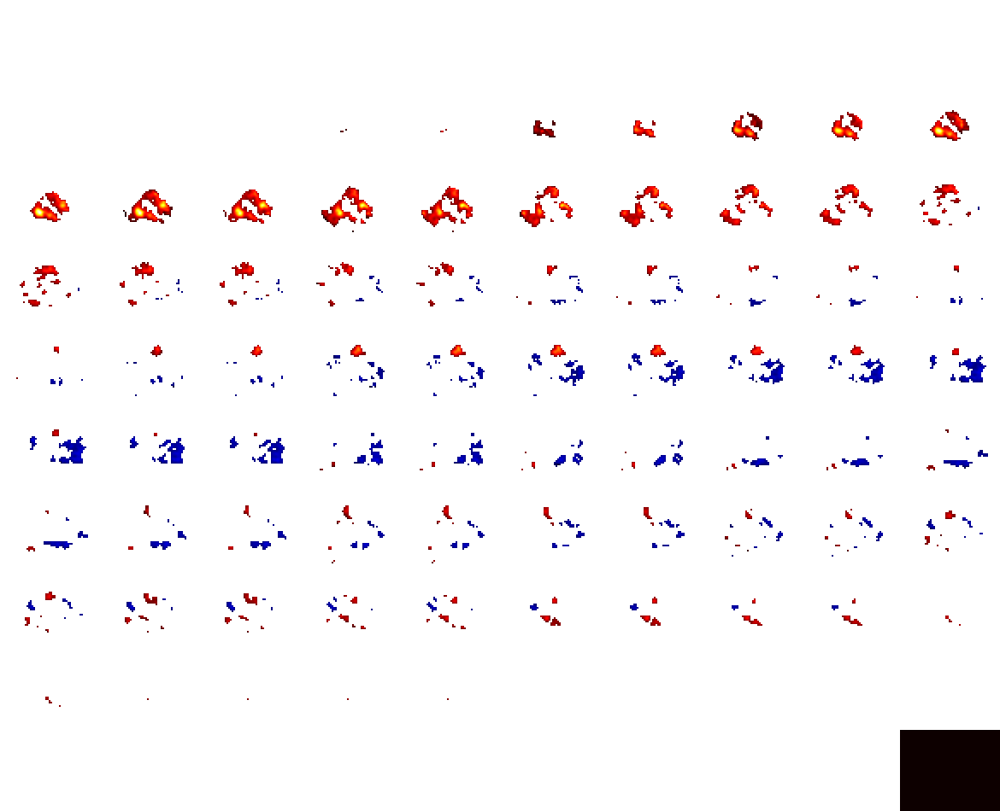

Neuroquery extracted terms
 - writing
 - comprehension
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.624013,0.00000,0.626349,443
comprehension,0.545915,0.00000,0.538283,1648
writing,0.518371,0.00000,0.531661,955
without,0.181040,0.00000,0.187817,9055
asd,0.058495,0.00000,0.000000,317
sentence,0.045401,3.83206,0.000000,1605
chinese,0.034511,0.00000,0.000000,975
letter,0.030898,0.00000,0.000000,2538
autism,0.021779,0.00000,0.000000,991
orthographic,0.016977,0.00000,0.000000,603


,pmid,title,pubmed_url,similarity
0,23844132,Functional Anatomy of Writing with the Dominan...,https://www.ncbi.nlm.nih.gov/pubmed/23844132,0.425141
1,21930136,SOME IS NOT ENOUGH: QUANTIFIER COMPREHENSION I...,https://www.ncbi.nlm.nih.gov/pubmed/21930136,0.400267
2,26474740,The neural basis of humour comprehension and h...,https://www.ncbi.nlm.nih.gov/pubmed/26474740,0.395980
3,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.387454
4,16872841,Interindividual uniformity and variety of the ...,https://www.ncbi.nlm.nih.gov/pubmed/16872841,0.385414
5,17141528,Evidence for bilateral involvement in idiom co...,https://www.ncbi.nlm.nih.gov/pubmed/17141528,0.377789
6,25955655,Cerebral Activations Related to Writing and Dr...,https://www.ncbi.nlm.nih.gov/pubmed/25955655,0.374169
7,28242518,“Decoding versus comprehension”: Brain respons...,https://www.ncbi.nlm.nih.gov/pubmed/28242518,0.358803
8,28802915,Neurological evaluation of the selection stage...,https://www.ncbi.nlm.nih.gov/pubmed/28802915,0.357610
9,22836181,Design choices in imaging speech comprehension...,https://www.ncbi.nlm.nih.gov/pubmed/22836181,0.350875



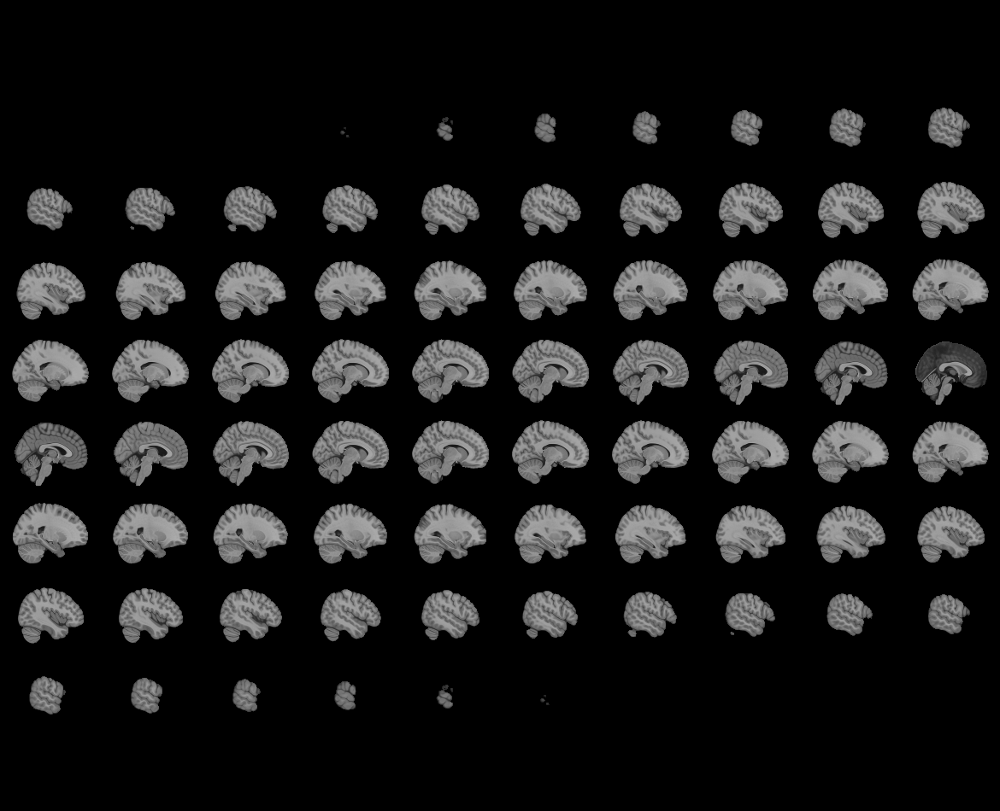
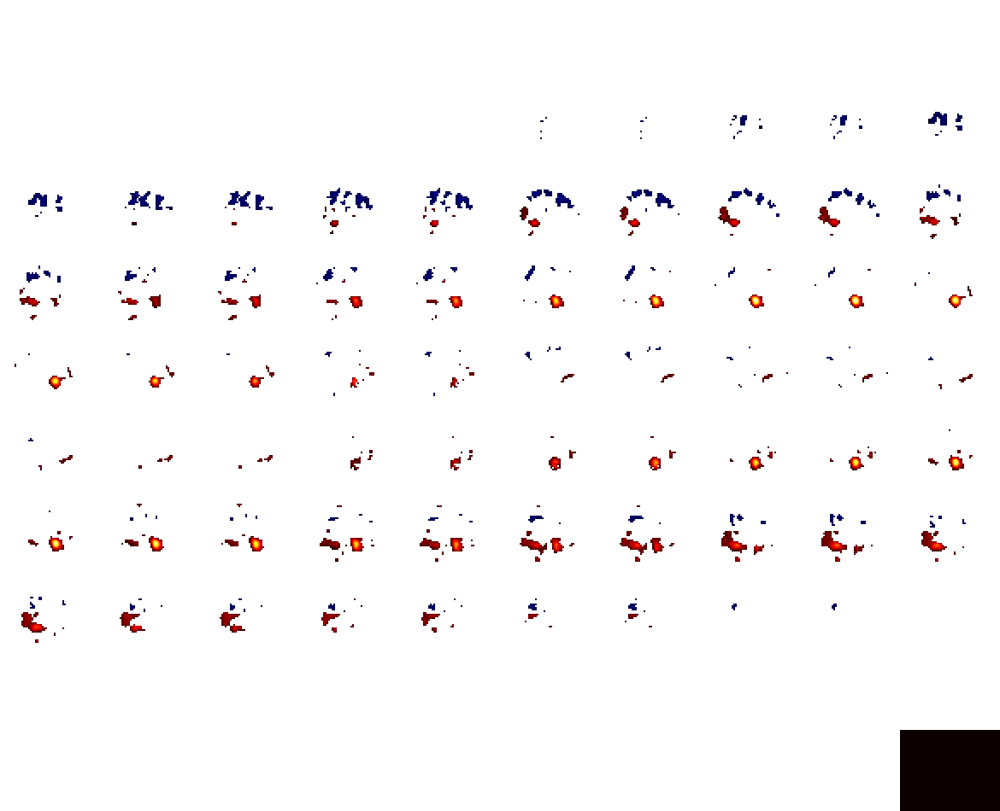

Neuroquery extracted terms
 - emotional
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.896333,0.0,0.910818,443
emotional,0.434024,0.0,0.412808,6103
asd,0.080600,0.0,0.000000,317
autism,0.029964,0.0,0.000000,991
spectrum,0.021717,0.0,0.000000,1806
disorder,0.013010,0.0,0.000000,8378
atypical,0.003011,0.0,0.000000,1162
autistic,0.002844,0.0,0.000000,319
stimuli,0.002815,0.0,0.000000,10529
emotional stimuli,0.002634,0.0,0.000000,1370


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.547742
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.473795
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.465899
3,26526072,Differences in Neural Activity when Processing...,https://www.ncbi.nlm.nih.gov/pubmed/26526072,0.453145
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.439320
5,28516421,Differential Fairness Decisions and Brain Resp...,https://www.ncbi.nlm.nih.gov/pubmed/28516421,0.435764
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.431267
7,25610782,Early neural activation during facial affect p...,https://www.ncbi.nlm.nih.gov/pubmed/25610782,0.430651
8,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.430399
9,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.427327



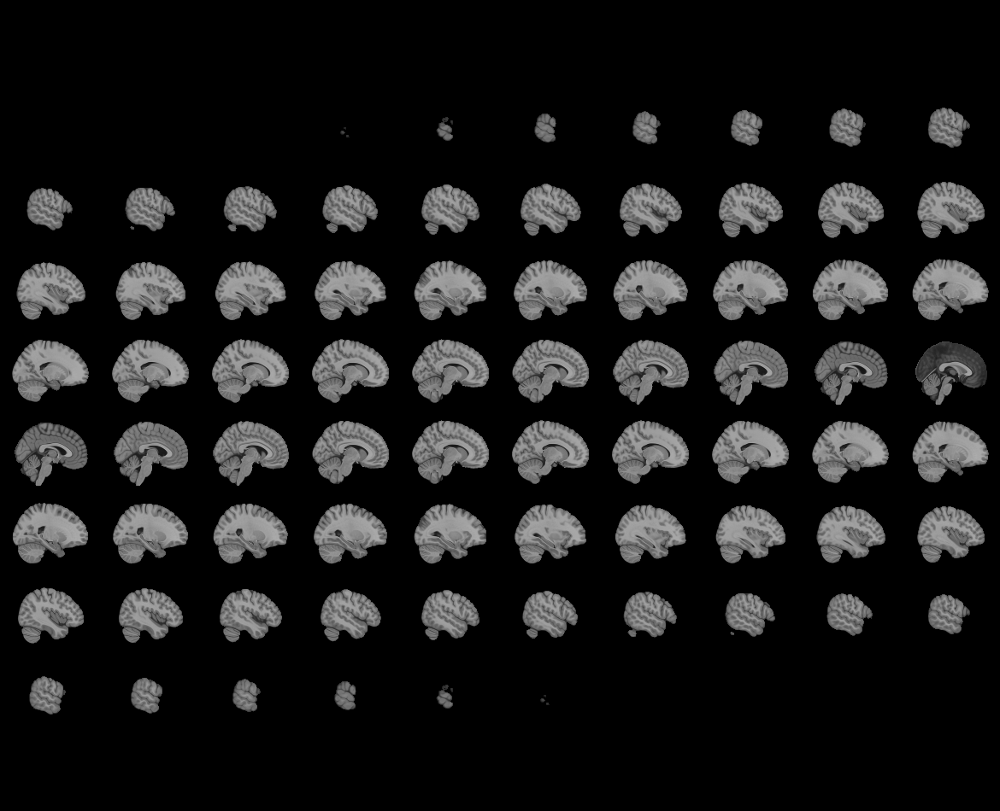
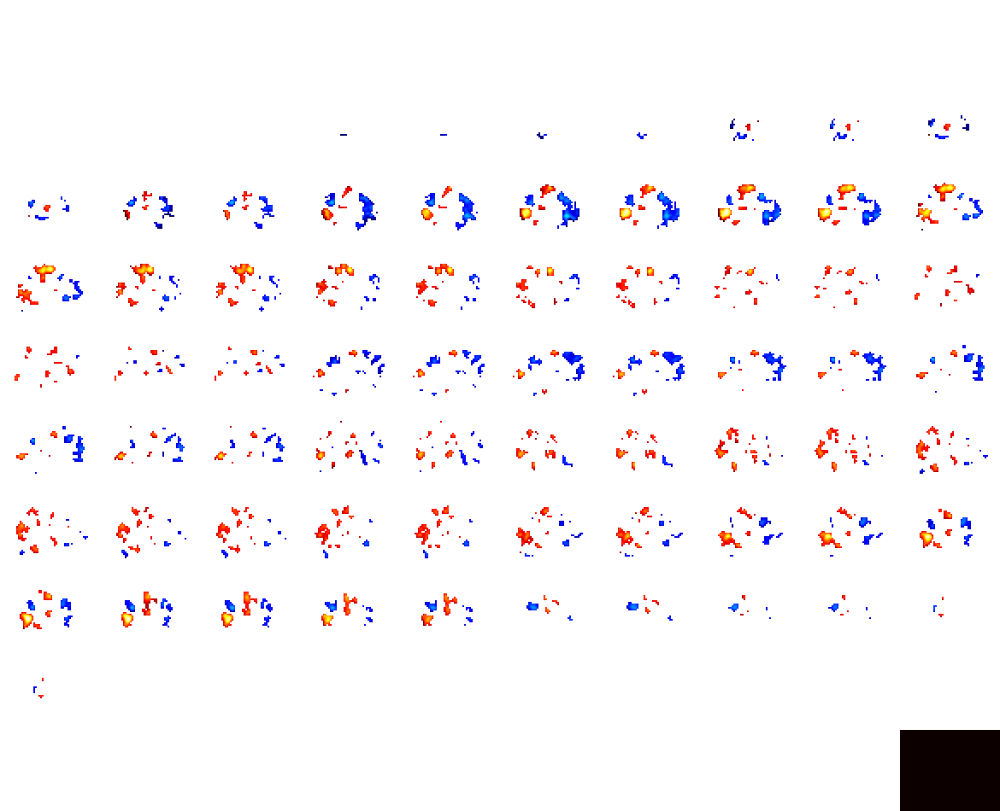

Neuroquery extracted terms
 - emotional
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.866605,0.0,0.878637,443
emotional,0.420294,0.0,0.398223,6103
without,0.251345,0.0,0.263469,9055
asd,0.080135,0.0,0.000000,317
autism,0.029675,0.0,0.000000,991
spectrum,0.021694,0.0,0.000000,1806
disorder,0.015784,0.0,0.000000,8378
patient,0.010776,0.0,0.000000,7859
brain,0.008687,0.0,0.000000,13395
ptsd,0.008151,0.0,0.000000,394


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.534625
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.463153
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.454654
3,26526072,Differences in Neural Activity when Processing...,https://www.ncbi.nlm.nih.gov/pubmed/26526072,0.442394
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.431040
5,28516421,Differential Fairness Decisions and Brain Resp...,https://www.ncbi.nlm.nih.gov/pubmed/28516421,0.426660
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.425963
7,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.424764
8,25610782,Early neural activation during facial affect p...,https://www.ncbi.nlm.nih.gov/pubmed/25610782,0.424122
9,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.419317



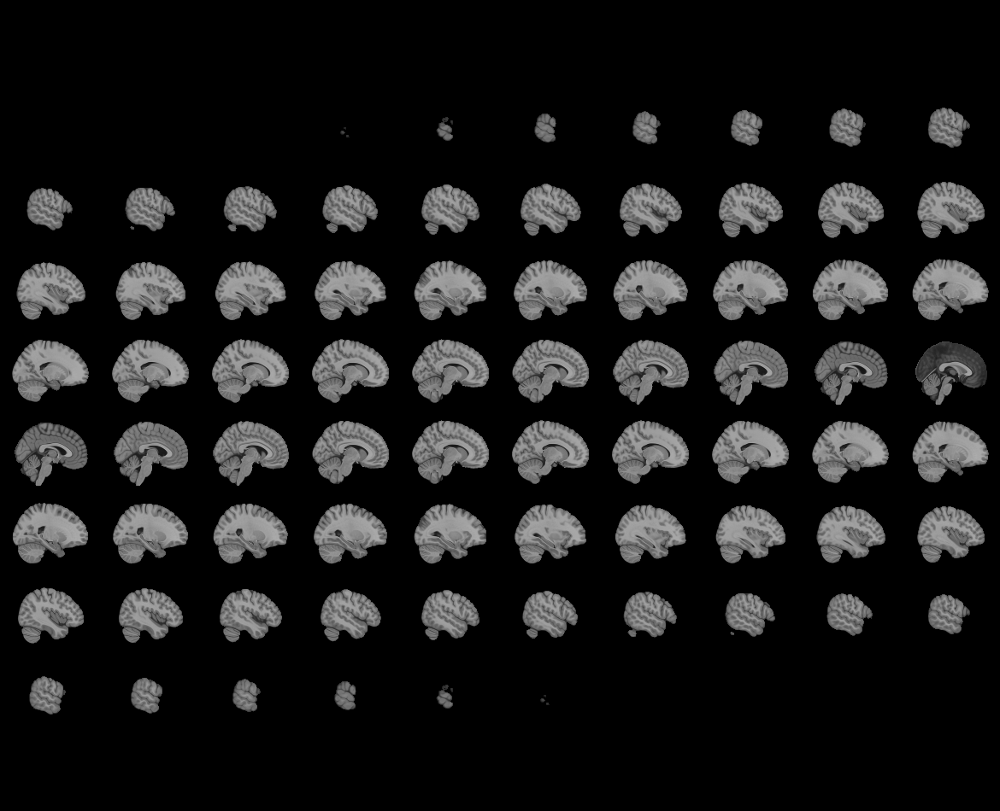
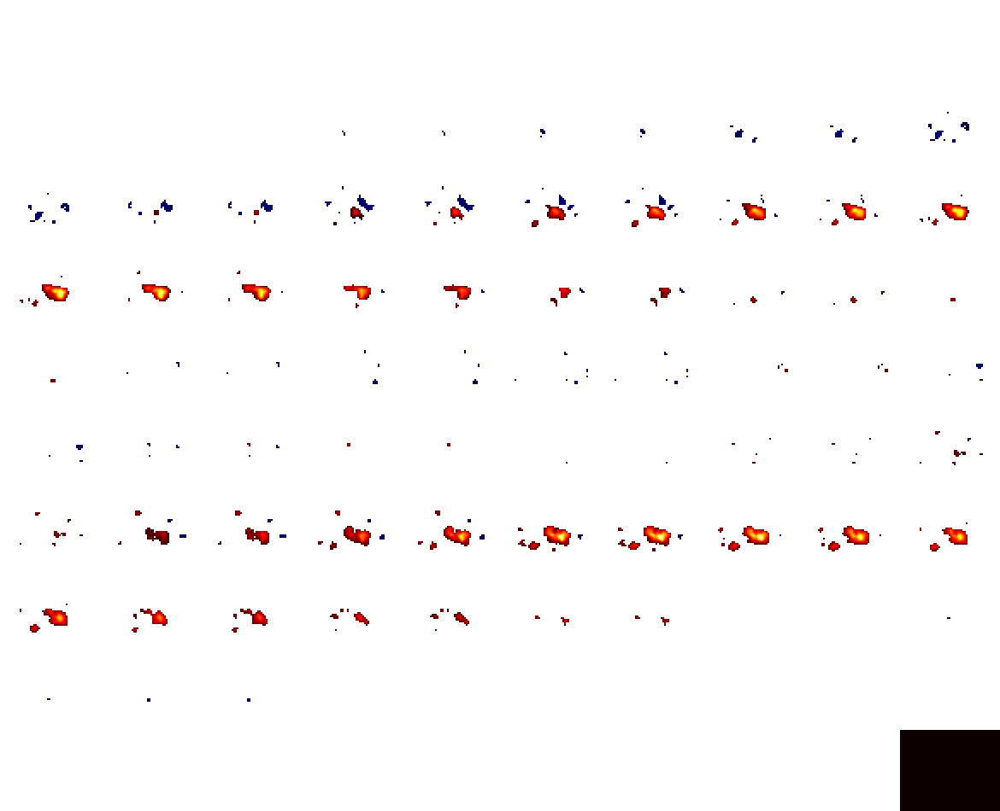

Neuroquery extracted terms
 - self
 - awareness
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.724381,0.000000,0.738077,443
awareness,0.549013,0.000000,0.567927,2190
self,0.406443,0.000000,0.364281,6383
asd,0.065158,0.000000,0.000000,317
mindfulness,0.025111,0.000000,0.000000,149
autism,0.024196,0.000000,0.000000,991
error,0.020283,0.000000,0.000000,8304
alexithymia,0.018534,0.000000,0.000000,131
spectrum,0.017582,0.000000,0.000000,1806
insula,0.014983,9.793456,0.000000,7050


,pmid,title,pubmed_url,similarity
0,22480958,Neurobiology of Self-Awareness in Schizophreni...,https://www.ncbi.nlm.nih.gov/pubmed/22480958,0.488032
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.444453
2,27377788,Neural correlates of mindful self-awareness in...,https://www.ncbi.nlm.nih.gov/pubmed/27377788,0.431277
3,25481475,Neuroanatomical correlates of awareness of ill...,https://www.ncbi.nlm.nih.gov/pubmed/25481475,0.425527
4,26577539,Can the neural–cortisol association be moderat...,https://www.ncbi.nlm.nih.gov/pubmed/26577539,0.422854
5,23175832,Purging of Memories from Conscious Awareness T...,https://www.ncbi.nlm.nih.gov/pubmed/23175832,0.380565
6,22115024,Dividing the self: Distinct neural substrates ...,https://www.ncbi.nlm.nih.gov/pubmed/22115024,0.379526
7,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.378793
8,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.377908
9,28338742,Brain mechanisms for loss of awareness of thou...,https://www.ncbi.nlm.nih.gov/pubmed/28338742,0.373379



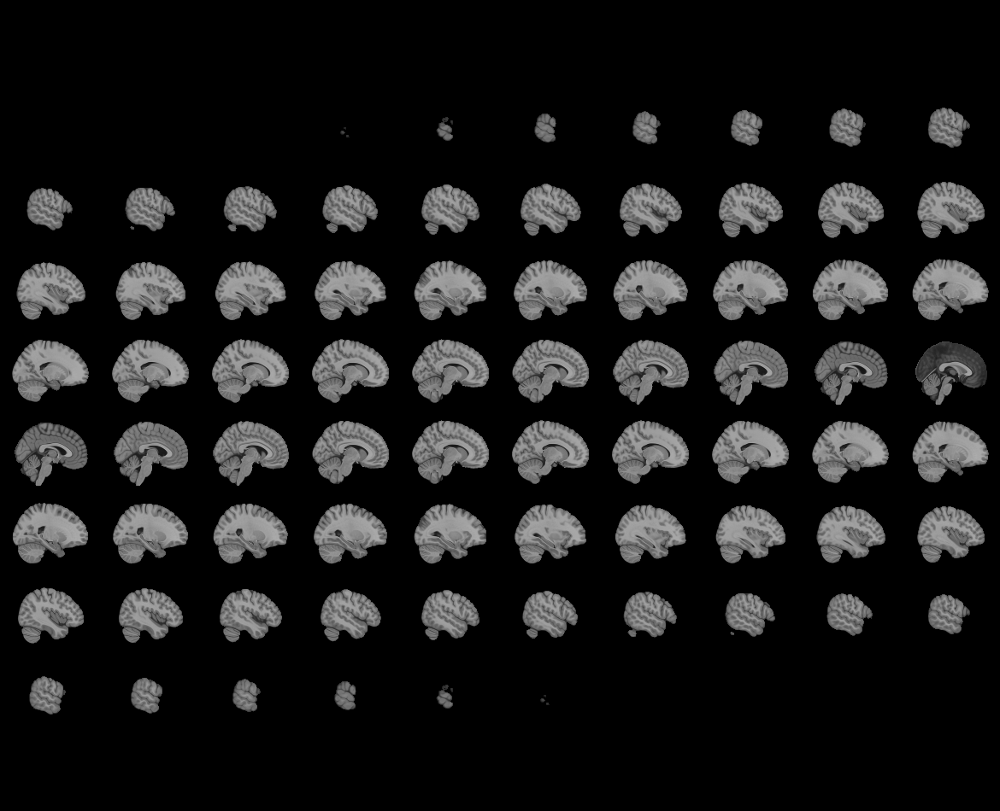
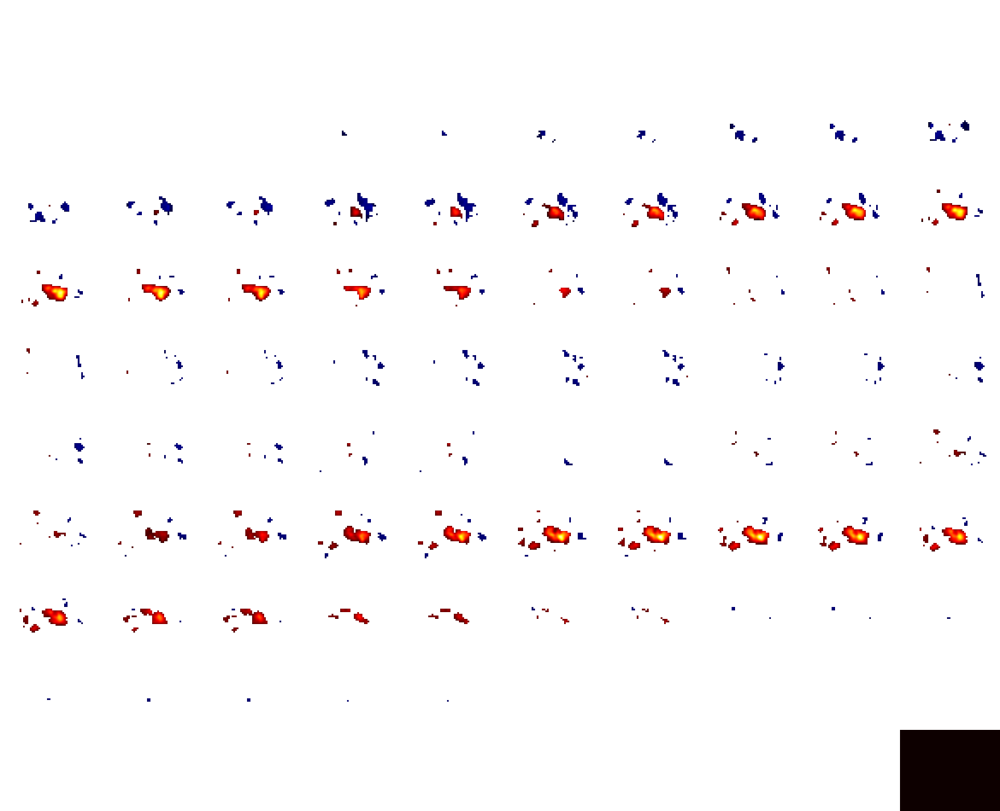

Neuroquery extracted terms
 - self
 - awareness
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.708172,0.0,0.720639,443
awareness,0.536566,0.0,0.554509,2190
self,0.397902,0.0,0.355675,6383
without,0.205819,0.0,0.216091,9055
asd,0.065505,0.0,0.000000,317
mindfulness,0.024841,0.0,0.000000,149
autism,0.024231,0.0,0.000000,991
error,0.020887,0.0,0.000000,8304
alexithymia,0.018100,0.0,0.000000,131
spectrum,0.017759,0.0,0.000000,1806


,pmid,title,pubmed_url,similarity
0,22480958,Neurobiology of Self-Awareness in Schizophreni...,https://www.ncbi.nlm.nih.gov/pubmed/22480958,0.479341
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.438631
2,27377788,Neural correlates of mindful self-awareness in...,https://www.ncbi.nlm.nih.gov/pubmed/27377788,0.425359
3,25481475,Neuroanatomical correlates of awareness of ill...,https://www.ncbi.nlm.nih.gov/pubmed/25481475,0.421133
4,26577539,Can the neural–cortisol association be moderat...,https://www.ncbi.nlm.nih.gov/pubmed/26577539,0.417009
5,22115024,Dividing the self: Distinct neural substrates ...,https://www.ncbi.nlm.nih.gov/pubmed/22115024,0.376295
6,23175832,Purging of Memories from Conscious Awareness T...,https://www.ncbi.nlm.nih.gov/pubmed/23175832,0.375369
7,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.374466
8,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.372888
9,28338742,Brain mechanisms for loss of awareness of thou...,https://www.ncbi.nlm.nih.gov/pubmed/28338742,0.370561



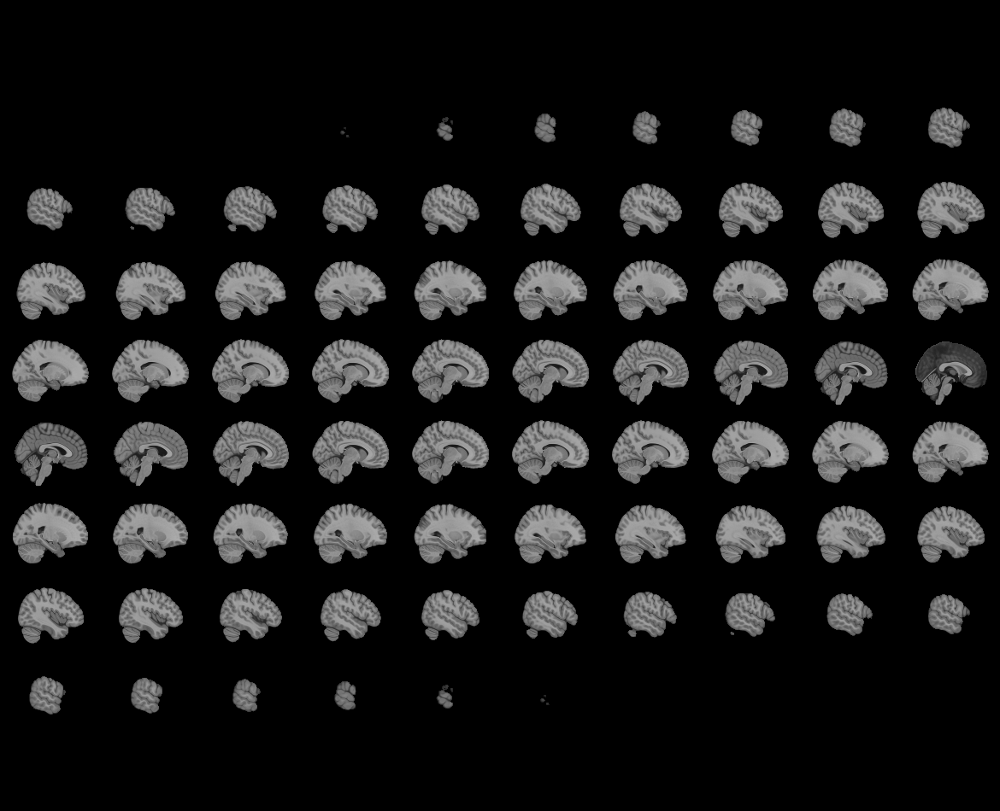
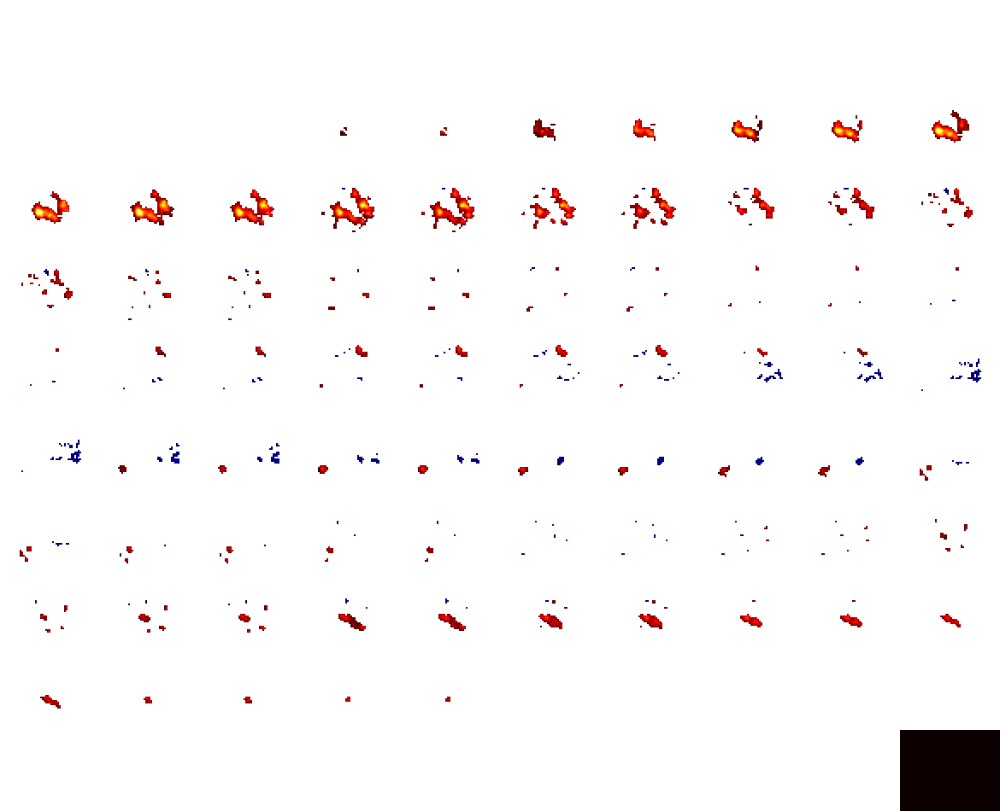

Neuroquery extracted terms
 - verbal
 - comprehension
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.670727,0.000000,0.682283,443
comprehension,0.587277,0.000000,0.586352,1648
verbal,0.443030,0.000000,0.436671,4475
asd,0.061170,0.000000,0.000000,317
sentence,0.048887,4.126262,0.000000,1605
fluency,0.025128,0.000000,0.000000,1098
autism,0.022969,0.000000,0.000000,991
spectrum,0.016552,0.000000,0.000000,1806
verbal fluency,0.015832,0.000000,0.000000,578
memory,0.011212,0.674524,0.000000,8405


,pmid,title,pubmed_url,similarity
0,22472220,Segregating the comprehension and elaboration ...,https://www.ncbi.nlm.nih.gov/pubmed/22472220,0.458879
1,21930136,SOME IS NOT ENOUGH: QUANTIFIER COMPREHENSION I...,https://www.ncbi.nlm.nih.gov/pubmed/21930136,0.428364
2,26474740,The neural basis of humour comprehension and h...,https://www.ncbi.nlm.nih.gov/pubmed/26474740,0.420562
3,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.412116
4,17141528,Evidence for bilateral involvement in idiom co...,https://www.ncbi.nlm.nih.gov/pubmed/17141528,0.401321
5,28242518,“Decoding versus comprehension”: Brain respons...,https://www.ncbi.nlm.nih.gov/pubmed/28242518,0.382270
6,28802915,Neurological evaluation of the selection stage...,https://www.ncbi.nlm.nih.gov/pubmed/28802915,0.379202
7,22836181,Design choices in imaging speech comprehension...,https://www.ncbi.nlm.nih.gov/pubmed/22836181,0.372739
8,26459989,Predicting better performance on a college pre...,https://www.ncbi.nlm.nih.gov/pubmed/26459989,0.361008
9,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.356719



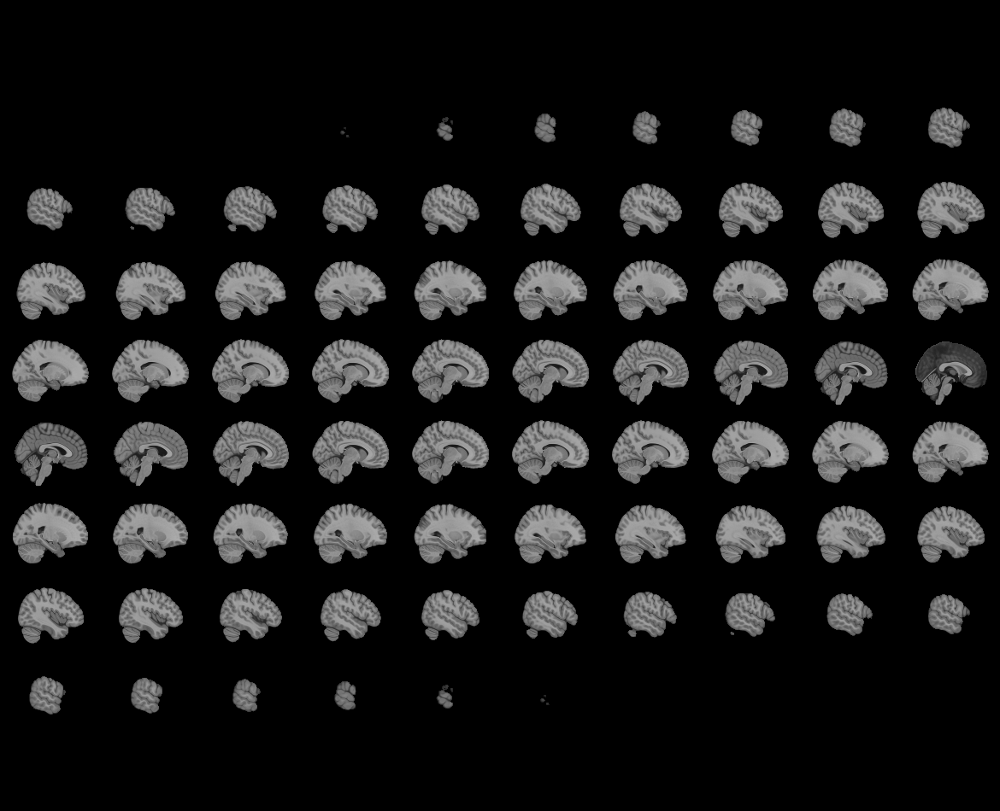
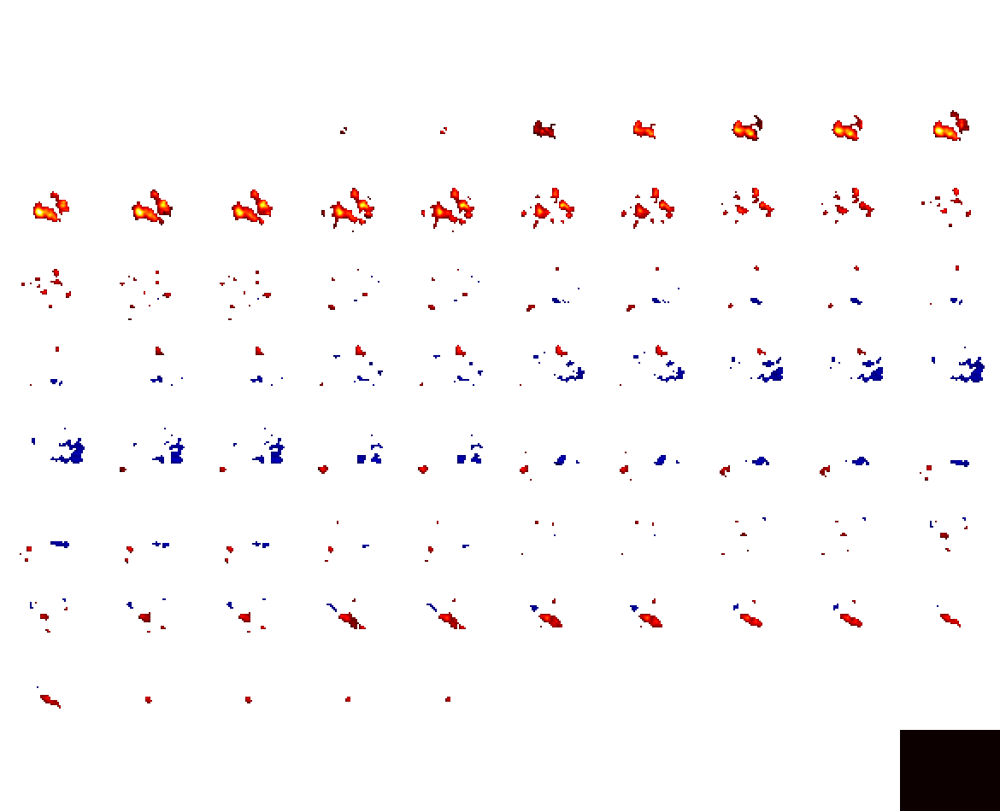

Neuroquery extracted terms
 - verbal
 - comprehension
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.658165,0.000000,0.668437,443
comprehension,0.575837,0.000000,0.574453,1648
verbal,0.434732,0.000000,0.427809,4475
without,0.190906,0.000000,0.200438,9055
asd,0.061699,0.000000,0.000000,317
sentence,0.048244,4.071967,0.000000,1605
fluency,0.024681,0.000000,0.000000,1098
autism,0.023074,0.000000,0.000000,991
spectrum,0.016771,0.000000,0.000000,1806
verbal fluency,0.015528,0.000000,0.000000,578


,pmid,title,pubmed_url,similarity
0,22472220,Segregating the comprehension and elaboration ...,https://www.ncbi.nlm.nih.gov/pubmed/22472220,0.451752
1,21930136,SOME IS NOT ENOUGH: QUANTIFIER COMPREHENSION I...,https://www.ncbi.nlm.nih.gov/pubmed/21930136,0.424075
2,26474740,The neural basis of humour comprehension and h...,https://www.ncbi.nlm.nih.gov/pubmed/26474740,0.417014
3,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.408228
4,17141528,Evidence for bilateral involvement in idiom co...,https://www.ncbi.nlm.nih.gov/pubmed/17141528,0.396311
5,28802915,Neurological evaluation of the selection stage...,https://www.ncbi.nlm.nih.gov/pubmed/28802915,0.384071
6,28242518,“Decoding versus comprehension”: Brain respons...,https://www.ncbi.nlm.nih.gov/pubmed/28242518,0.377863
7,22836181,Design choices in imaging speech comprehension...,https://www.ncbi.nlm.nih.gov/pubmed/22836181,0.368010
8,26459989,Predicting better performance on a college pre...,https://www.ncbi.nlm.nih.gov/pubmed/26459989,0.355848
9,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.353222



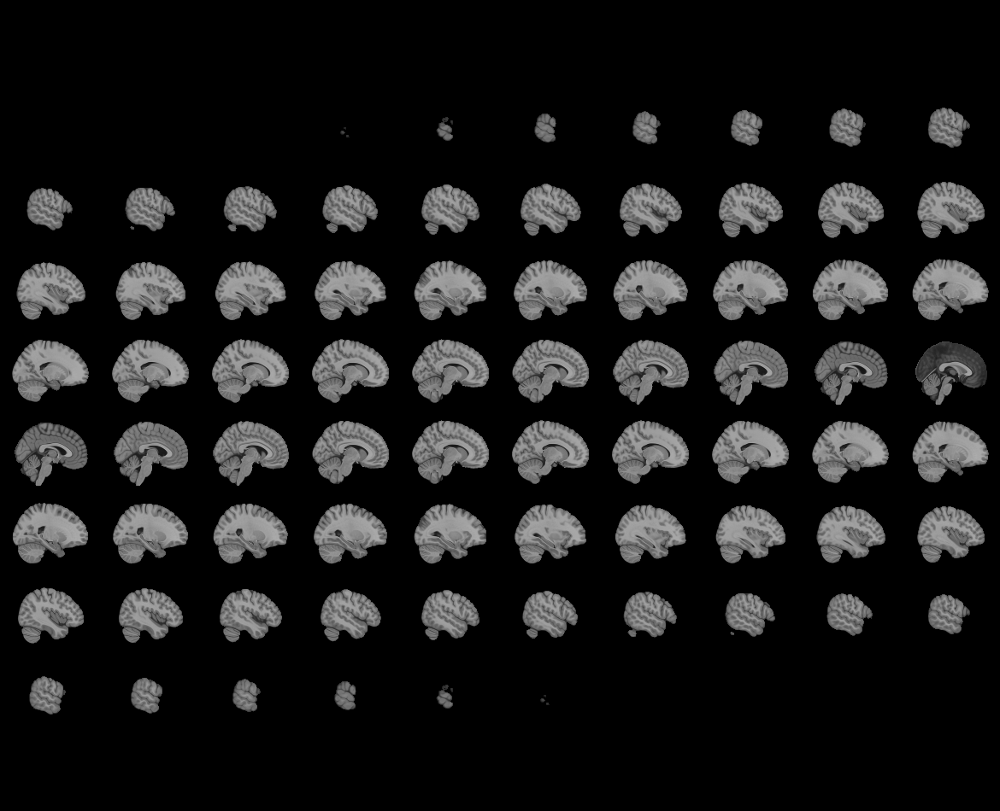
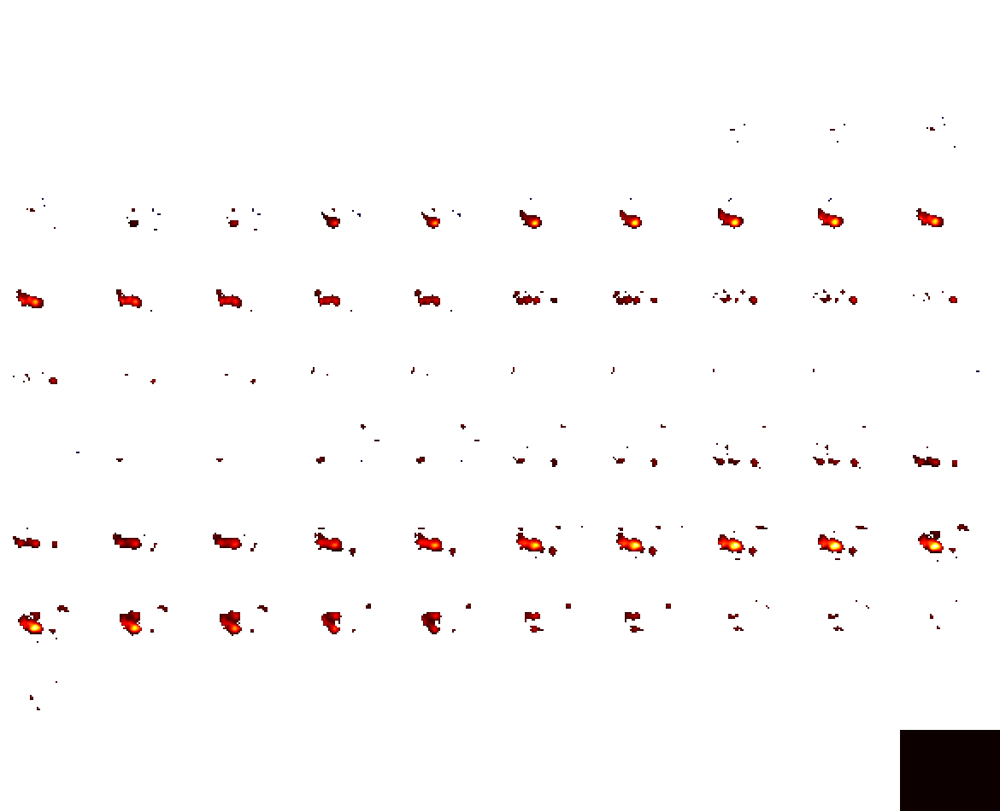

Neuroquery extracted terms
 - facial recognition
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
facial recognition,0.801335,0.000000,0.816008,120
autism spectrum disorder,0.588519,0.000000,0.578041,443
asd,0.052961,0.000000,0.000000,317
face,0.045145,15.772407,0.000000,4405
recognition,0.038336,0.000000,0.000000,4205
deception,0.036016,1.278095,0.000000,170
facial,0.033774,0.000000,0.000000,2184
facial expression,0.019714,0.000000,0.000000,1402
autism,0.019696,0.000000,0.000000,991
expression,0.014626,0.000000,0.000000,3498


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.361261
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.309275
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.307024
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.289520
4,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.284083
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.283949
6,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.280761
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.280235
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.275755
9,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.273894



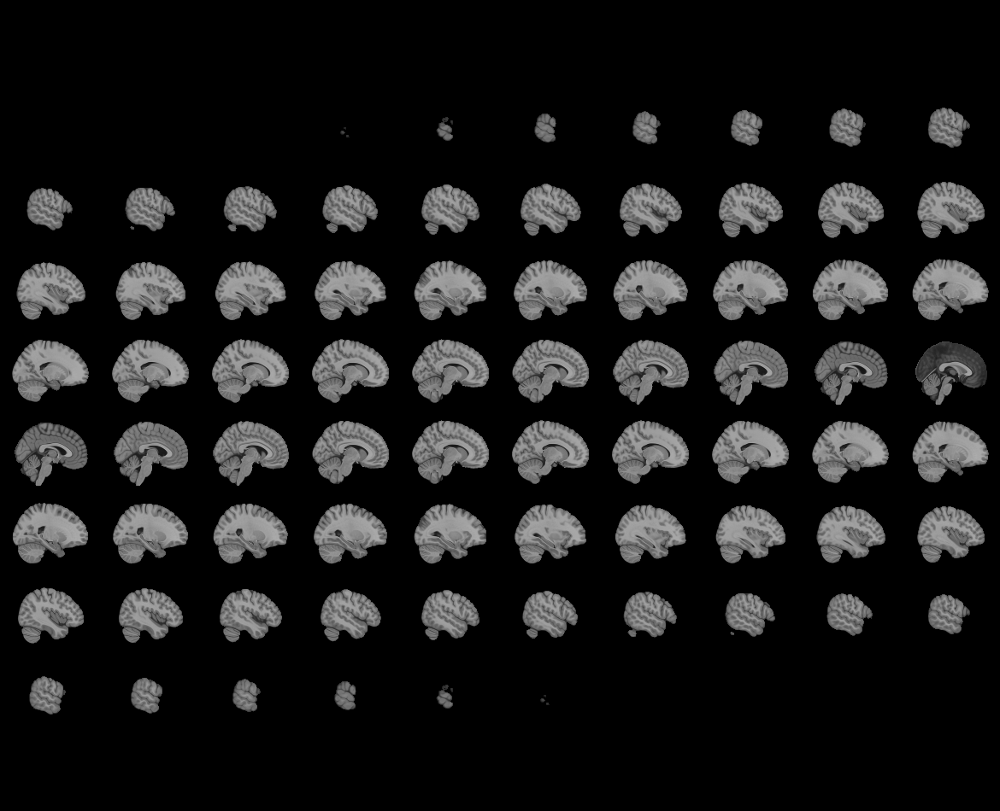
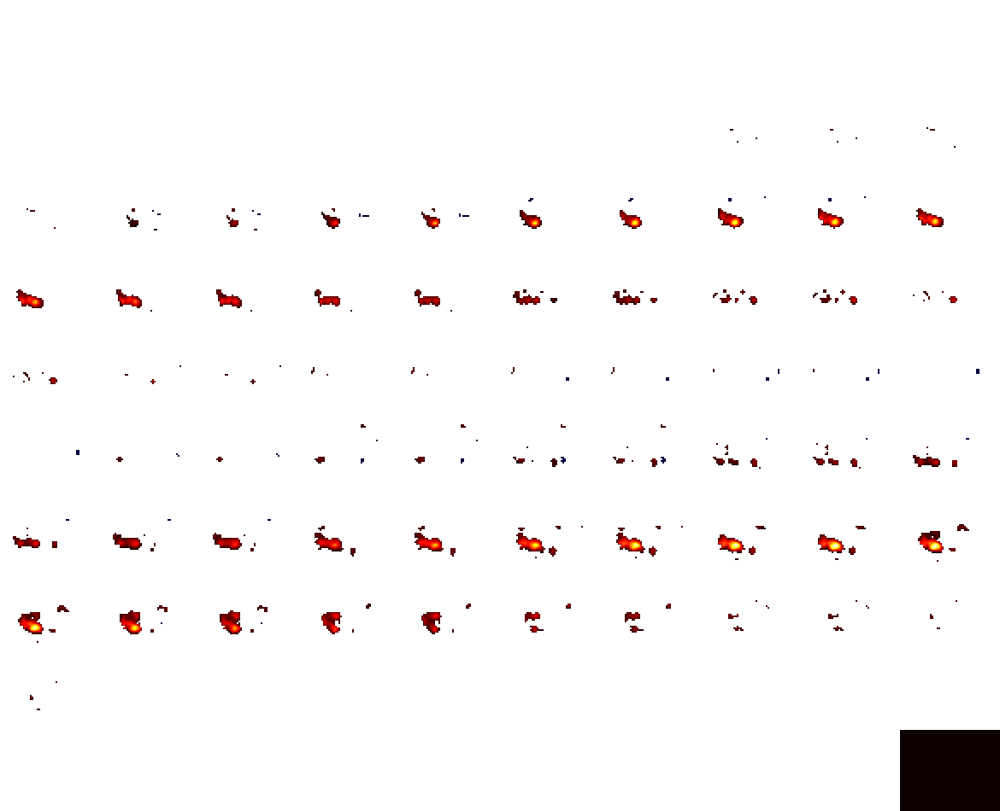

Neuroquery extracted terms
 - facial recognition
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
facial recognition,0.789216,0.000000,0.804019,120
autism spectrum disorder,0.580246,0.000000,0.569548,443
without,0.168390,0.000000,0.170785,9055
asd,0.053695,0.000000,0.000000,317
face,0.044499,15.546589,0.000000,4405
recognition,0.037827,0.000000,0.000000,4205
deception,0.035912,1.274382,0.000000,170
facial,0.033283,0.000000,0.000000,2184
autism,0.019891,0.000000,0.000000,991
facial expression,0.019428,0.000000,0.000000,1402


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.359561
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.308326
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.305523
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.289661
4,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.285982
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.285873
6,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.280940
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.280705
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.275871
9,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.275099



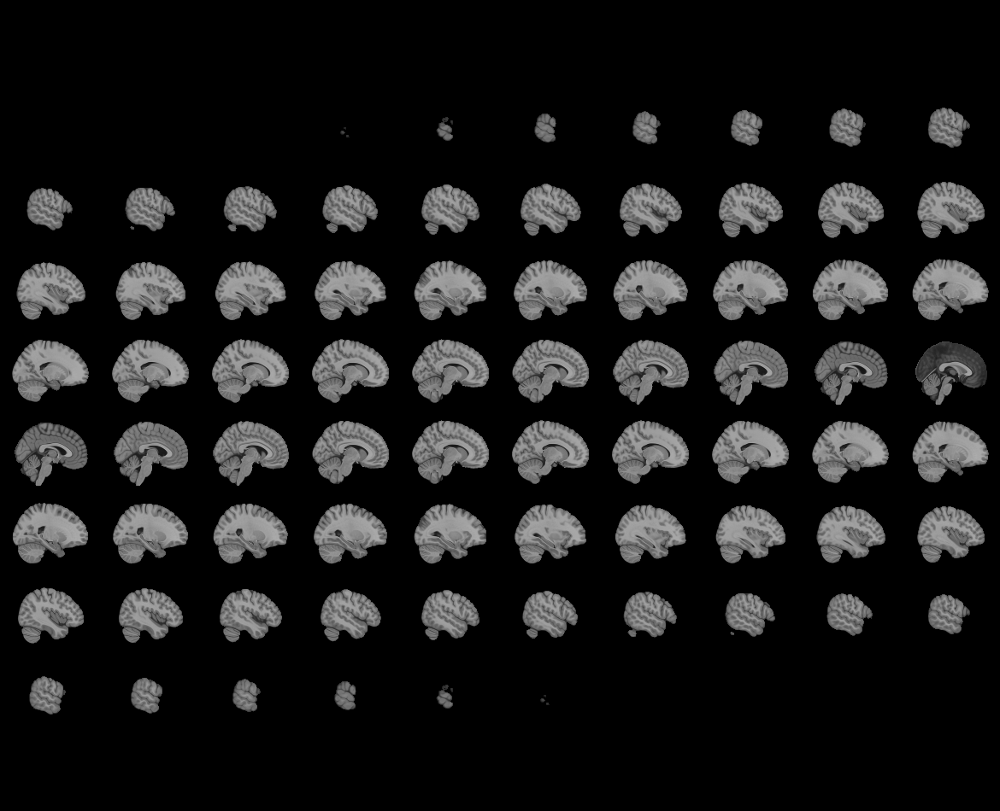
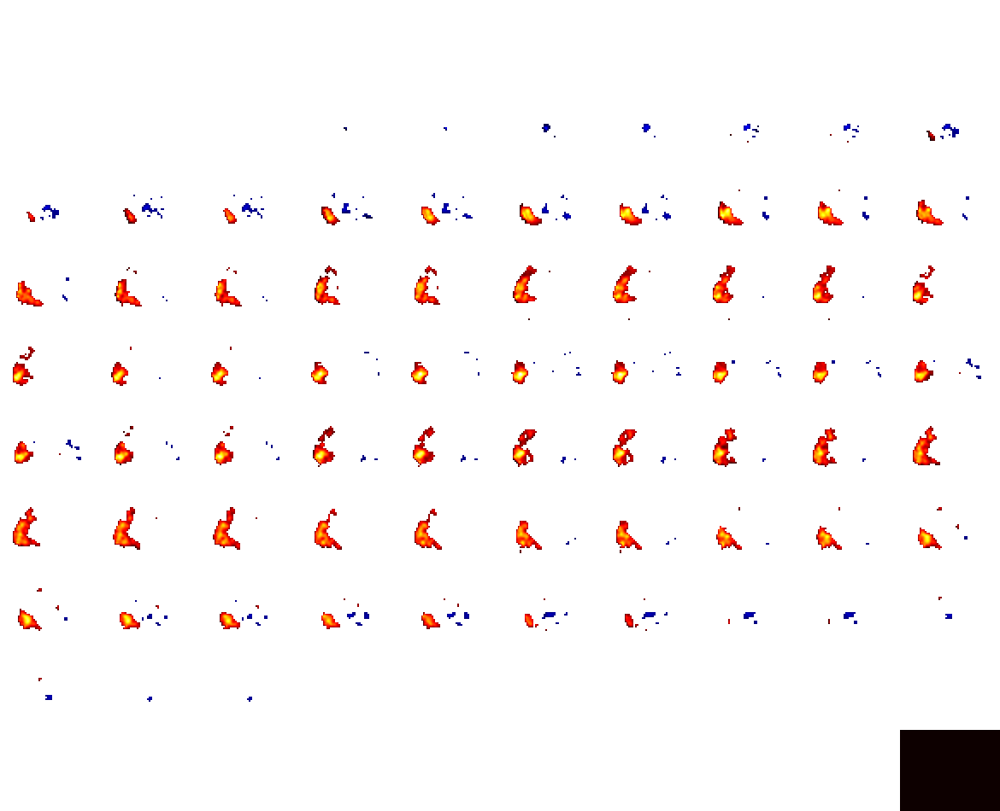

Neuroquery extracted terms
 - visual perception
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.703893,0.000000,0.698204,443
visual perception,0.702542,0.000000,0.715899,648
asd,0.063295,0.000000,0.000000,317
perception,0.052116,0.000000,0.000000,5464
visual,0.048749,24.131483,0.000000,10448
autism,0.023509,0.000000,0.000000,991
spectrum,0.017052,0.000000,0.000000,1806
disorder,0.010106,0.000000,0.000000,8378
visual cortex,0.009110,1.192277,0.000000,2165
cortex,0.007926,0.000000,0.000000,13015


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.430456
1,16626975,An fMRI study of the neural correlates of grad...,https://www.ncbi.nlm.nih.gov/pubmed/16626975,0.407193
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.367466
3,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.367034
4,16556505,Sound alters activity in human V1 in associati...,https://www.ncbi.nlm.nih.gov/pubmed/16556505,0.352124
5,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.345426
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.339595
7,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.338780
8,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.336284
9,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.334265



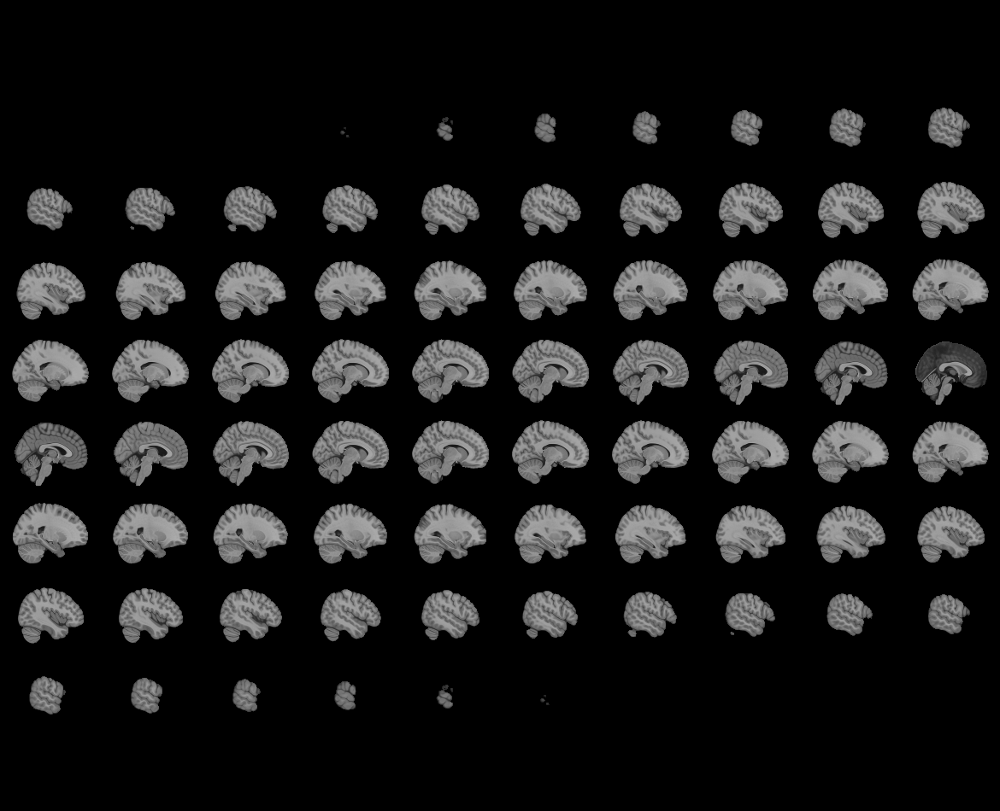
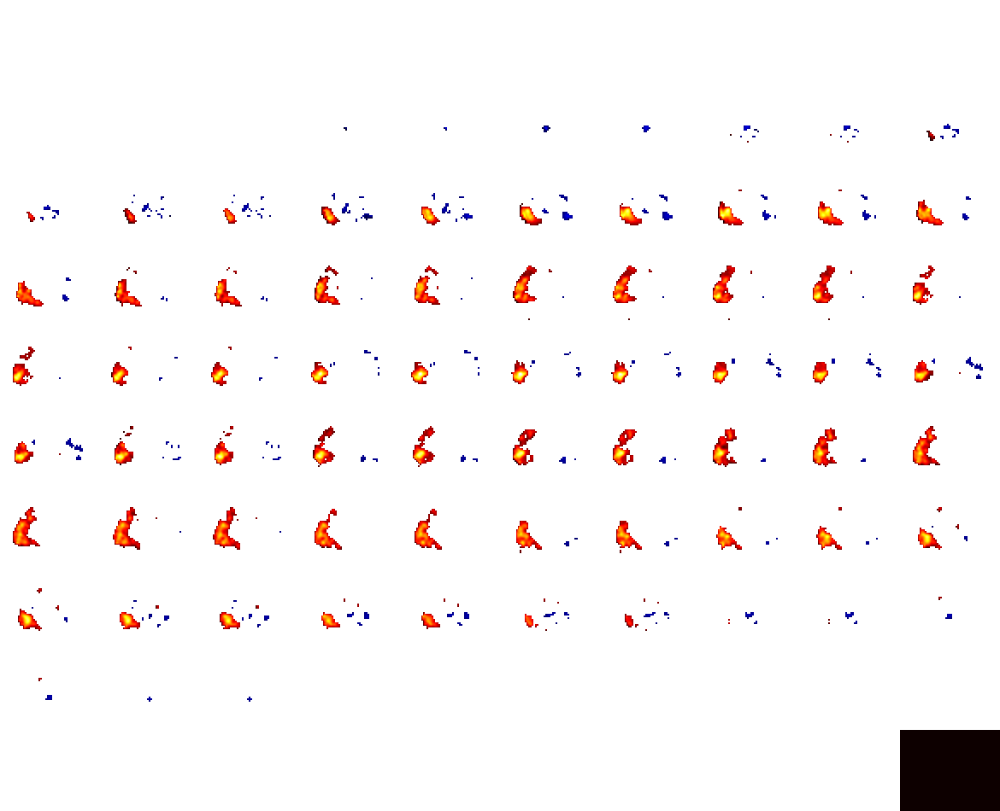

Neuroquery extracted terms
 - visual perception
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.689454,0.000000,0.683387,443
visual perception,0.687506,0.000000,0.700707,648
without,0.200189,0.000000,0.204921,9055
asd,0.063754,0.000000,0.000000,317
perception,0.051158,0.000000,0.000000,5464
visual,0.050216,24.857611,0.000000,10448
autism,0.023588,0.000000,0.000000,991
spectrum,0.017257,0.000000,0.000000,1806
disorder,0.012449,0.000000,0.000000,8378
visual cortex,0.009399,1.230168,0.000000,2165


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.425643
1,16626975,An fMRI study of the neural correlates of grad...,https://www.ncbi.nlm.nih.gov/pubmed/16626975,0.402363
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.363546
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.363273
4,16556505,Sound alters activity in human V1 in associati...,https://www.ncbi.nlm.nih.gov/pubmed/16556505,0.347977
5,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.343345
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.339788
7,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.338703
8,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.334623
9,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.332314



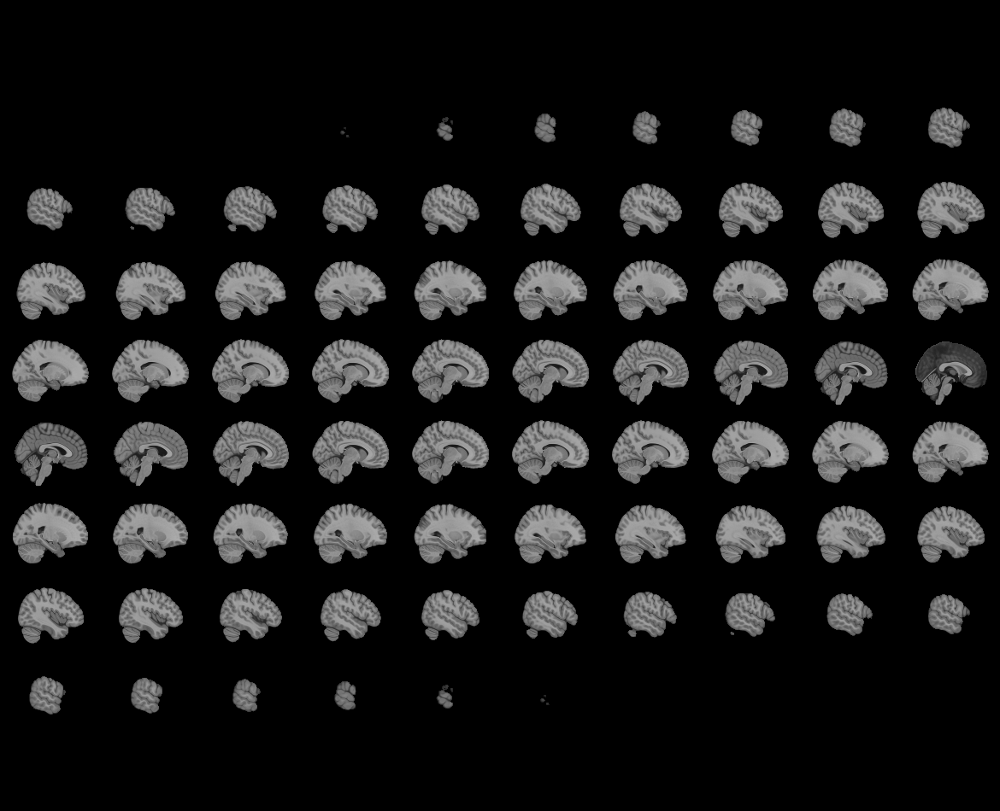
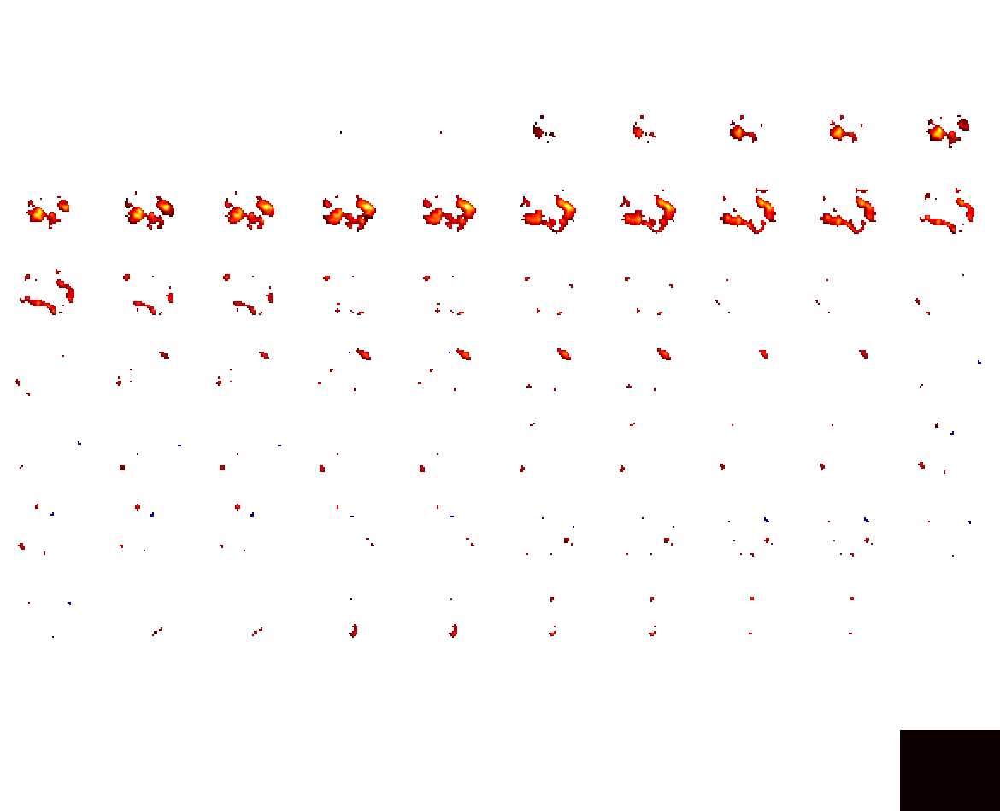

Neuroquery extracted terms
 - semantic processing
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.704978,0.000000,0.701831,443
semantic processing,0.701603,0.000000,0.712343,1313
semantic,0.073113,3.598736,0.000000,3566
asd,0.063398,0.000000,0.000000,317
autism,0.023553,0.000000,0.000000,991
spectrum,0.017079,0.000000,0.000000,1806
disorder,0.010158,0.000000,0.000000,8378
semantic memory,0.009669,0.000000,0.000000,642
word,0.006814,0.920658,0.000000,6479
concept,0.004722,0.000000,0.000000,3582


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.430983
1,22078639,The question shapes the answer: The neural cor...,https://www.ncbi.nlm.nih.gov/pubmed/22078639,0.410885
2,22375111,The neural correlates of the body-object inter...,https://www.ncbi.nlm.nih.gov/pubmed/22375111,0.379587
3,23847490,Spatial and temporal features of superordinate...,https://www.ncbi.nlm.nih.gov/pubmed/23847490,0.368889
4,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.366861
5,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.366697
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.345284
7,18279947,Recruitment of Anterior and Posterior Structur...,https://www.ncbi.nlm.nih.gov/pubmed/18279947,0.341042
8,20600969,Neural correlates of implicit and explicit com...,https://www.ncbi.nlm.nih.gov/pubmed/20600969,0.340071
9,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.340002



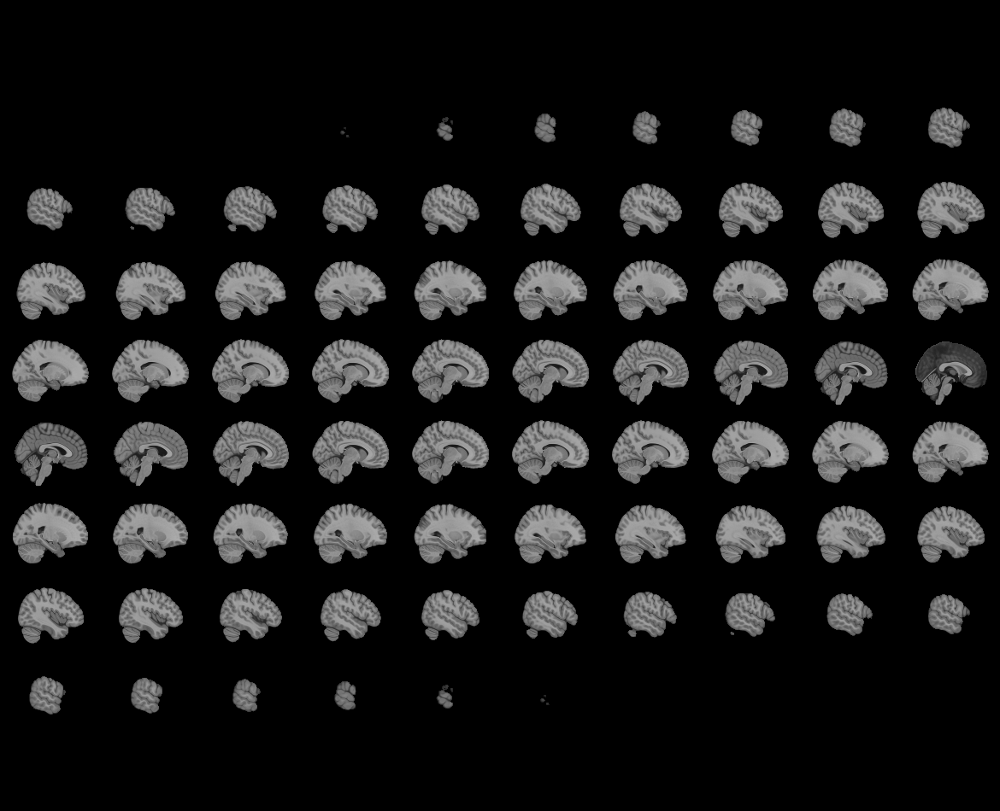
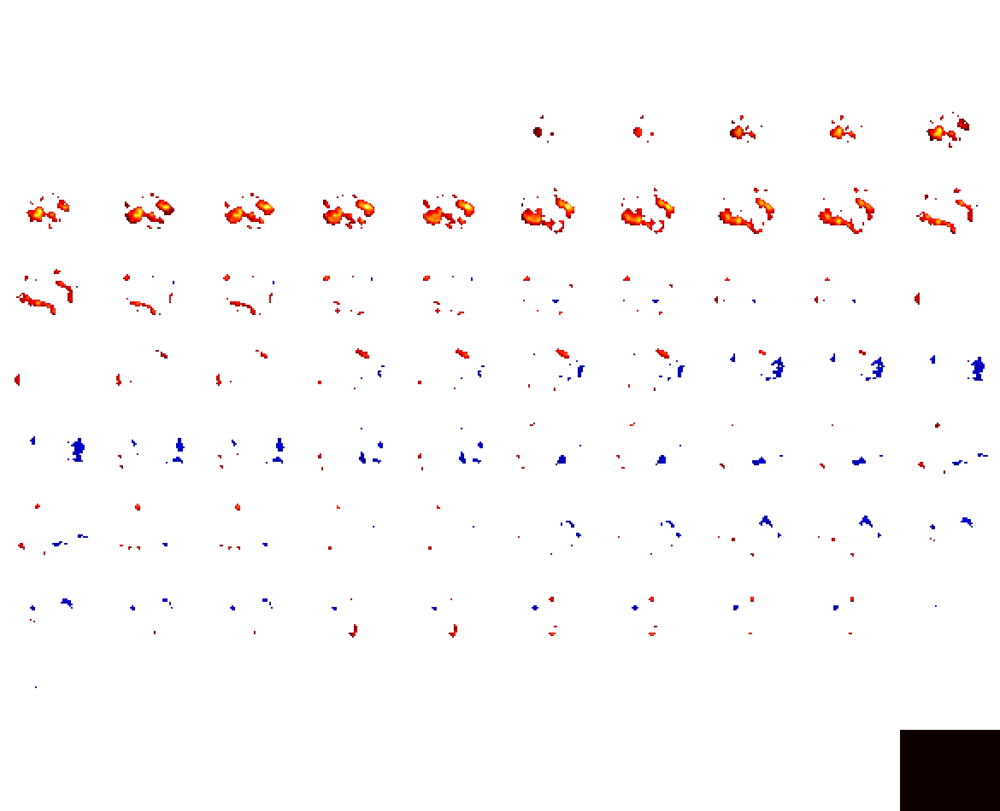

Neuroquery extracted terms
 - semantic processing
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.690674,0.000000,0.686787,443
semantic processing,0.686651,0.000000,0.697074,1313
without,0.200313,0.000000,0.205941,9055
semantic,0.071620,3.525232,0.000000,3566
asd,0.063871,0.000000,0.000000,317
autism,0.023637,0.000000,0.000000,991
spectrum,0.017288,0.000000,0.000000,1806
disorder,0.012507,0.000000,0.000000,8378
semantic memory,0.009491,0.000000,0.000000,642
patient,0.008650,0.000000,0.000000,7859


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.426262
1,22078639,The question shapes the answer: The neural cor...,https://www.ncbi.nlm.nih.gov/pubmed/22078639,0.404608
2,22375111,The neural correlates of the body-object inter...,https://www.ncbi.nlm.nih.gov/pubmed/22375111,0.375041
3,23847490,Spatial and temporal features of superordinate...,https://www.ncbi.nlm.nih.gov/pubmed/23847490,0.364466
4,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.363306
5,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.362769
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.343292
7,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.340276
8,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.339929
9,18279947,Recruitment of Anterior and Posterior Structur...,https://www.ncbi.nlm.nih.gov/pubmed/18279947,0.335669



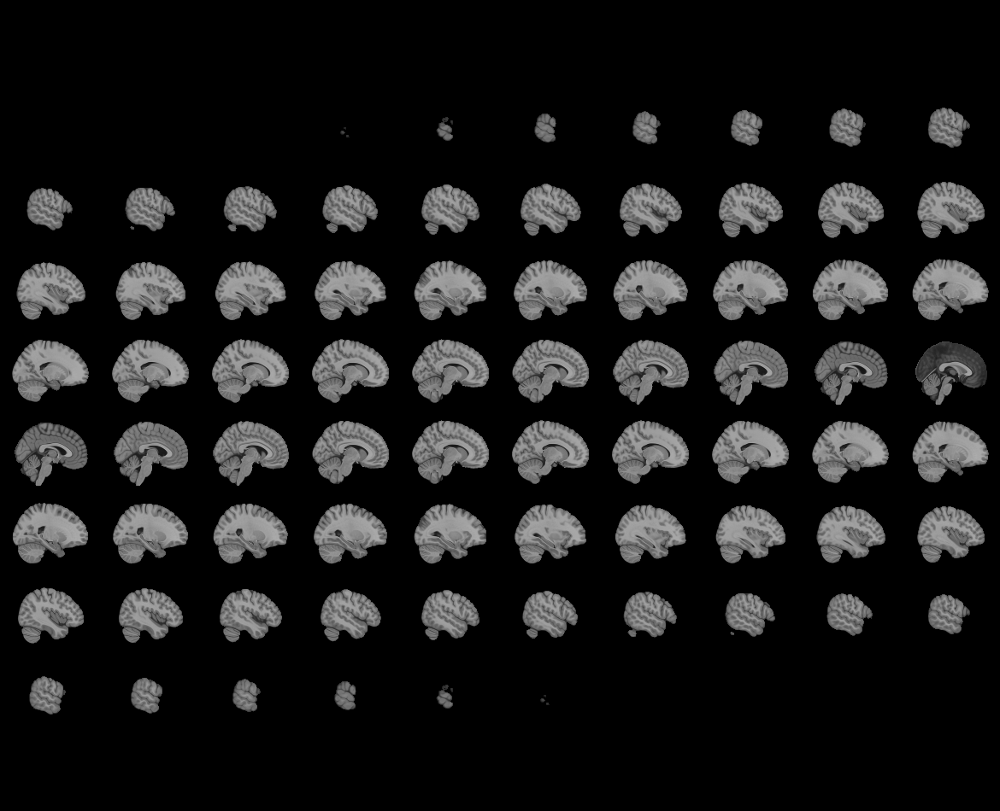
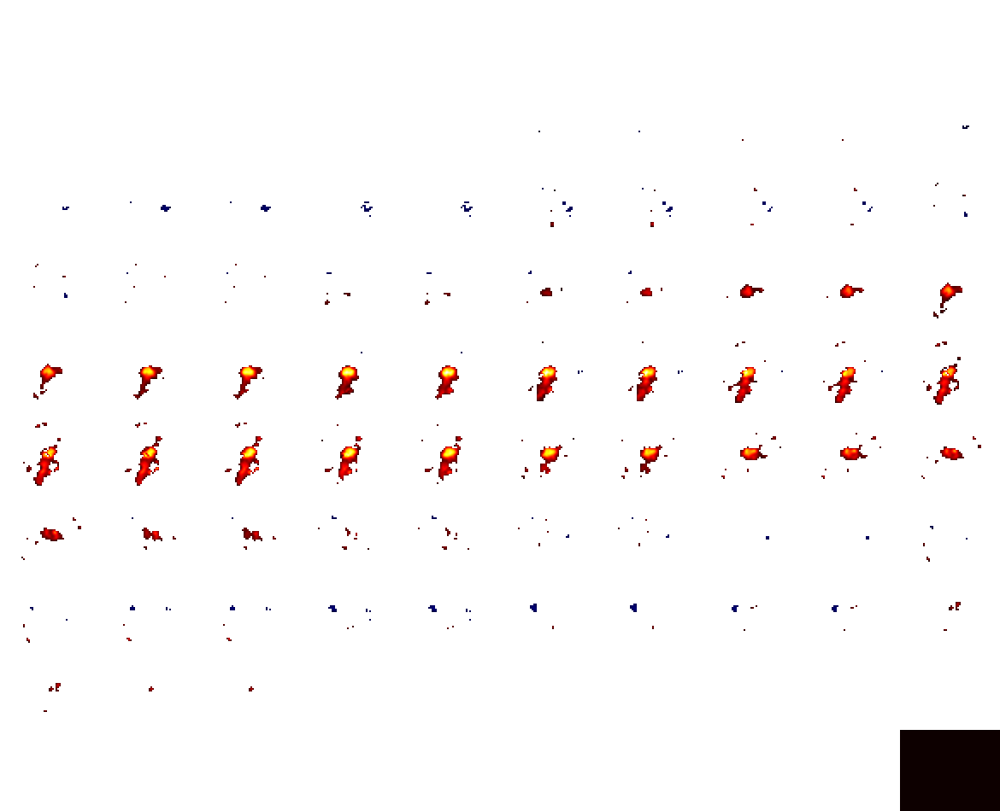

Neuroquery extracted terms
 - memory acquisition
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
memory acquisition,0.811719,0.0,0.826433,16
autism spectrum disorder,0.574139,0.0,0.563035,443
sleep,0.084269,0.0,0.000000,828
asd,0.051627,0.0,0.000000,317
sleep deprivation,0.020269,0.0,0.000000,154
autism,0.019176,0.0,0.000000,991
deprivation,0.016355,0.0,0.000000,389
spectrum,0.013908,0.0,0.000000,1806
disorder,0.008279,0.0,0.000000,8378
consolidation,0.007524,0.0,0.000000,532


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.351130
1,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.298657
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.298408
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.281084
4,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.276019
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.275804
6,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.271986
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.271943
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.266889
9,23715094,"Increased gyrification, but comparable surface...",https://www.ncbi.nlm.nih.gov/pubmed/23715094,0.265945



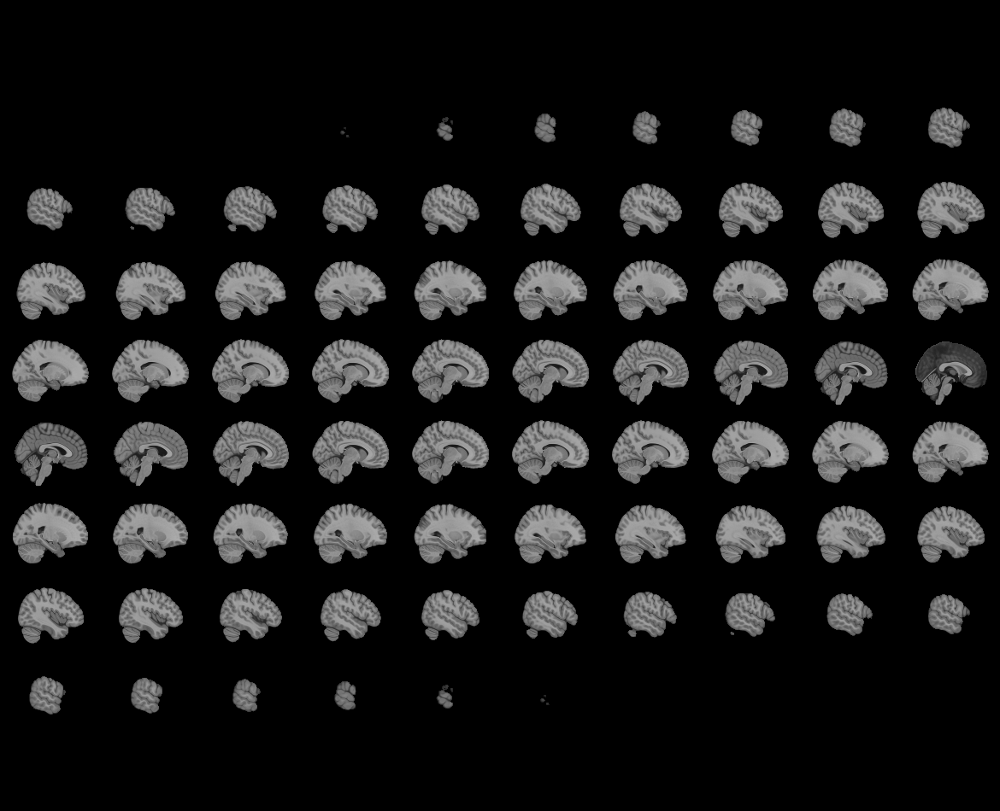
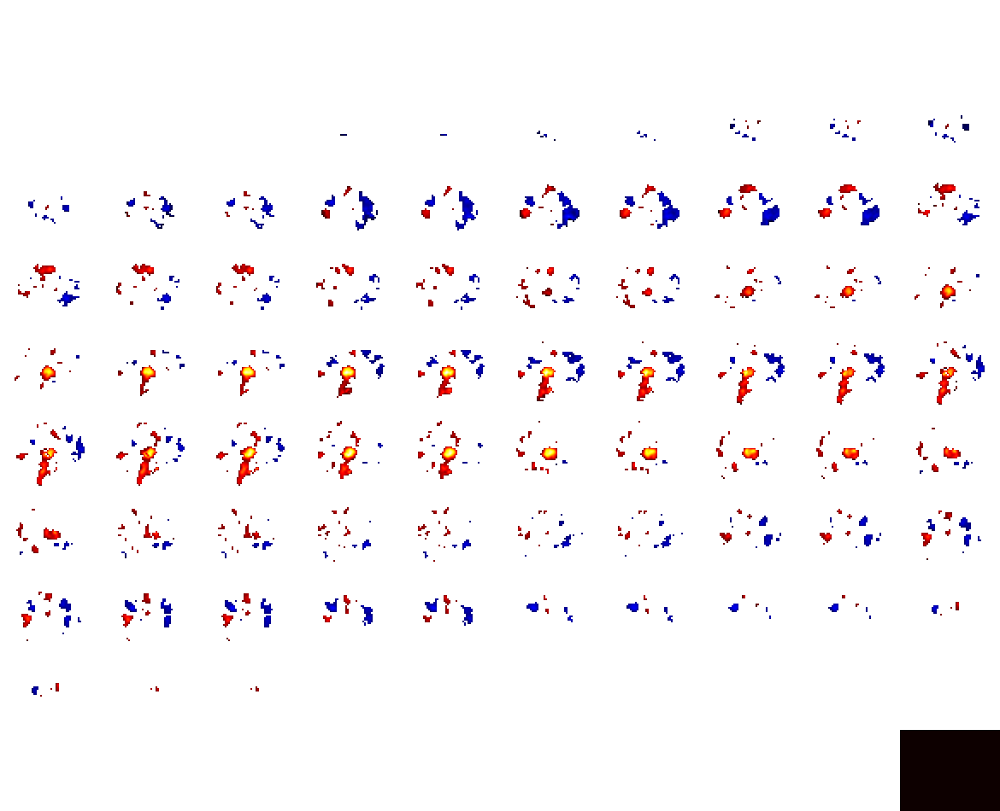

Neuroquery extracted terms
 - memory acquisition
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
memory acquisition,0.800103,0.0,0.814901,16
autism spectrum disorder,0.566539,0.0,0.555178,443
without,0.164313,0.0,0.166476,9055
sleep,0.083136,0.0,0.000000,828
asd,0.052387,0.0,0.000000,317
sleep deprivation,0.020008,0.0,0.000000,154
autism,0.019383,0.0,0.000000,991
deprivation,0.016192,0.0,0.000000,389
spectrum,0.014180,0.0,0.000000,1806
disorder,0.010266,0.0,0.000000,8378


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.349783
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.297779
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.297453
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.281476
4,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.278037
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.278014
6,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.272650
7,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.272417
8,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.267257
9,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.266754



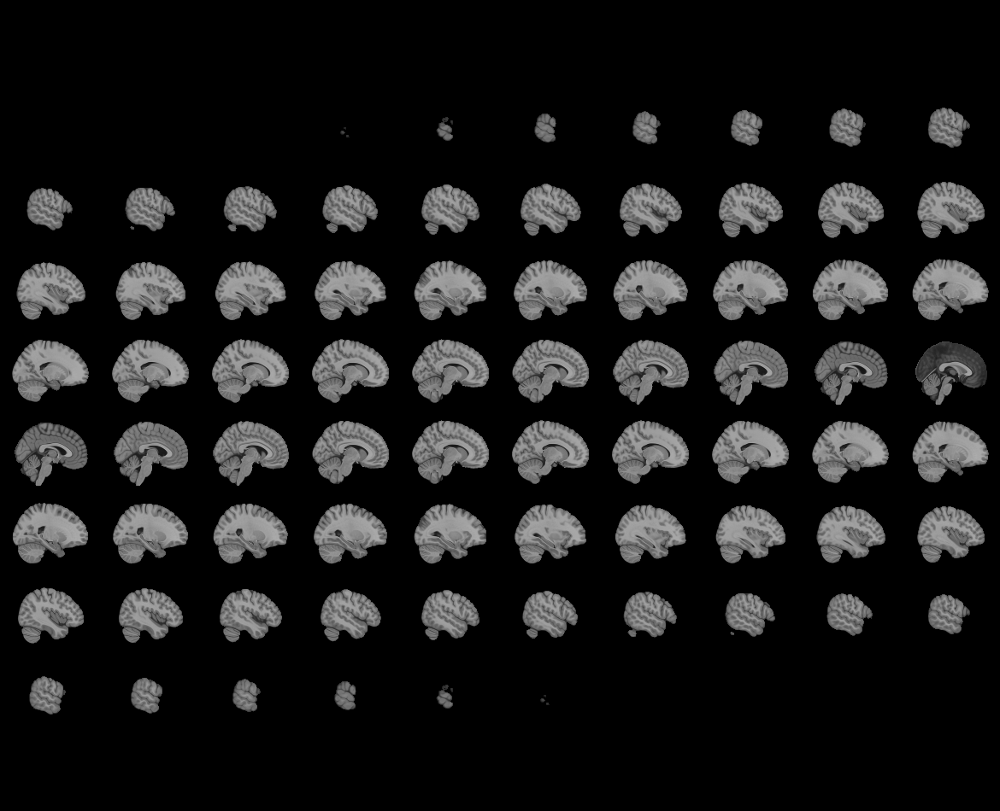
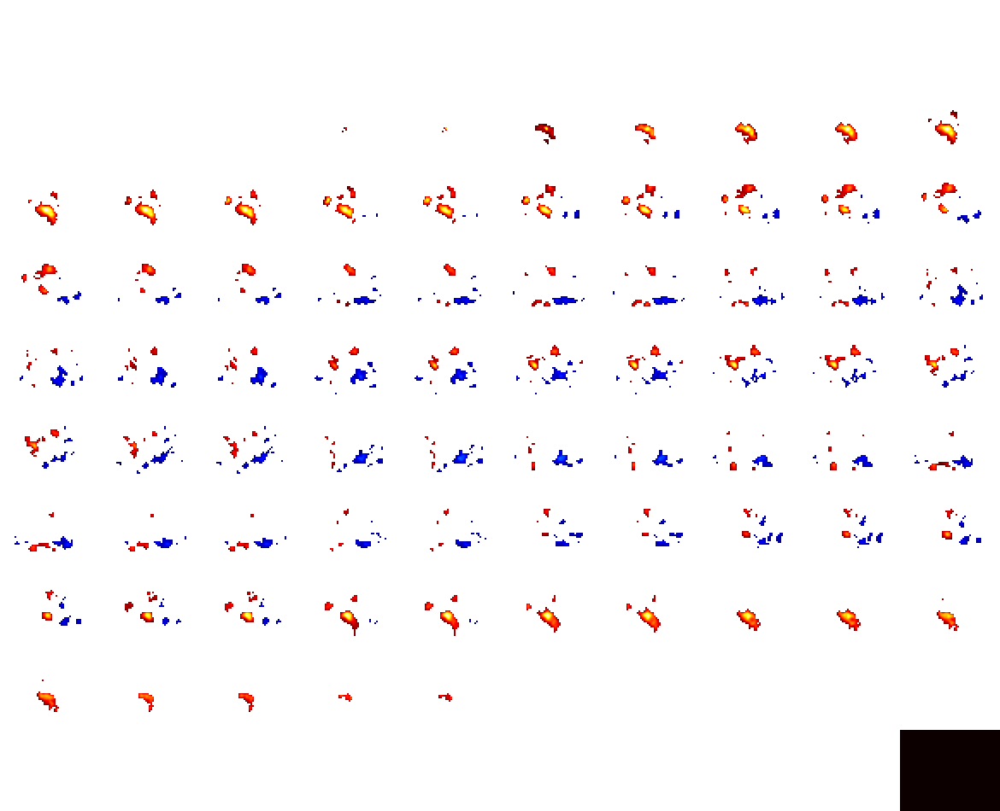

Neuroquery extracted terms
 - complex
 - thought
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.875191,0.000000,0.874020,443
thought,0.385359,0.000000,0.397378,6366
complex,0.272027,0.000000,0.279608,7332
asd,0.078727,0.000000,0.000000,317
autism,0.029404,0.000000,0.000000,991
spectrum,0.021409,0.000000,0.000000,1806
brain,0.015758,0.000000,0.000000,13395
self,0.014903,0.000000,0.000000,6383
disorder,0.014879,0.000000,0.000000,8378
task,0.014561,1.546776,0.000000,12194


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.543615
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.464131
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.459669
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.437529
4,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.428368
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.424601
6,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.423981
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.422565
8,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.417770
9,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.413177



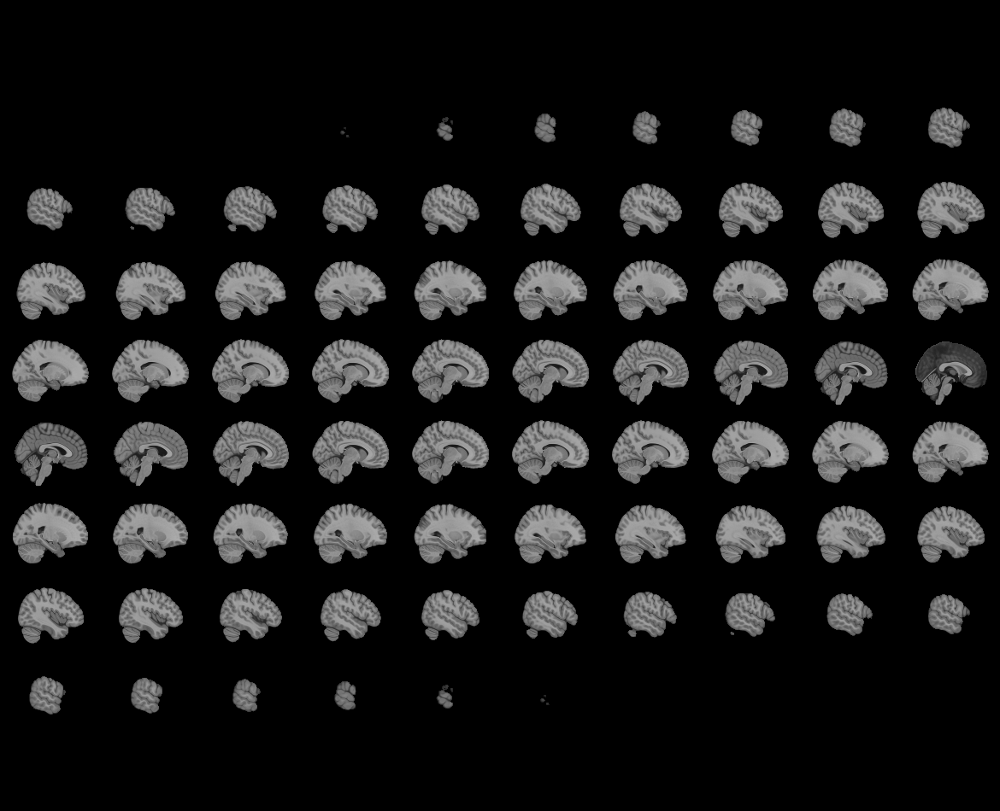
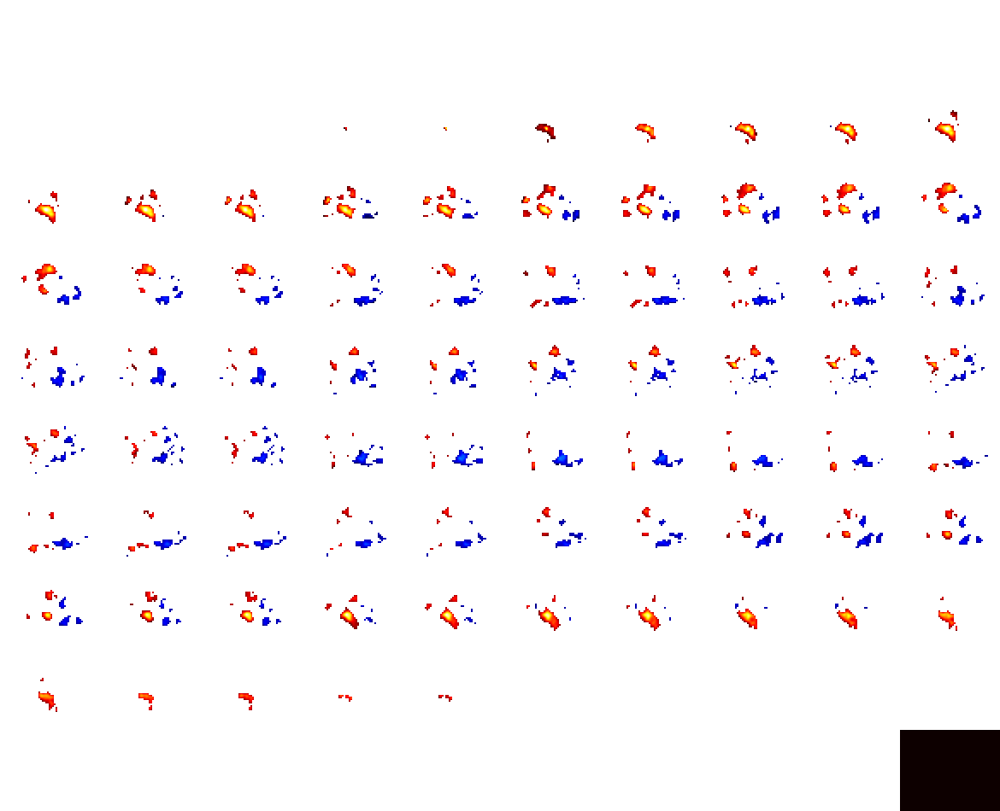

Neuroquery extracted terms
 - complex
 - thought
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.846993,0.000000,0.845465,443
thought,0.372735,0.000000,0.384396,6366
complex,0.263414,0.000000,0.270473,7332
without,0.246108,0.000000,0.253522,9055
asd,0.078348,0.000000,0.000000,317
autism,0.029145,0.000000,0.000000,991
brain,0.022364,0.000000,0.000000,13395
spectrum,0.021400,0.000000,0.000000,1806
disorder,0.017530,0.000000,0.000000,8378
task,0.016283,1.729685,0.000000,12194


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.531026
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.454133
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.448964
3,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.429570
4,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.423001
5,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.419712
6,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.416337
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.415379
8,21896334,Female children with autism spectrum disorder:...,https://www.ncbi.nlm.nih.gov/pubmed/21896334,0.411677
9,21888982,Do distinct atypical cortical networks process...,https://www.ncbi.nlm.nih.gov/pubmed/21888982,0.406161



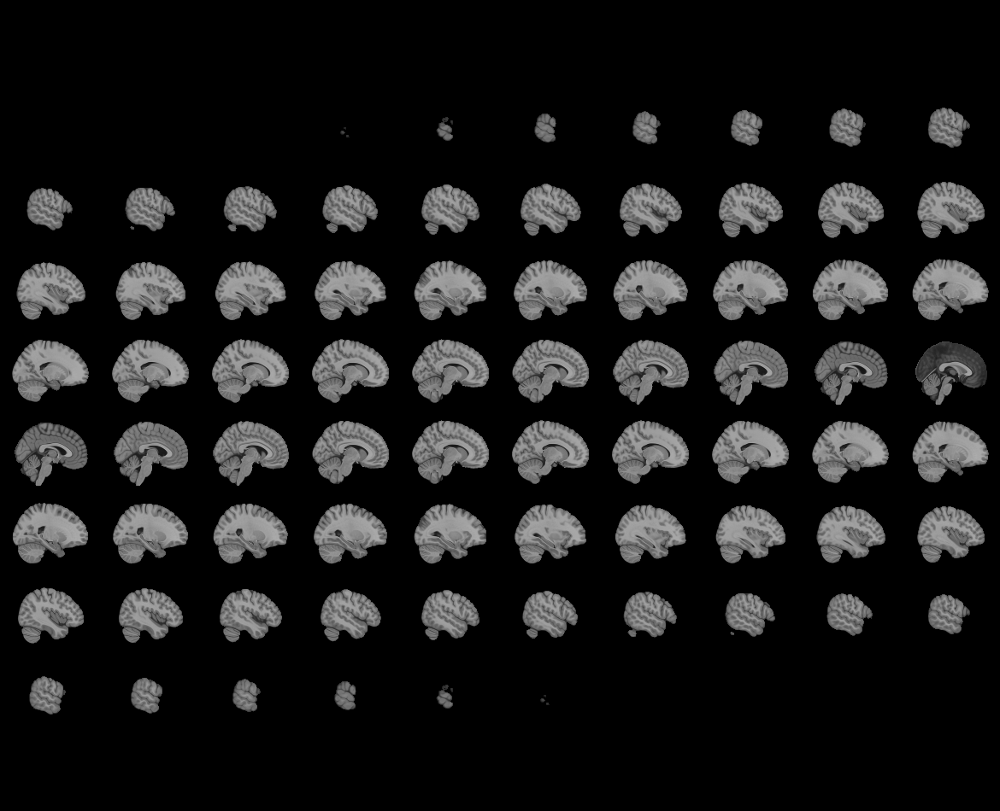
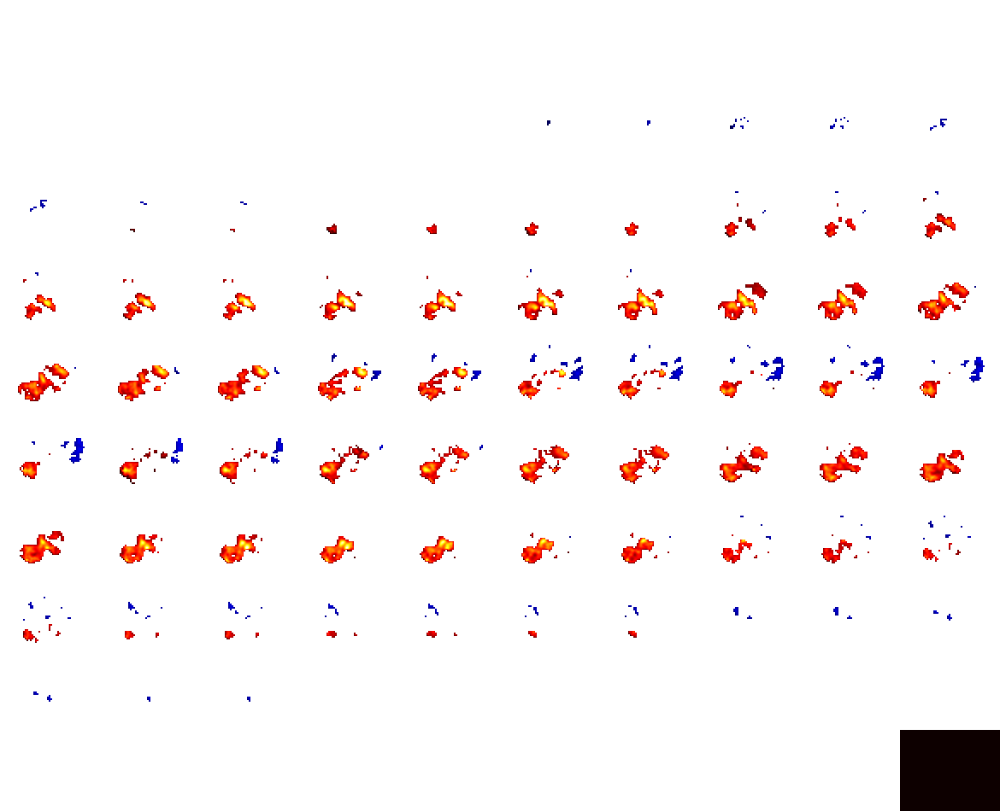

Neuroquery extracted terms
 - procedural memory
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
procedural memory,0.809140,0.000000,0.823617,83
autism spectrum disorder,0.577767,0.000000,0.567146,443
learning,0.077149,0.000000,0.000000,5239
asd,0.051960,0.000000,0.000000,317
memory,0.021694,1.305068,0.000000,8405
autism,0.019299,0.000000,0.000000,991
spectrum,0.013996,0.000000,0.000000,1806
switching,0.013147,0.000000,0.000000,1476
bilinguals,0.012791,0.000000,0.000000,173
caudate,0.009621,1.510930,0.000000,3615


,pmid,title,pubmed_url,similarity
0,24819196,fMRI Evidence for the Involvement of the Proce...,https://www.ncbi.nlm.nih.gov/pubmed/24819196,0.367177
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.353846
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.301375
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.301057
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.284280
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.278801
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.278535
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.275403
8,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.274633
9,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.269372



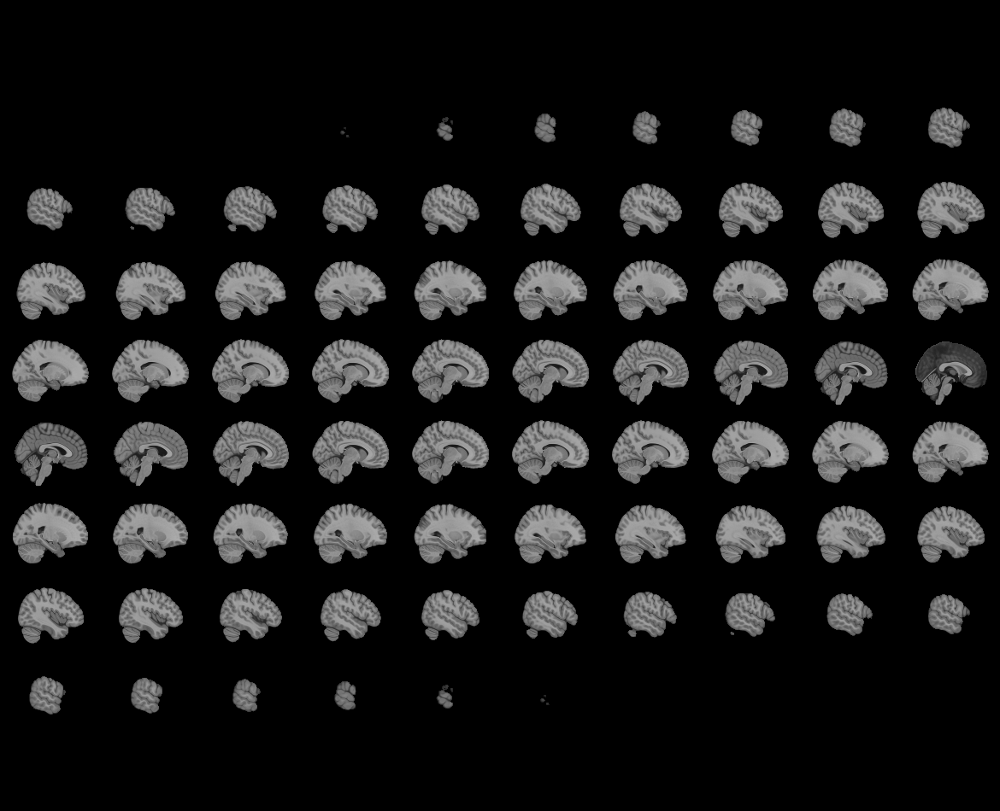
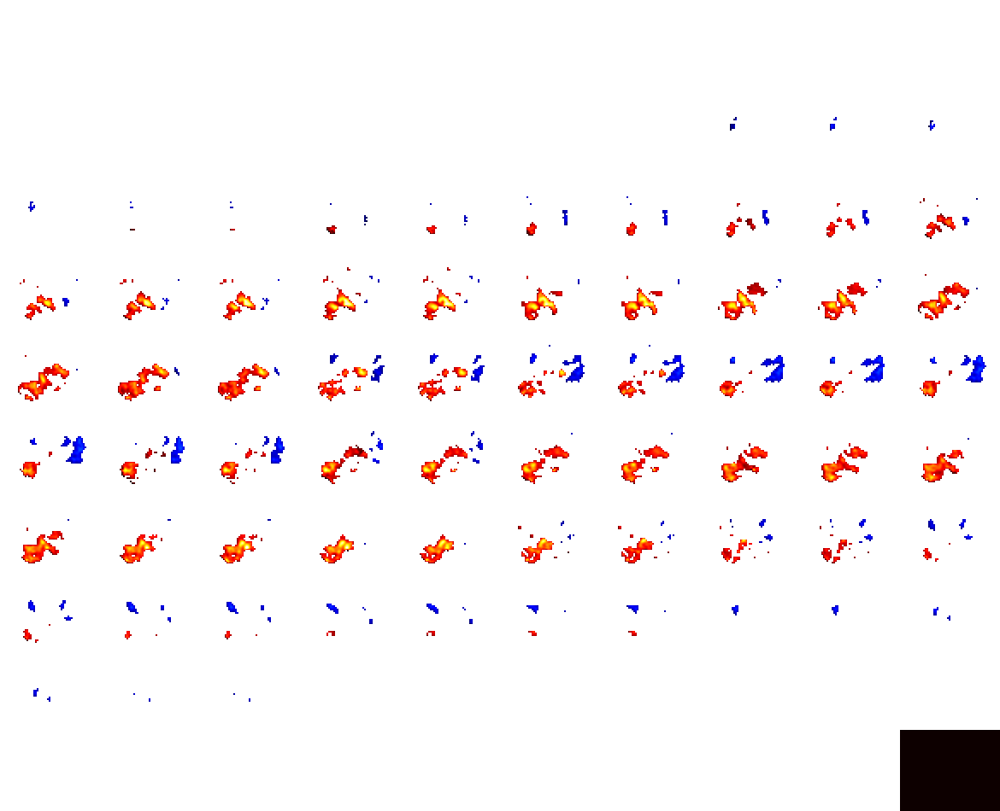

Neuroquery extracted terms
 - procedural memory
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
procedural memory,0.797134,0.000000,0.811959,83
autism spectrum disorder,0.569797,0.000000,0.559119,443
without,0.165638,0.000000,0.167658,9055
learning,0.078676,0.000000,0.000000,5239
asd,0.052695,0.000000,0.000000,317
memory,0.021905,1.317784,0.000000,8405
autism,0.019496,0.000000,0.000000,991
spectrum,0.014261,0.000000,0.000000,1806
switching,0.012961,0.000000,0.000000,1476
bilinguals,0.012603,0.000000,0.000000,173


,pmid,title,pubmed_url,similarity
0,24819196,fMRI Evidence for the Involvement of the Proce...,https://www.ncbi.nlm.nih.gov/pubmed/24819196,0.363537
1,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.352284
2,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.300557
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.299668
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.284493
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.280633
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.280609
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.275932
8,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.274898
9,25610777,Linked alterations in gray and white matter mo...,https://www.ncbi.nlm.nih.gov/pubmed/25610777,0.269578



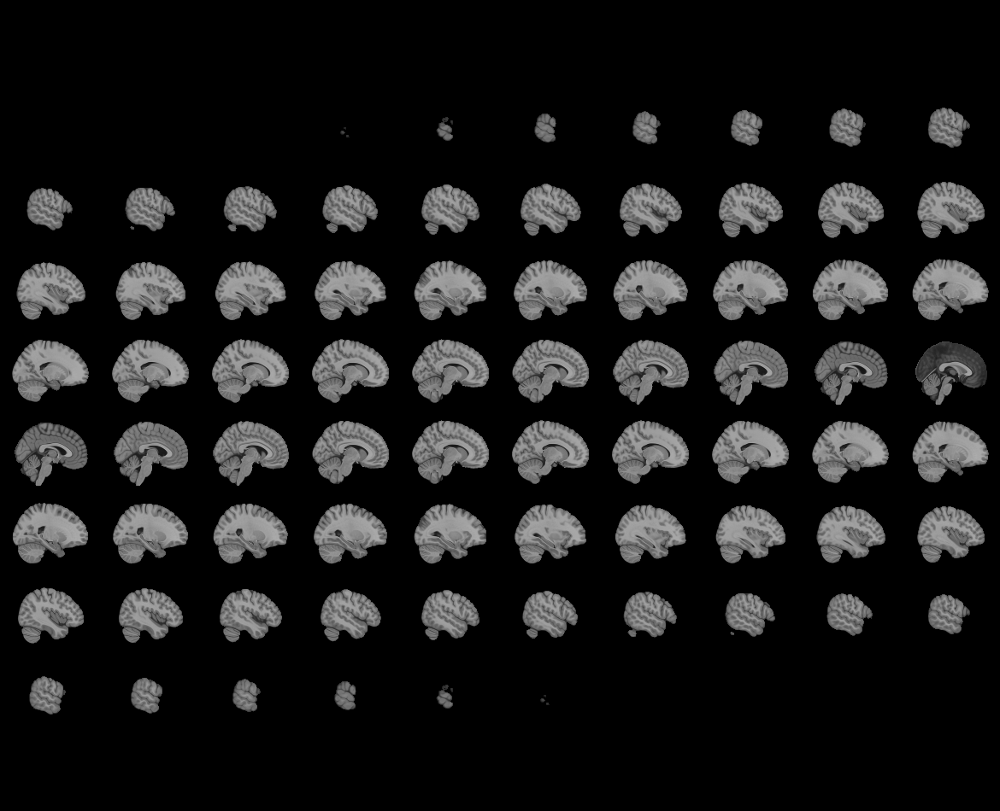
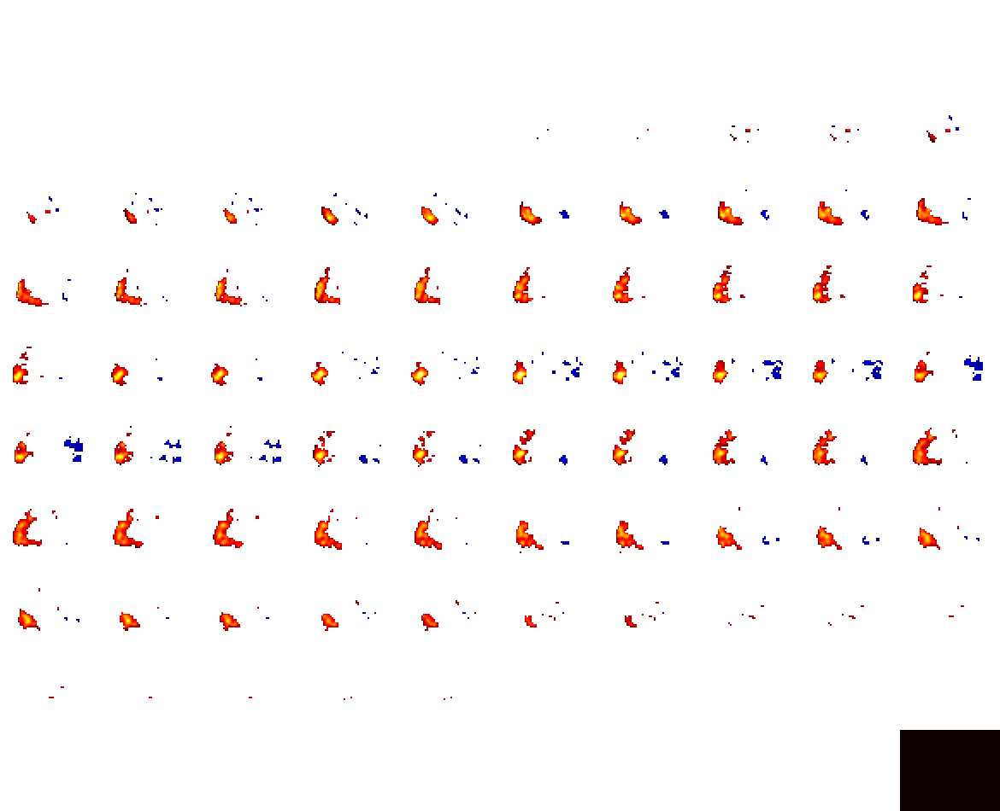

Neuroquery extracted terms
 - sensory memory
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
sensory memory,0.811212,0.000000,0.825692,46
autism spectrum disorder,0.574817,0.000000,0.564121,443
memory,0.067042,4.033166,0.000000,8405
asd,0.051688,0.000000,0.000000,317
pitch,0.030655,2.466480,0.000000,863
visual,0.030081,14.890749,0.000000,10448
stimuli,0.020026,0.000000,0.000000,10529
autism,0.019198,0.000000,0.000000,991
stimulus,0.014793,0.000000,0.000000,9004
spectrum,0.014013,0.000000,0.000000,1806


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.352169
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.301570
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.300638
3,17596966,Localizing pre-attentive auditory memory-based...,https://www.ncbi.nlm.nih.gov/pubmed/17596966,0.289531
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.282619
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.278982
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.277249
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.273754
8,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.273448
9,23715094,"Increased gyrification, but comparable surface...",https://www.ncbi.nlm.nih.gov/pubmed/23715094,0.269685



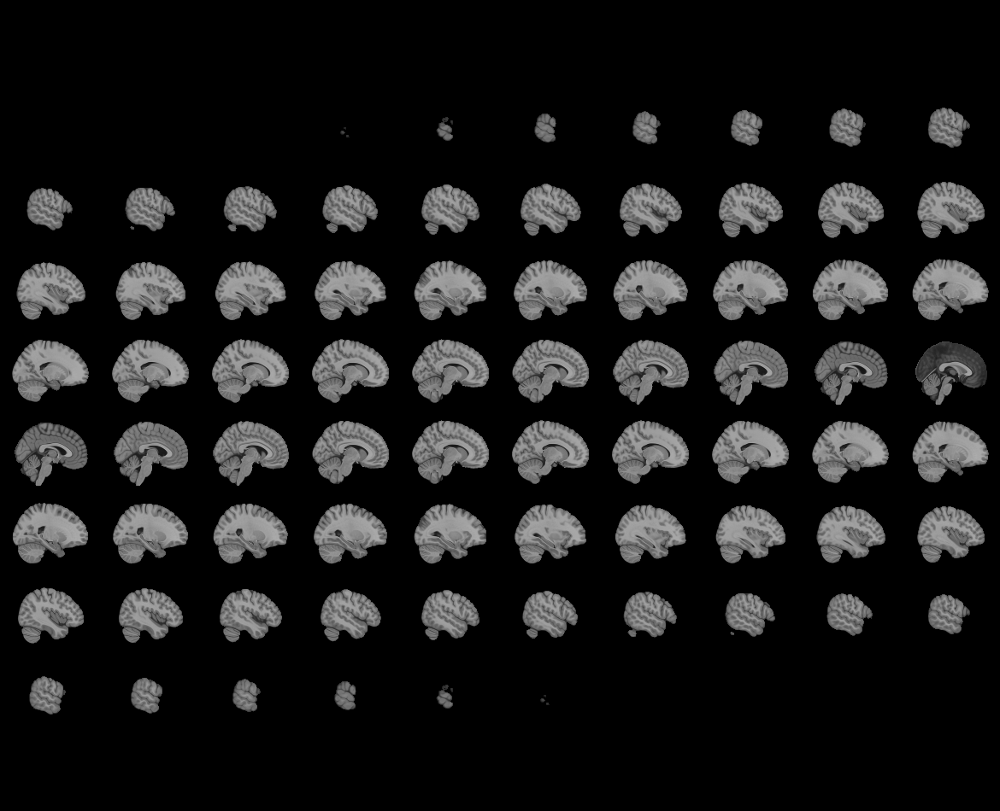
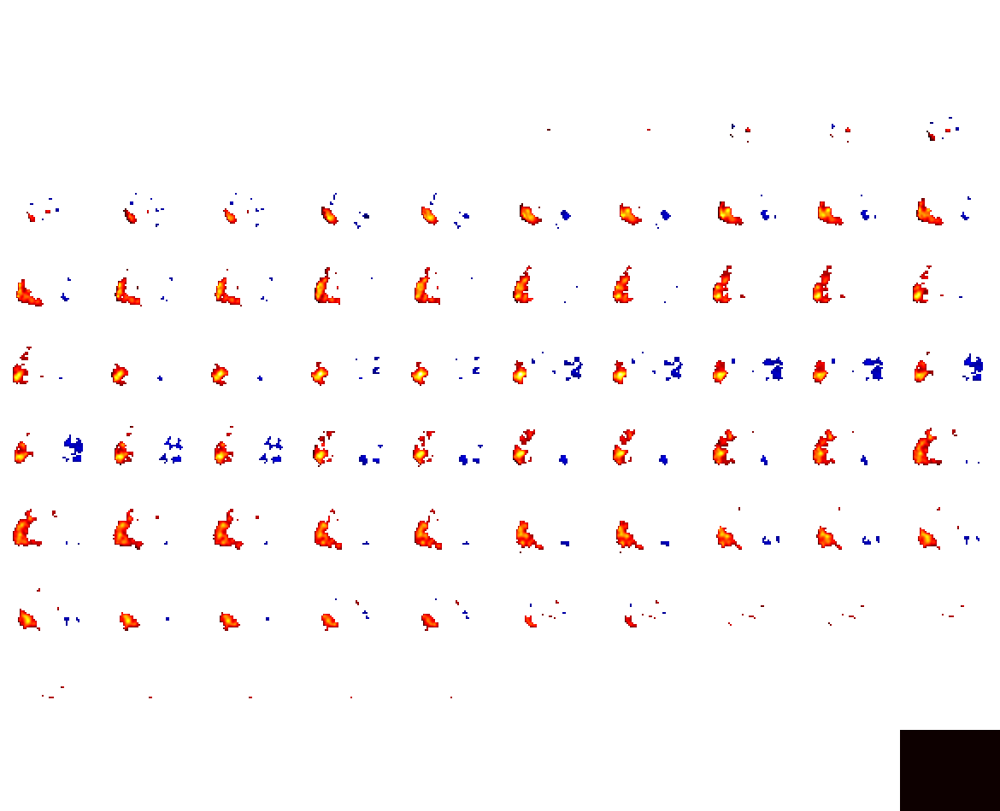

Neuroquery extracted terms
 - sensory memory
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
sensory memory,0.799321,0.000000,0.814127,46
autism spectrum disorder,0.566996,0.000000,0.556219,443
without,0.164838,0.000000,0.166788,9055
memory,0.066590,4.005925,0.000000,8405
asd,0.052429,0.000000,0.000000,317
visual,0.031711,15.697557,0.000000,10448
pitch,0.030588,2.461126,0.000000,863
stimuli,0.021086,0.000000,0.000000,10529
autism,0.019399,0.000000,0.000000,991
stimulus,0.015587,0.000000,0.000000,9004


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.350680
1,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.300788
2,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.299298
3,17596966,Localizing pre-attentive auditory memory-based...,https://www.ncbi.nlm.nih.gov/pubmed/17596966,0.288959
4,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.282888
5,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.280836
6,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.279365
7,21692142,Brain Structure Anomalies in Autism Spectrum D...,https://www.ncbi.nlm.nih.gov/pubmed/21692142,0.274338
8,28377688,Latent and Abnormal Functional Connectivity Ci...,https://www.ncbi.nlm.nih.gov/pubmed/28377688,0.273761
9,21888982,Do distinct atypical cortical networks process...,https://www.ncbi.nlm.nih.gov/pubmed/21888982,0.269854



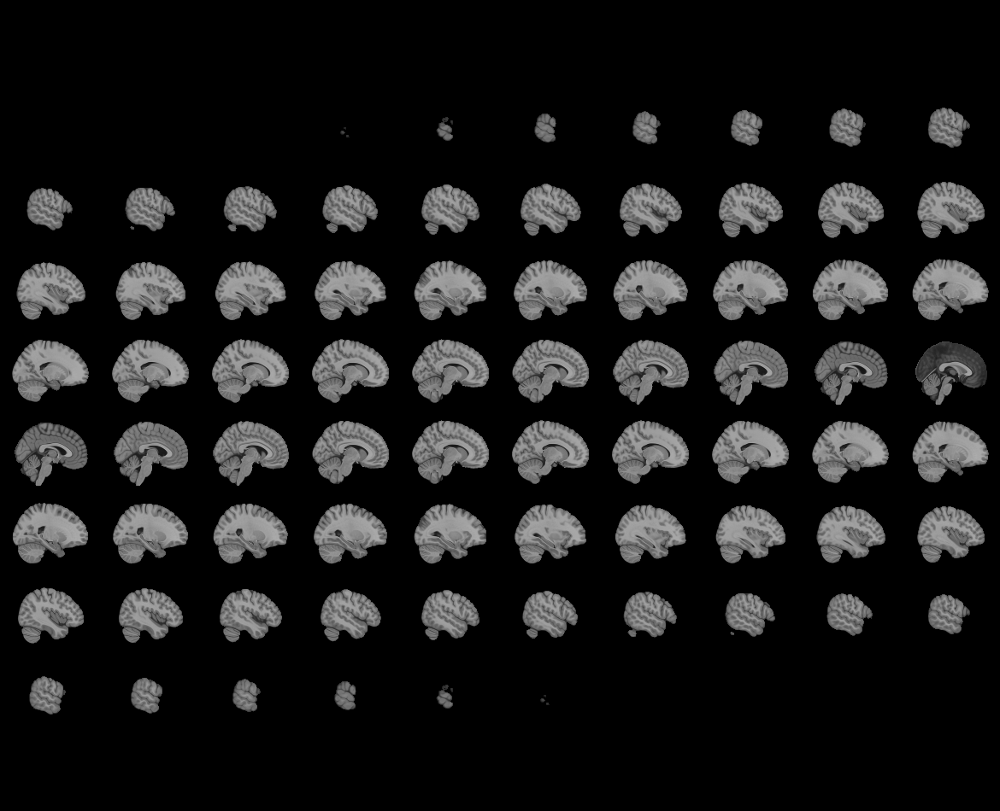
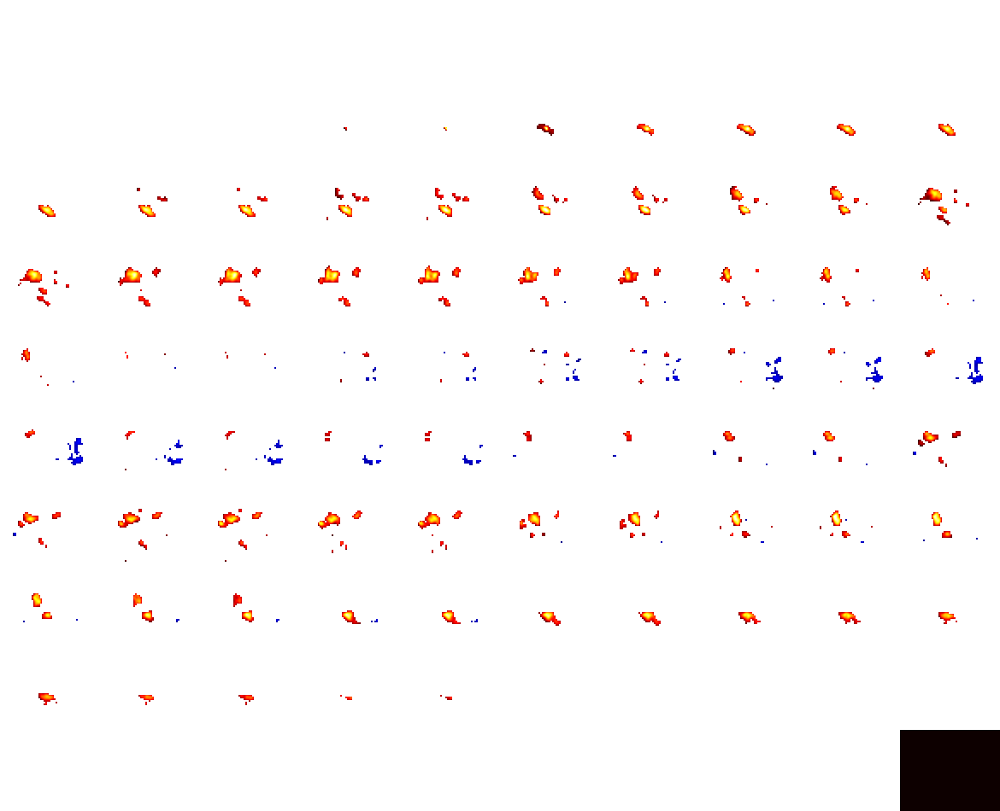

Neuroquery extracted terms
 - short term memory
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.713981,0.000000,0.707657,443
short term memory,0.692283,0.000000,0.706556,611
memory,0.065711,3.953052,0.000000,8405
asd,0.064203,0.000000,0.000000,317
autism,0.023846,0.000000,0.000000,991
spectrum,0.017328,0.000000,0.000000,1806
load,0.013630,0.000000,0.000000,2008
ips,0.013593,1.763844,0.000000,1029
phonological,0.012017,0.000000,0.000000,1479
disorder,0.010264,0.000000,0.000000,8378


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.436729
1,19892765,The left superior temporal gyrus is a shared s...,https://www.ncbi.nlm.nih.gov/pubmed/19892765,0.390113
2,24828642,The Representation of Order Information in Aud...,https://www.ncbi.nlm.nih.gov/pubmed/24828642,0.381566
3,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.371898
4,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.371766
5,21958650,Encoding: The keystone to efficient functionin...,https://www.ncbi.nlm.nih.gov/pubmed/21958650,0.367282
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.349891
7,26967589,Expectations impact short-term memory through ...,https://www.ncbi.nlm.nih.gov/pubmed/26967589,0.346340
8,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.343609
9,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.343514



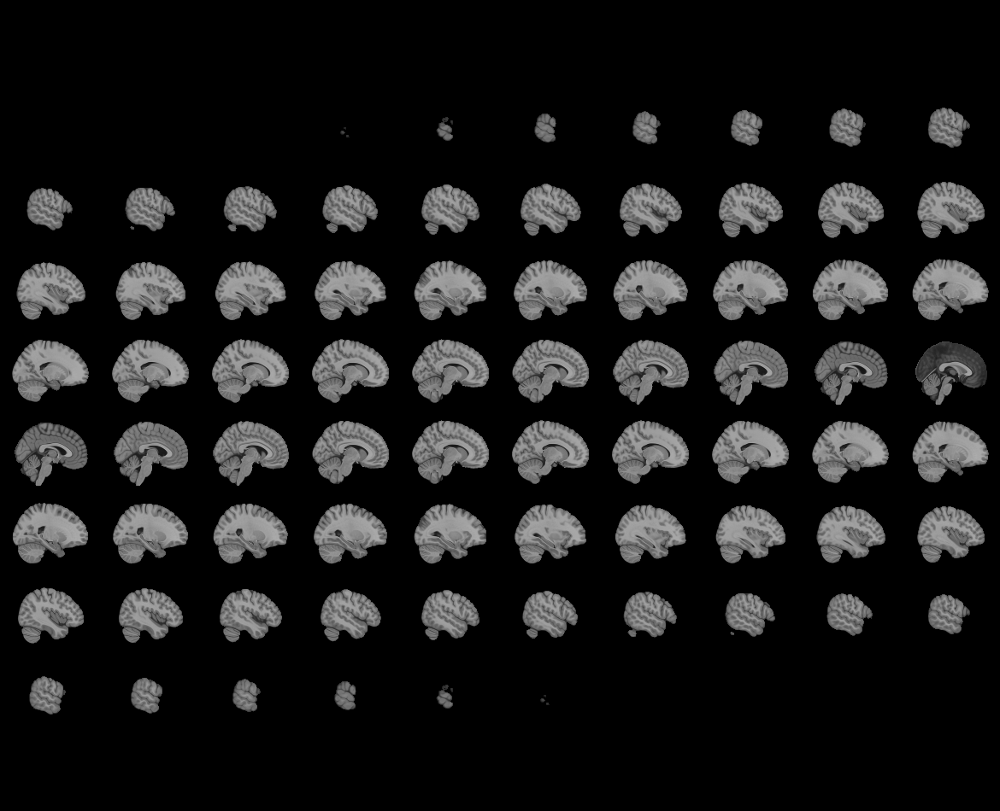
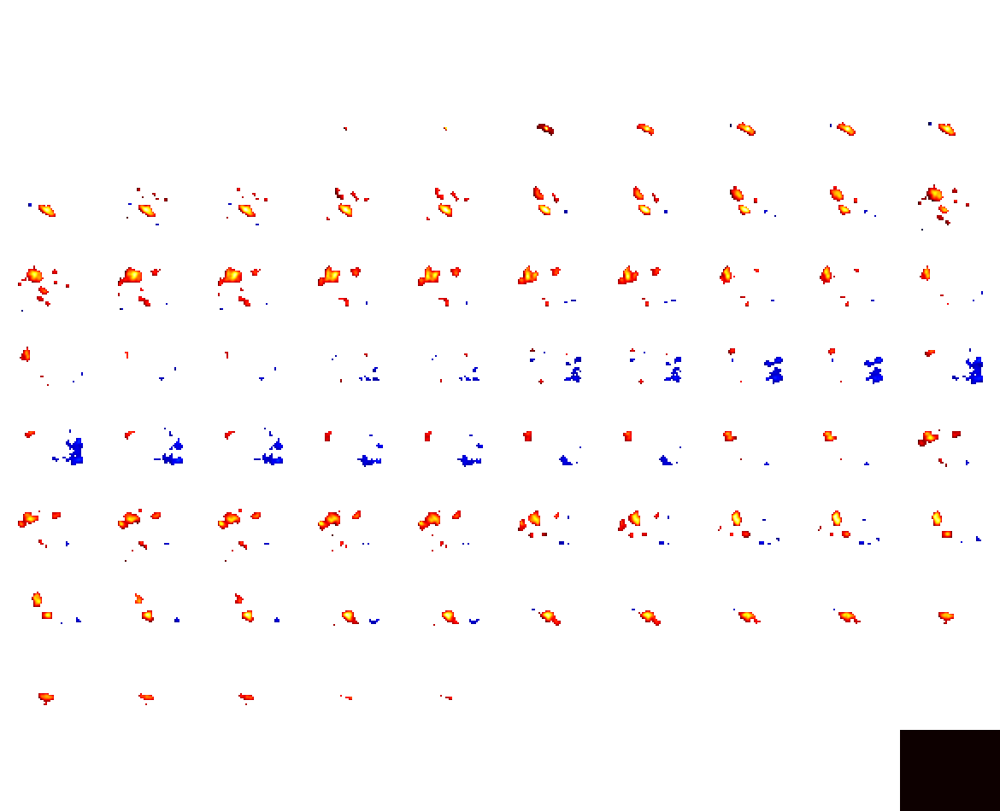

Neuroquery extracted terms
 - short term memory
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
autism spectrum disorder,0.699012,0.000000,0.692244,443
short term memory,0.677081,0.000000,0.691166,611
without,0.202793,0.000000,0.207577,9055
memory,0.064918,3.905365,0.000000,8405
asd,0.064639,0.000000,0.000000,317
autism,0.023915,0.000000,0.000000,991
spectrum,0.017528,0.000000,0.000000,1806
ips,0.013357,1.733177,0.000000,1029
load,0.013343,0.000000,0.000000,2008
phonological,0.012807,0.000000,0.000000,1479


,pmid,title,pubmed_url,similarity
0,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.431644
1,19892765,The left superior temporal gyrus is a shared s...,https://www.ncbi.nlm.nih.gov/pubmed/19892765,0.384513
2,24828642,The Representation of Order Information in Aud...,https://www.ncbi.nlm.nih.gov/pubmed/24828642,0.376136
3,22101112,A systematic review and meta-analysis of the f...,https://www.ncbi.nlm.nih.gov/pubmed/22101112,0.368069
4,20381584,Regional Homogeneity of fMRI Time Series in Au...,https://www.ncbi.nlm.nih.gov/pubmed/20381584,0.367493
5,21958650,Encoding: The keystone to efficient functionin...,https://www.ncbi.nlm.nih.gov/pubmed/21958650,0.362264
6,24419870,Autism Spectrum Disorder as Early Neurodevelop...,https://www.ncbi.nlm.nih.gov/pubmed/24419870,0.347629
7,26967589,Expectations impact short-term memory through ...,https://www.ncbi.nlm.nih.gov/pubmed/26967589,0.345883
8,26788282,The effect of gender on the neuroanatomy of ch...,https://www.ncbi.nlm.nih.gov/pubmed/26788282,0.343572
9,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.343373



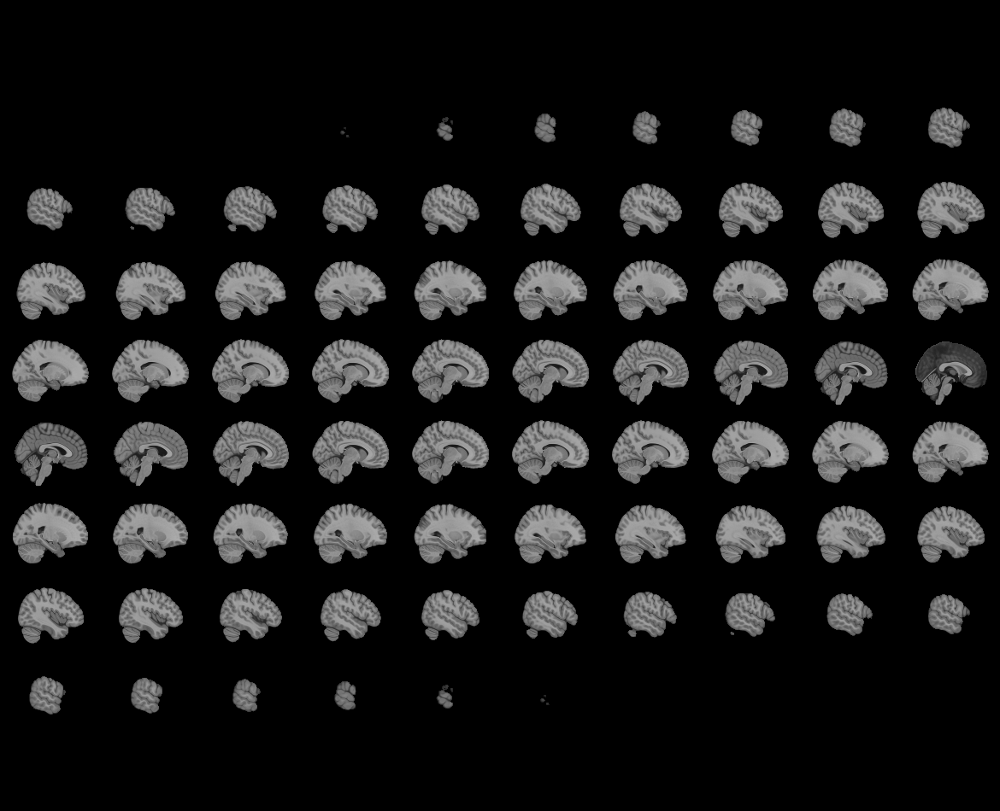
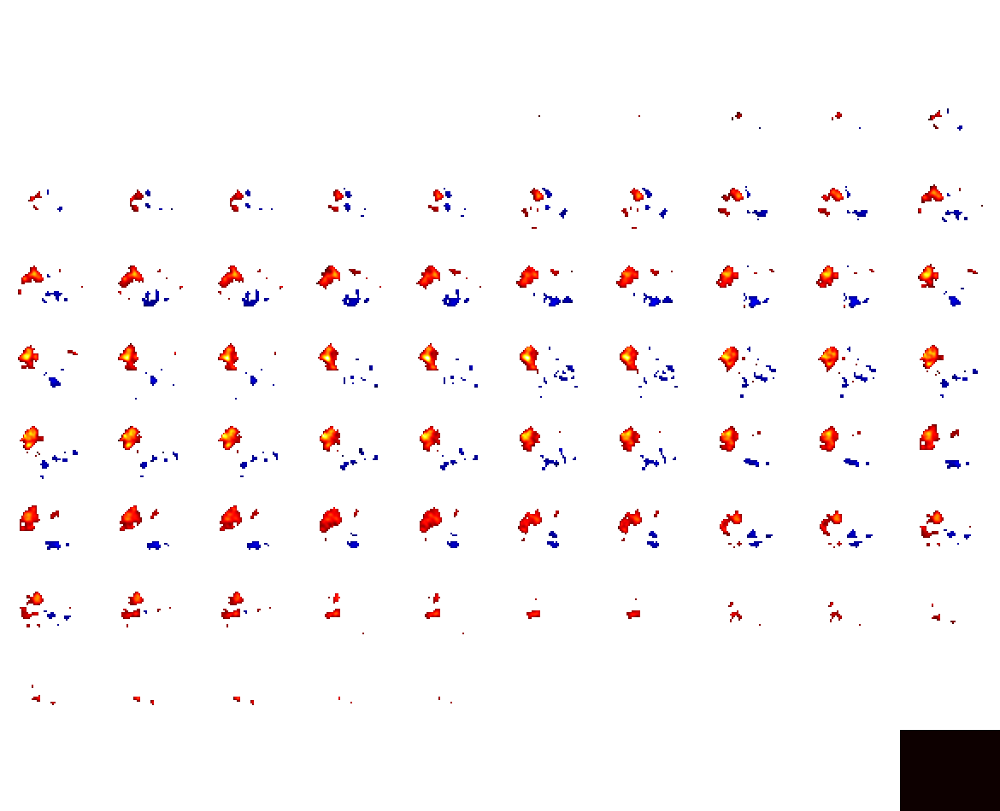

Neuroquery extracted terms
 - theory mind
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
theory mind,0.731658,0.0,0.727253,1006
autism spectrum disorder,0.675200,0.0,0.686369,443
asd,0.061095,0.0,0.000000,317
tom,0.041602,0.0,0.000000,365
mind,0.032058,0.0,0.000000,2839
theory,0.025673,0.0,0.000000,4491
autism,0.023542,0.0,0.000000,991
spectrum,0.016444,0.0,0.000000,1806
belief,0.012564,0.0,0.000000,911
disorder,0.009732,0.0,0.000000,8378


,pmid,title,pubmed_url,similarity
0,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.475072
1,16337813,Do visual perspective tasks need theory of mind?,https://www.ncbi.nlm.nih.gov/pubmed/16337813,0.420749
2,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.415781
3,18633829,Atypical frontal-posterior synchronization of ...,https://www.ncbi.nlm.nih.gov/pubmed/18633829,0.395706
4,24073267,Similar Brain Activation during False Belief T...,https://www.ncbi.nlm.nih.gov/pubmed/24073267,0.391490
5,24844746,Validating the Why/How Contrast for Functional...,https://www.ncbi.nlm.nih.gov/pubmed/24844746,0.387870
6,18559406,Theory of Mind and Schizophrenia: A Positron E...,https://www.ncbi.nlm.nih.gov/pubmed/18559406,0.385799
7,19632299,Individual differences in the theory of mind a...,https://www.ncbi.nlm.nih.gov/pubmed/19632299,0.377747
8,26512314,Aberrant functioning of the theory-of-mind net...,https://www.ncbi.nlm.nih.gov/pubmed/26512314,0.372969
9,16753205,Cultural and linguistic influence on neural ba...,https://www.ncbi.nlm.nih.gov/pubmed/16753205,0.365110



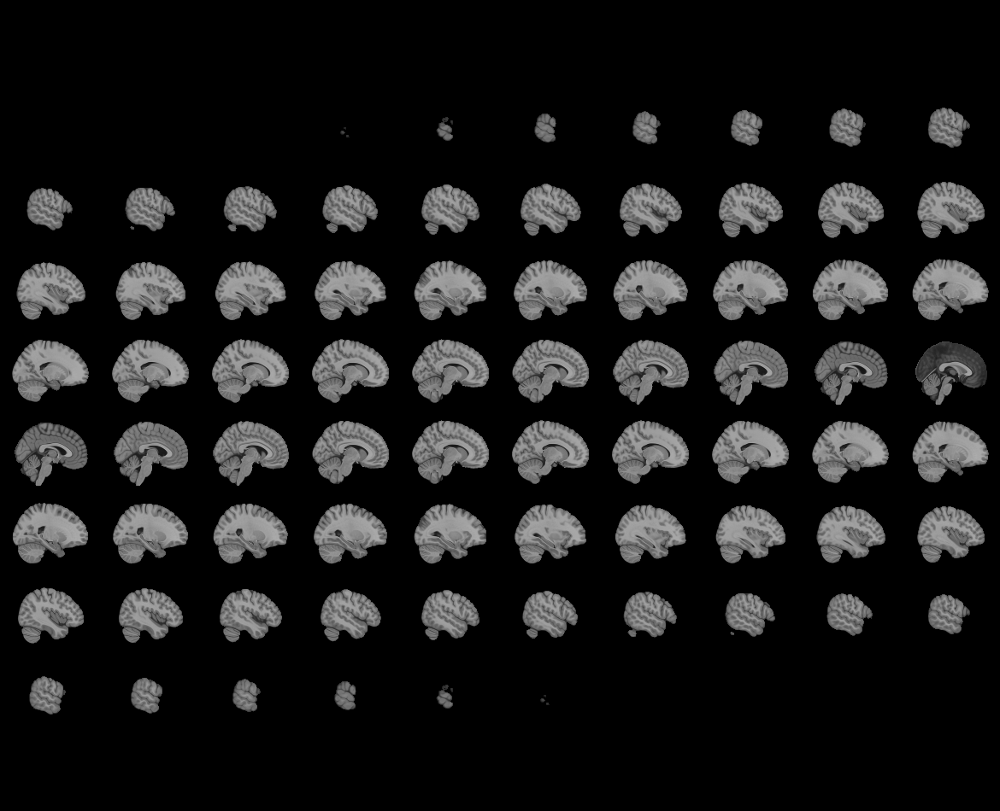
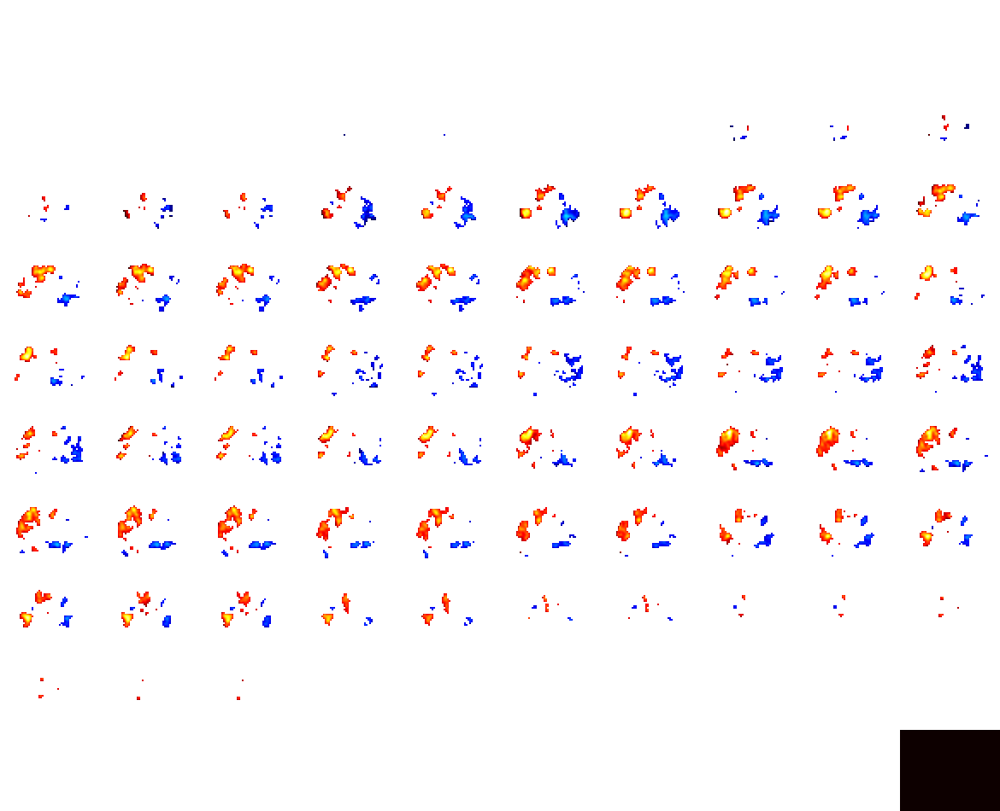

Neuroquery extracted terms
 - theory mind
 - without
 - autism spectrum disorder


,similarity,weight_in_brain_map,weight_in_query,n_documents
theory mind,0.717501,0.0,0.712323,1006
autism spectrum disorder,0.662390,0.0,0.672278,443
without,0.192225,0.0,0.201590,9055
asd,0.061623,0.0,0.000000,317
tom,0.041267,0.0,0.000000,365
mind,0.031836,0.0,0.000000,2839
theory,0.025615,0.0,0.000000,4491
autism,0.023633,0.0,0.000000,991
spectrum,0.016665,0.0,0.000000,1806
belief,0.012554,0.0,0.000000,911


,pmid,title,pubmed_url,similarity
0,26329119,Reduced cortical thickness and its association...,https://www.ncbi.nlm.nih.gov/pubmed/26329119,0.472500
1,16337813,Do visual perspective tasks need theory of mind?,https://www.ncbi.nlm.nih.gov/pubmed/16337813,0.417368
2,22791801,Fractionation of social brain circuits in auti...,https://www.ncbi.nlm.nih.gov/pubmed/22791801,0.411748
3,24073267,Similar Brain Activation during False Belief T...,https://www.ncbi.nlm.nih.gov/pubmed/24073267,0.409354
4,18633829,Atypical frontal-posterior synchronization of ...,https://www.ncbi.nlm.nih.gov/pubmed/18633829,0.390519
5,24844746,Validating the Why/How Contrast for Functional...,https://www.ncbi.nlm.nih.gov/pubmed/24844746,0.383150
6,18559406,Theory of Mind and Schizophrenia: A Positron E...,https://www.ncbi.nlm.nih.gov/pubmed/18559406,0.383014
7,19632299,Individual differences in the theory of mind a...,https://www.ncbi.nlm.nih.gov/pubmed/19632299,0.372783
8,21559448,First-Person Perspective Effects on Theory of ...,https://www.ncbi.nlm.nih.gov/pubmed/21559448,0.369859
9,26512314,Aberrant functioning of the theory-of-mind net...,https://www.ncbi.nlm.nih.gov/pubmed/26512314,0.369254


In [26]:
def resample_nifti1_image(img, scale=1/4):
    target_affine = img.affine.copy()
    target_affine[:3, 3] *= scale
    target_affine[:3, -1] /= scale
    return nl.image.resample_img(img, target_affine=target_affine)

for query in queries:
    display(HTML(f"<h3>{query.text}</h3>"))
    results = {}
    for term in ['with', 'without']:
        full_query = f"{query.text} {term} Autism Spectrum Disorder"
        result = model(full_query.lower())
        results[term] = result
        
        # Visual 
        display(HTML(f"<h4>{term}</h4>"))
        view = nl.plotting.view_img(
            result['brain_map'], 
            threshold=3, 
            # surf_mesh='fsaverage', 
            cut=query.default_cut,
            title=term
        )
        display(view)

        print("Neuroquery extracted terms")
        tree = etree.fromstring(result['highlighted_text'])
        for item in tree.xpath('extracted_phrase'):
            print(' -', item.attrib['standardized_form'])

        # Related Terms
        display(result['similar_words'].sort_values('similarity', ascending=False).head(10))

        # Related Studies
        display(result['similar_documents'].head(10))
